# Task 1: Feed-forward neural networks


---

Tutorial: "Machine Learning in Solid Mechanics @ Cyber-Physical Simulation, TU Darmstadt

Lecturer: Prof. Oliver Weeger

Assistants: Dominik K. Klein, Jasper O. Schommartz

Group members: Alexander Pahl (2405797), Lukas Fromme (?)

---





In [ ]:
# run only once to install the plotting widget
!uv pip install ipympl

In [1]:
# run every time you restart the kernel to activate the plotting widget
%matplotlib widget

In [2]:
import datetime
import importlib
import jax
import jax.random as jrandom
import jax.nn as jnn
import jax.numpy as jnp
import src.tmlsm.losses as tl
import src.tmlsm.data as td
import src.tmlsm.models as tm
importlib.reload(tm)
importlib.reload(tl)
importlib.reload(td)
now = datetime.datetime.now

### Example for using our parametriced model class

Below are some examples of how to use our parametrized model class. These are not part of the tasks and may be ignored for examination.

*Example: Building a model with the same activation function in each hidden layer*

In [ ]:
key = jrandom.PRNGKey(42)

# Simple Case: Build a model with softplus on all hidden layers
model = tm.build(
    key=key,
    input_dim="scalar", # Note: For Scalar input dimensions dont use the int 1, but the string "scalar" --> otherwise dimension error of array will occur
    output_dim="scalar", # Note: For Scalar output dimensions similarly use the string "scalar" --> will not lead to errors if 1 is used but arrays may have unexpected shapes
    num_hidden_layers=2,
    nodes_per_layer=16,
    activations=jax.nn.softplus  # Just one function!
)
print(model)

Model(
  layers=(
    Linear(
      weight=f32[1,16],
      bias=f32[16],
      in_features='scalar',
      out_features=16,
      use_bias=True
    ),
    Linear(
      weight=f32[16,16],
      bias=f32[16],
      in_features=16,
      out_features=16,
      use_bias=True
    ),
    Linear(
      weight=f32[16,1],
      bias=f32[1],
      in_features=16,
      out_features='scalar',
      use_bias=True
    )
  ),
  activations=(
    <PjitFunction of <function softplus at 0x000001D9FB717420>>,
    <PjitFunction of <function softplus at 0x000001D9FB717420>>,
    <function build.<locals>.<lambda>>
  )
)


*Example: Building a model with specified activation functions for each layer*

In [ ]:
key = jrandom.PRNGKey(42)

# Flexible Case: Build a model with a custom stack of activations
custom_activations = [
    jnn.relu,        # Activation for hidden layer 1
    jnn.softplus,    # Activation for hidden layer 2
    jnn.tanh         # Custom activation for the OUTPUT layer
]

model_custom = tm.build(
    key=key,
    input_dim="scalar", # Note: For Scalar input dimensions dont use the int 1, but the string "scalar" --> otherwise dimension error of array will occur
    output_dim="scalar",
    num_hidden_layers=2,
    nodes_per_layer=16,
    activations=custom_activations # A full list!
)
print(model_custom)

Model(
  layers=(
    Linear(
      weight=f32[1,16],
      bias=f32[16],
      in_features='scalar',
      out_features=16,
      use_bias=True
    ),
    Linear(
      weight=f32[16,16],
      bias=f32[16],
      in_features=16,
      out_features=16,
      use_bias=True
    ),
    Linear(
      weight=f32[16,1],
      bias=f32[1],
      in_features=16,
      out_features='scalar',
      use_bias=True
    )
  ),
  activations=(
    <PjitFunction of <function relu at 0x000001D9FB716F20>>,
    <PjitFunction of <function softplus at 0x000001D9FB717420>>,
    <PjitFunction of <function tanh at 0x000001D9FB479440>>
  )
)


## Task 1

### General Information on Methodology

**Randomness:**

The training of NNs inherently involves some components of randomness. Namely, for a complex highly non-convex loss landscape, stochastic components like parameter initialization and data shuffling are done randomly and can have an effect on the point of convergence (post training parameter configuration). This does not become obvious in the typical way NNs are plotted and visualized where often only the final learned function and predictions are visualized. To address this in a qualitative way, throughout this task we will always train an ensemble of models for each architecture where we use different random keys to initialize their parameters. To reflect this in our visualization, we then compute the mean for each ensemble to indicate the overall "consensus" of this architecture class (analogue to standard plotting of NN function). Furthermore, we attempt to give a notion of the "uncertainty" of the ensemble by plotting twice the standard deviation of the ensemble as a shaded area above and below the mean.



### Task 1.1 Hyperparameter Sweep

We will approach this task with the goal of understanding the impact of each hyperparameter. Therefore, we will hold all parameters fixed and only vary one class of hyperparameters at a time to investigate their isolated impact on the neural network.

#### Section 1: Number of hidden layers and nodes
First we will construct a set of NNs for each hidden layer configuration [1,2,3] where for each of them we will vary the number of nodes [4, 8, 16].

In [3]:
# construct global master key with constant argument to enable reproducability
master_key = jrandom.PRNGKey(0)
# load data of 1D bathtub function
x, y, x_cal, y_cal = td.bathtub()

--- Processing architecture: 1 layers, 4 nodes ---


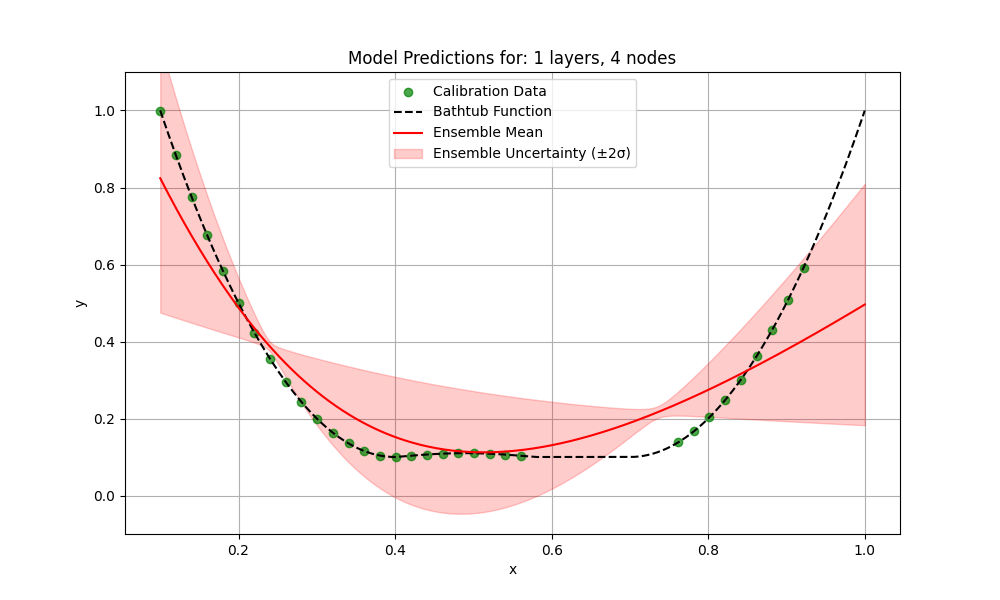

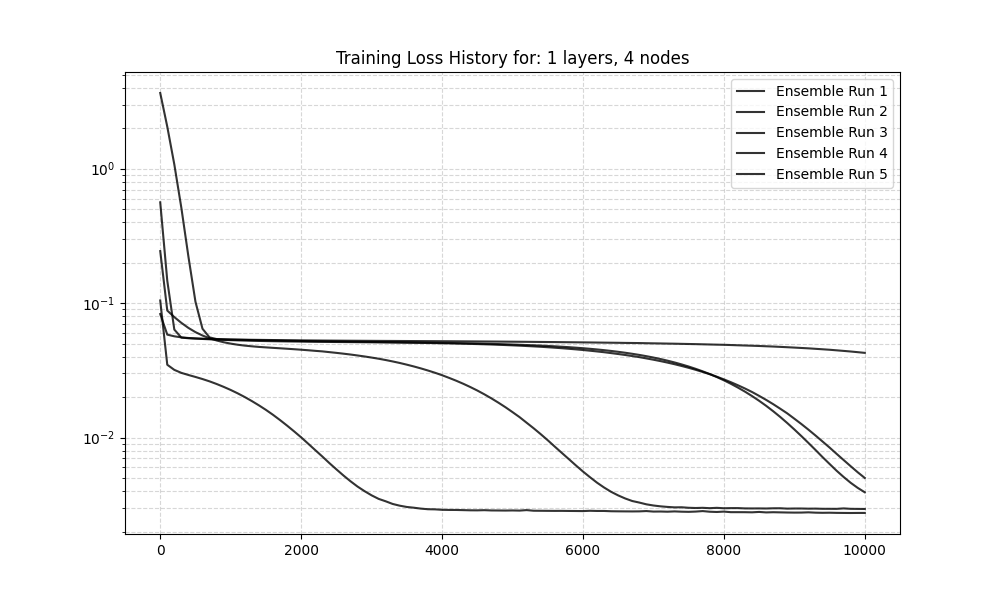

  Avg Final Loss: 0.011465
  Std Dev of Loss: 0.015633

--- Processing architecture: 1 layers, 8 nodes ---


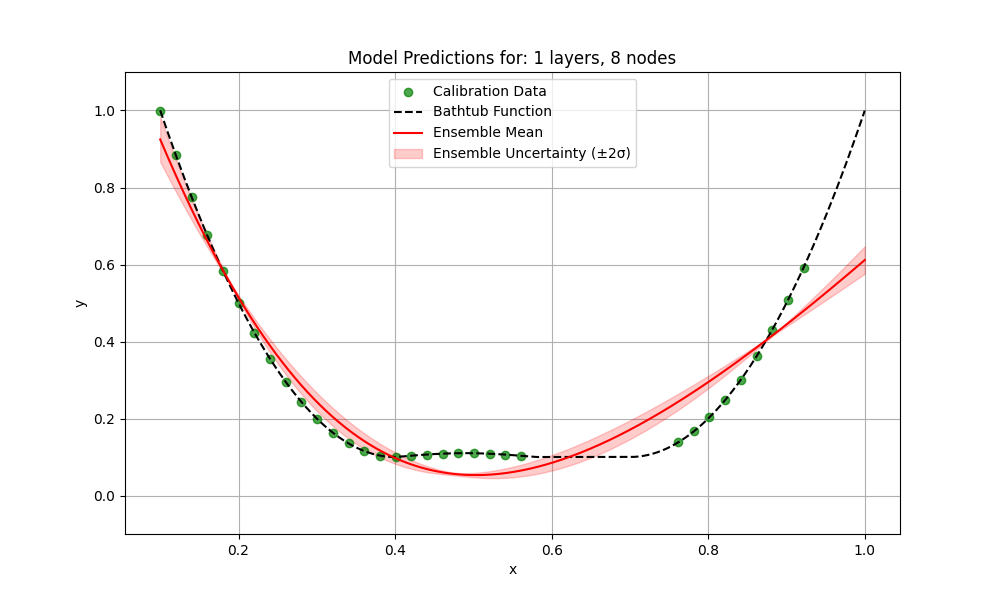

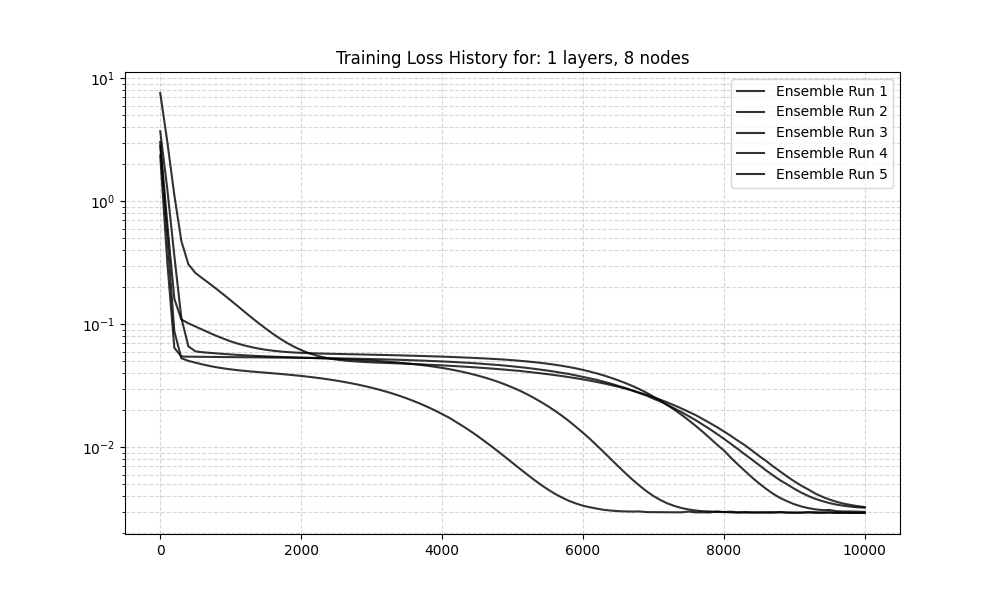

  Avg Final Loss: 0.003063
  Std Dev of Loss: 0.000148

--- Processing architecture: 1 layers, 16 nodes ---


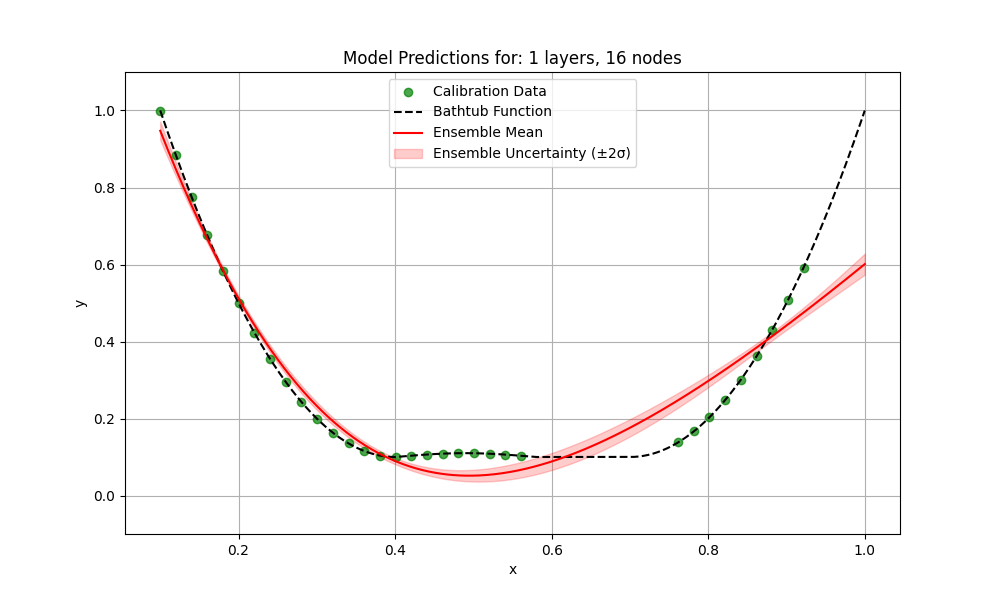

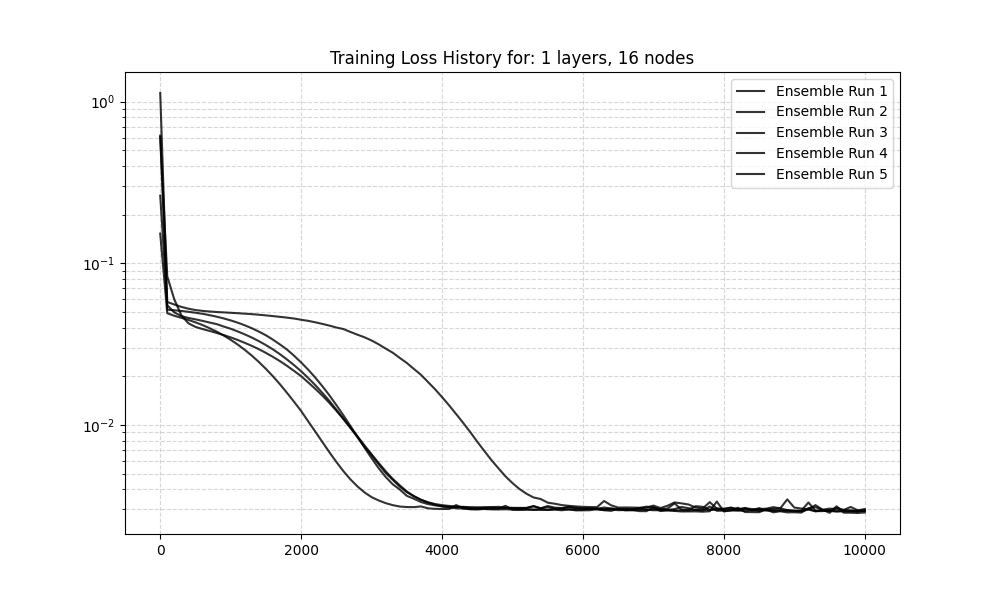

  Avg Final Loss: 0.002945
  Std Dev of Loss: 0.000049

--- Processing architecture: 2 layers, 4 nodes ---


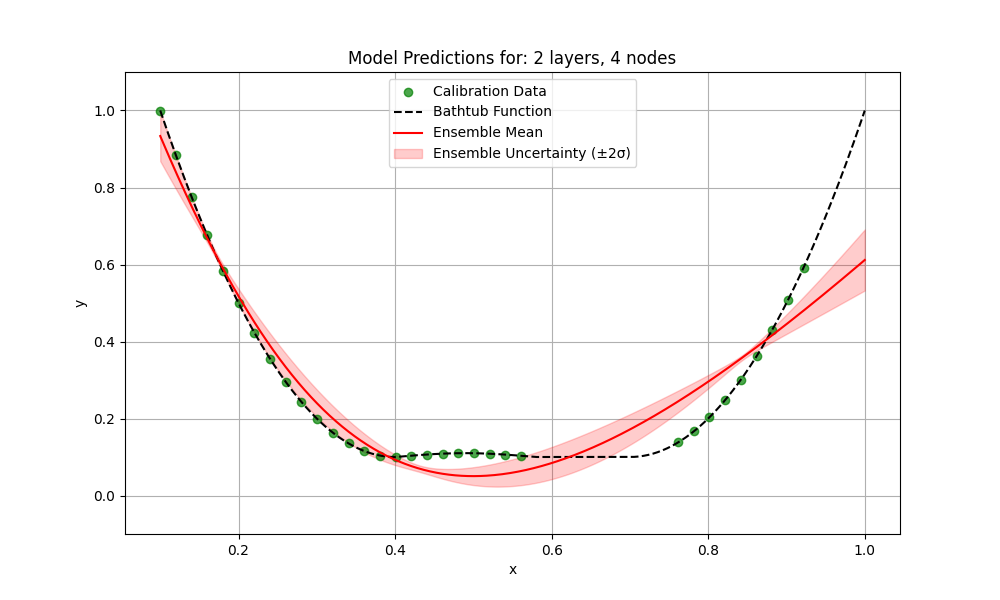

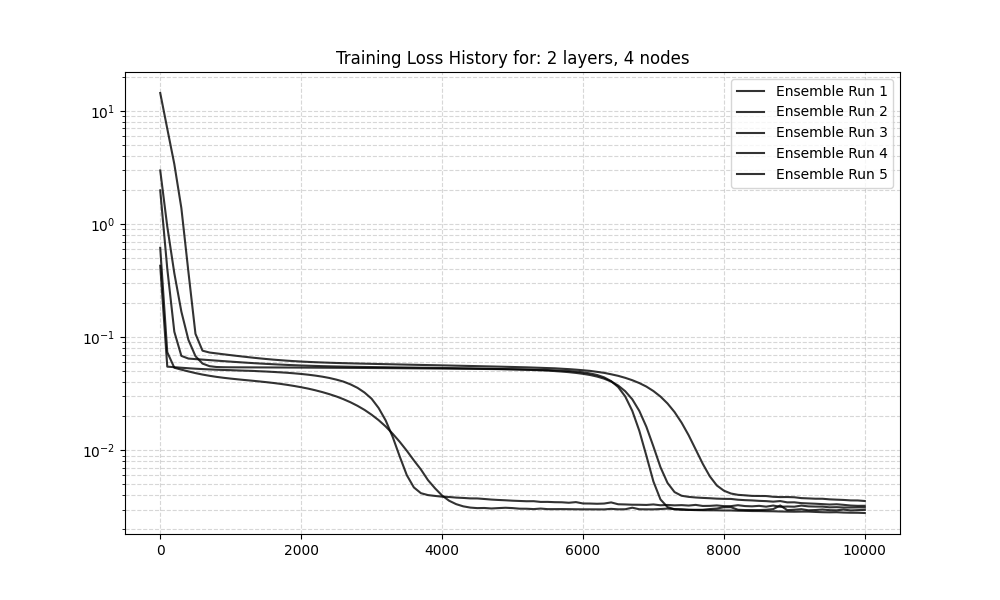

  Avg Final Loss: 0.003142
  Std Dev of Loss: 0.000260

--- Processing architecture: 2 layers, 8 nodes ---


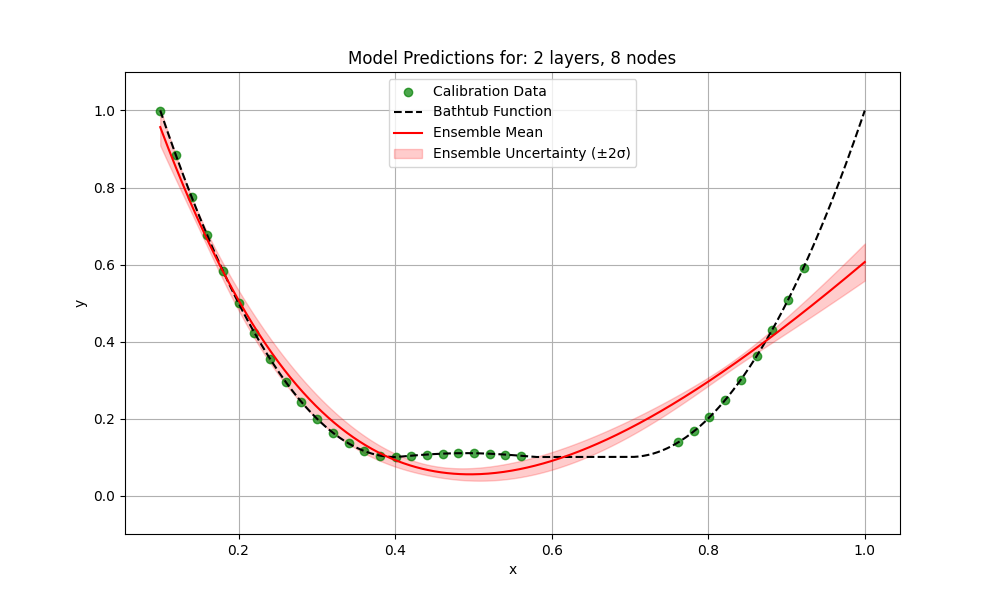

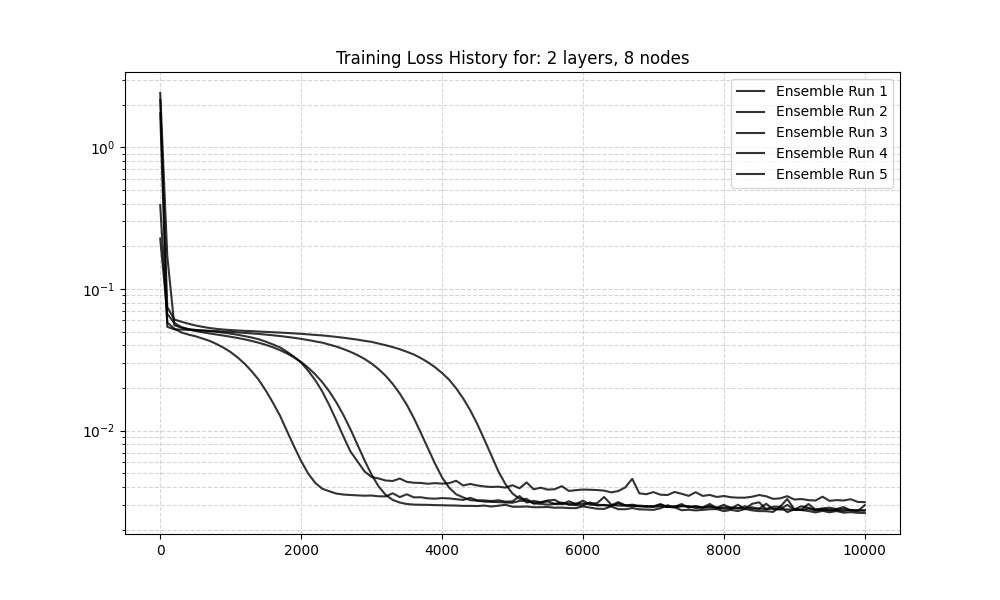

  Avg Final Loss: 0.002839
  Std Dev of Loss: 0.000185

--- Processing architecture: 2 layers, 16 nodes ---


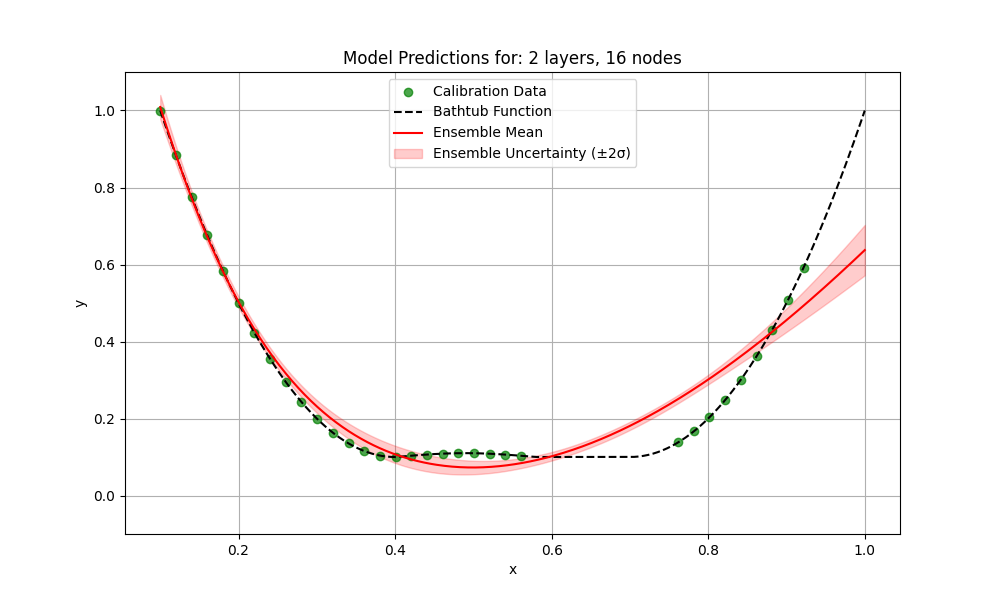

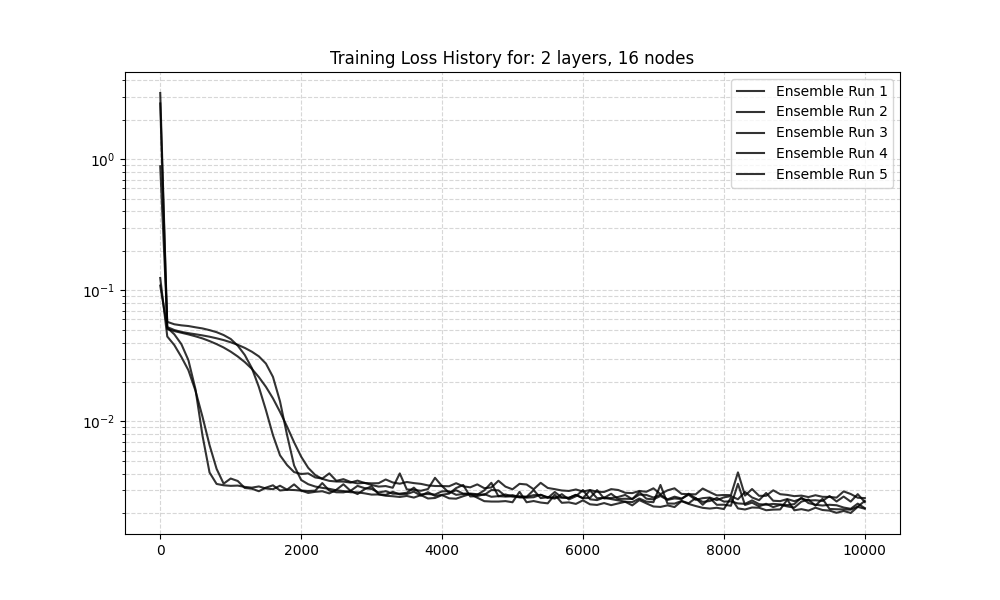

  Avg Final Loss: 0.002370
  Std Dev of Loss: 0.000172

--- Processing architecture: 3 layers, 4 nodes ---


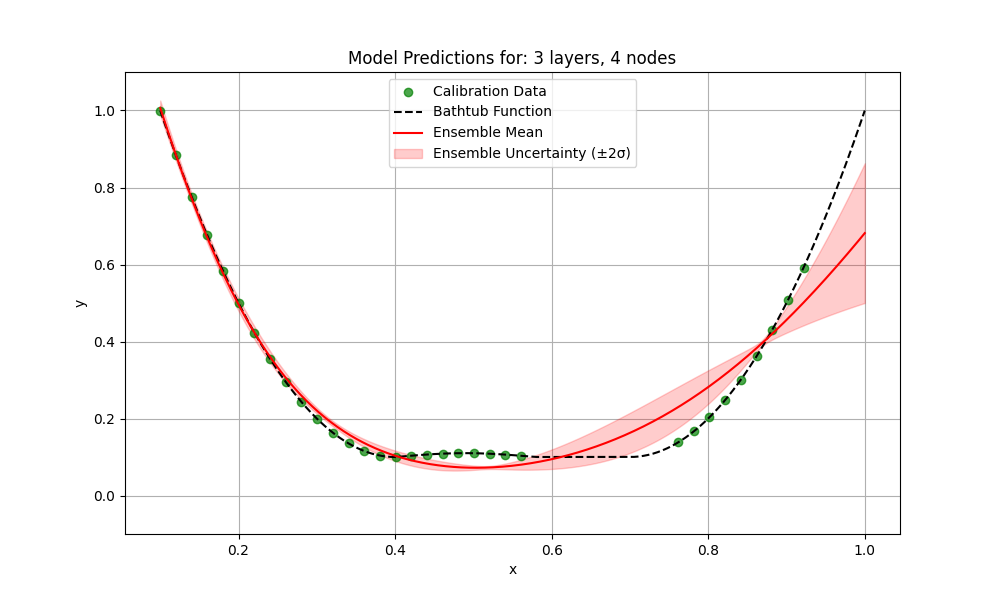

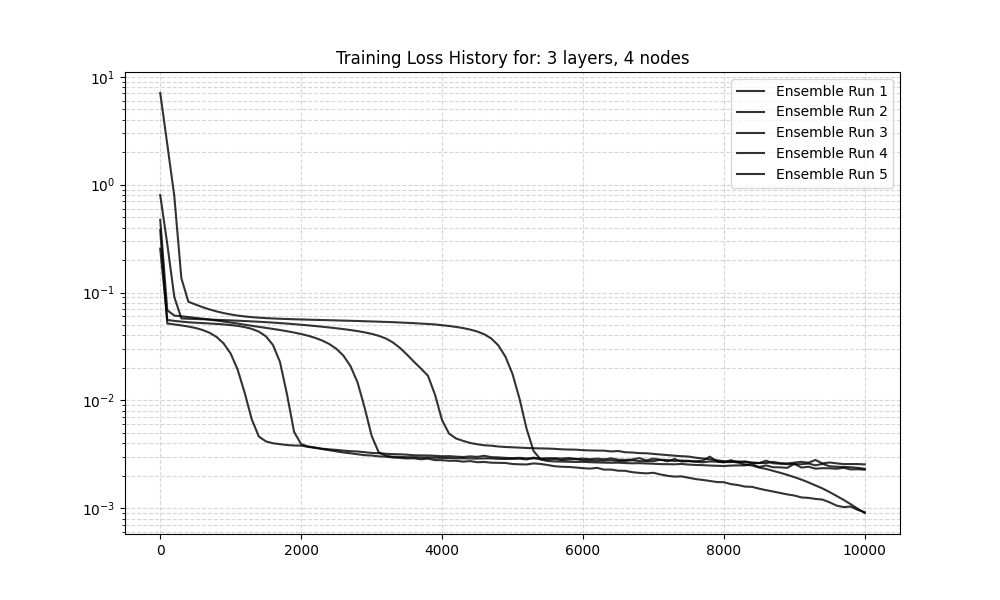

  Avg Final Loss: 0.001795
  Std Dev of Loss: 0.000727

--- Processing architecture: 3 layers, 8 nodes ---


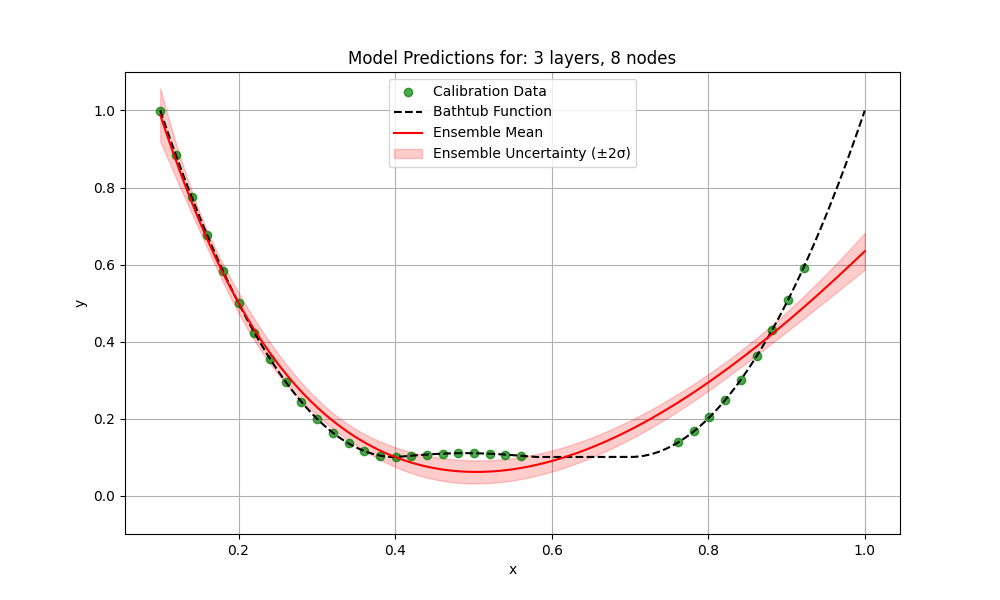

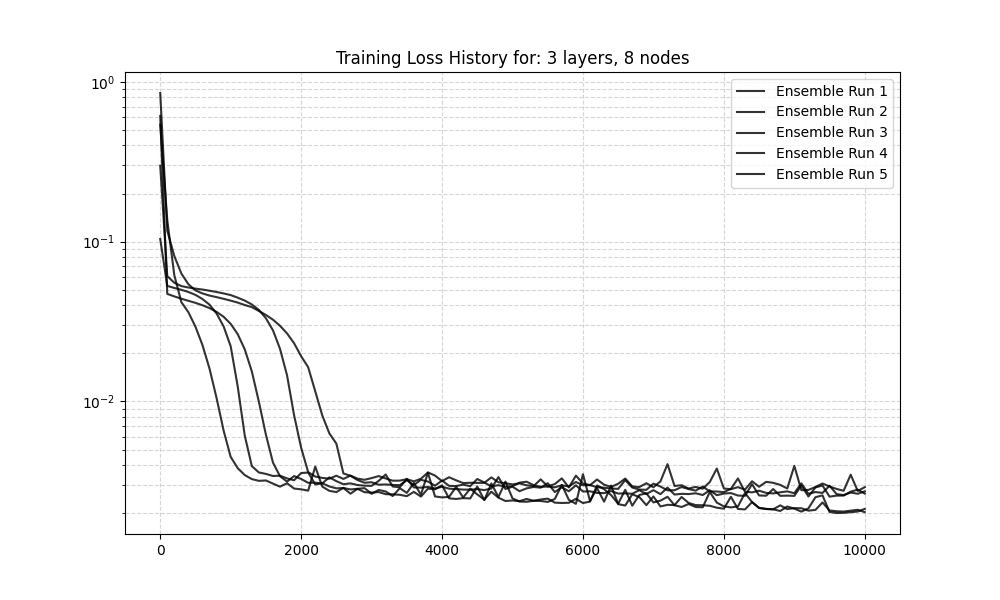

  Avg Final Loss: 0.002490
  Std Dev of Loss: 0.000348

--- Processing architecture: 3 layers, 16 nodes ---


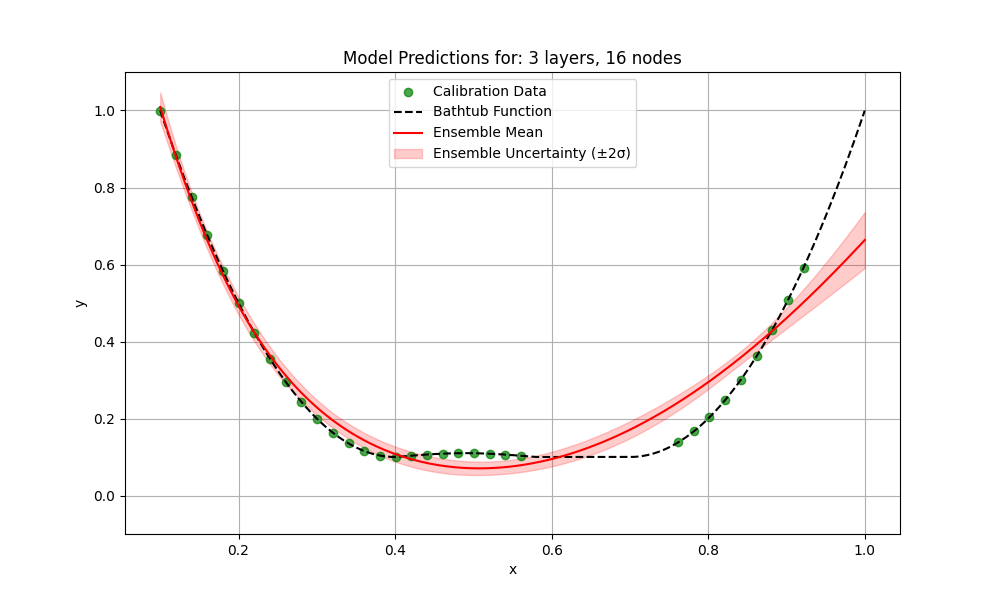

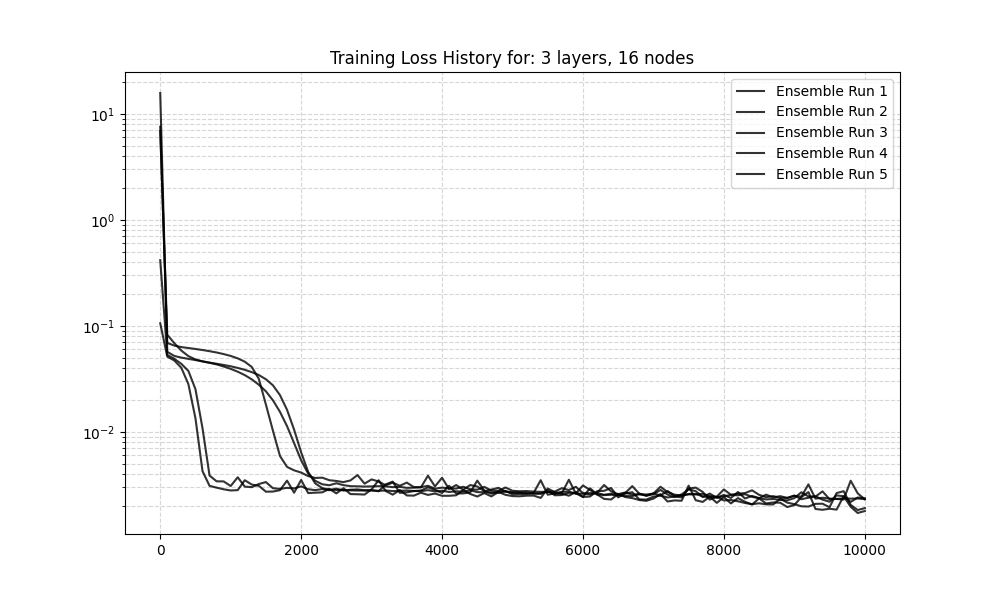

  Avg Final Loss: 0.002137
  Std Dev of Loss: 0.000239



In [ ]:
# --- Main Hyperparameter Sweep Logic ---

# ... (General, fixed Hyperparameters and Data) ...
FIXED_ACTIVATION = jax.nn.softplus
NUM_STEPS = 10000
LEARNING_RATE = 1e-3
ENSEMBLE_SIZE = 5
BATCH_SIZE = 32


# ... (Hyperparameters investigated in Section 1) ...
hidden_layer_configs = [1, 2, 3]
nodes_per_layer_configs = [4, 8, 16]

results = {}

for num_layers in hidden_layer_configs:
    for num_nodes in nodes_per_layer_configs:
        architecture_name = f"{num_layers} layers, {num_nodes} nodes"
        print(f"--- Processing architecture: {architecture_name} ---")
        
        final_losses = []
        trained_ensemble = []
        ensemble_histories = []

        for i in range(ENSEMBLE_SIZE):
            master_key, model_key, train_key = jrandom.split(master_key, 3)

            model = tm.build(   # Using parametrized build function from models.py
                key=model_key, input_dim="scalar", output_dim="scalar",
                num_hidden_layers=num_layers, nodes_per_layer=num_nodes,
                activations=FIXED_ACTIVATION
            )
            
            trained_model, history = tm.train_model(
                model, (x_cal, y_cal), train_key, NUM_STEPS, BATCH_SIZE, LEARNING_RATE
            )
            
            # Append both the loss and the model itself
            final_losses.append(history.loss[-1])
            trained_ensemble.append(trained_model)
            ensemble_histories.append(history)

        # Store quantitative results
        results[architecture_name] = jnp.array(final_losses)
        
        # --- Generate the ensemble plot for this architecture ---
        td.plot_ensemble_results(trained_ensemble, x, y, x_cal, y_cal, title=architecture_name)
        
        # --- Plot the training histories ---
        td.plot_ensemble_histories(ensemble_histories, title=architecture_name)
        
        # Print summary statistics for this architecture
        print(f"  Avg Final Training Loss: {jnp.mean(results[architecture_name]):.6f}")
        print(f"  Std Dev of Training Loss: {jnp.std(results[architecture_name]):.6f}\n")

##### Section 1 - Observations:

**Effect of Width (Nodes):** Increasing the number of nodes in a single-layer network dramatically improves the model's ability to fit the function and reduces the ensemble uncertainty. The 1-layer, 4-node model is clearly under-resourced, resulting in a poor fit and high variance, while the 1-layer, 16-node model is a much more stable and accurate fit.

**Effect of Depth (Layers):** Adding depth (layers) appears to be more impactful than adding width (nodes). A 2-layer, 4-node model achieves a significantly better fit and lower ensemble variance than even the 1-layer, 16-node model. This suggests deeper architectures can capture the function's complex shape more efficiently.

**Poor Interpolation:** All models, regardless of size, struggle to interpolate the non-convex "flat" minimum of the bathtub function (x ≈ 0.4-0.6). The ensemble mean consistently dips below the true function, attempting to fit the S-shape rather than the flat line.

**Poor Extrapolation:** All models fail to extrapolate the quadratic trend on the right-hand side (x > 0.8), where calibration data is sparse. The model predictions revert to a much simpler, almost linear function that under-fits the true curve, highlighting a classic failure mode of standard FFNNs in data-sparse regions.

#### Section 2: Number of training steps in the parameter optimization
We will define three architectures for which we will try six different numbers of training steps in the parameter optimization.

Training steps [500, 1000, 2500, 5000, 10000, 30000]

Testing Architecture: Small (1L, 4N)
--- Processing: Small (1L, 4N) with 500 steps ---


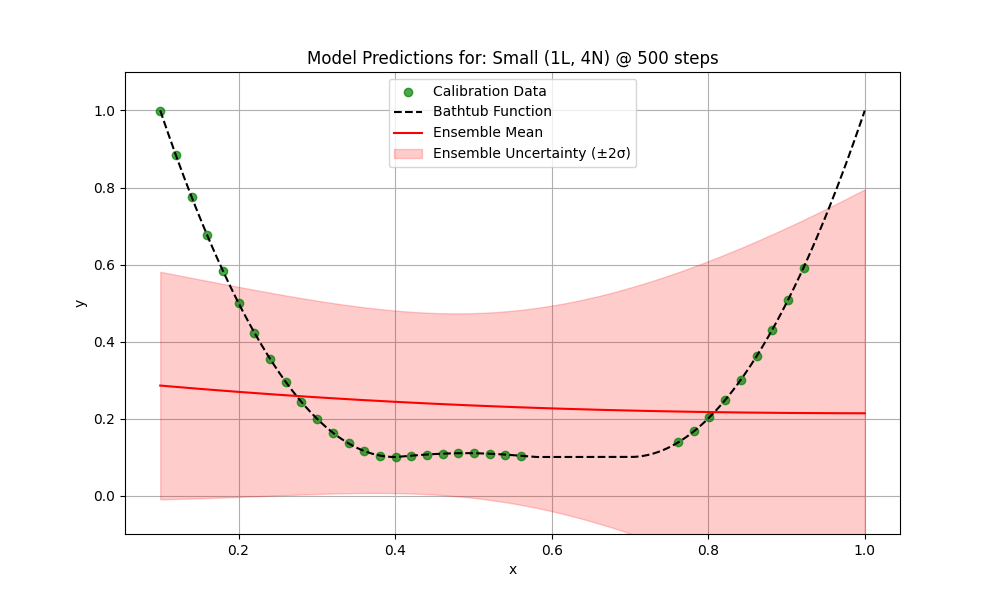

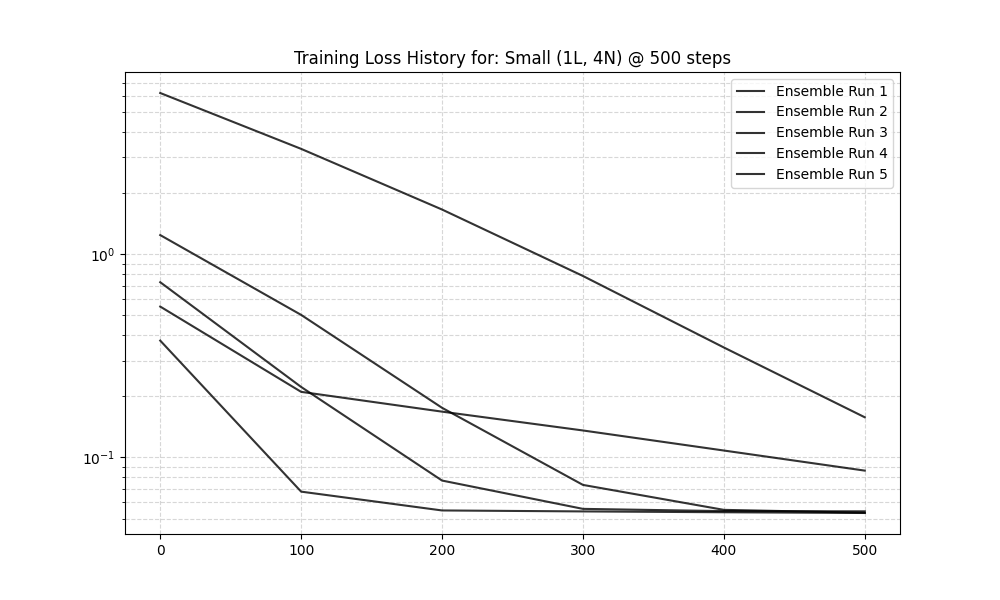

  Avg Final Loss: 0.080925
  Std Dev of Loss: 0.040354

--- Processing: Small (1L, 4N) with 1000 steps ---


c:\Users\alexp\Desktop\#Uni\Master 1\5. Semester\PAML Tutorium\Repo\ML-Tutorial-WS25_26\ffnn_introduction\src\tmlsm\data.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 6))


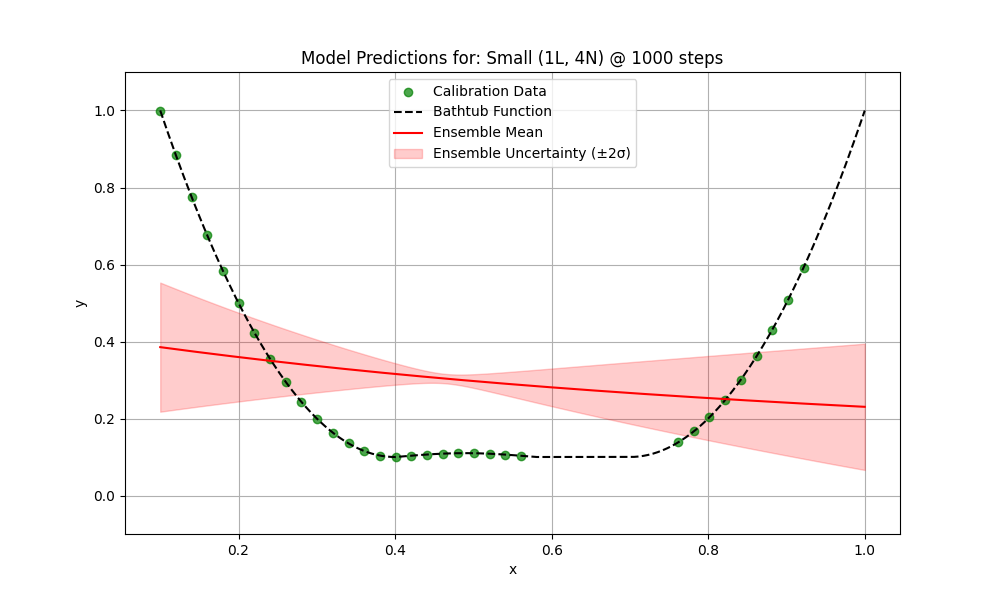

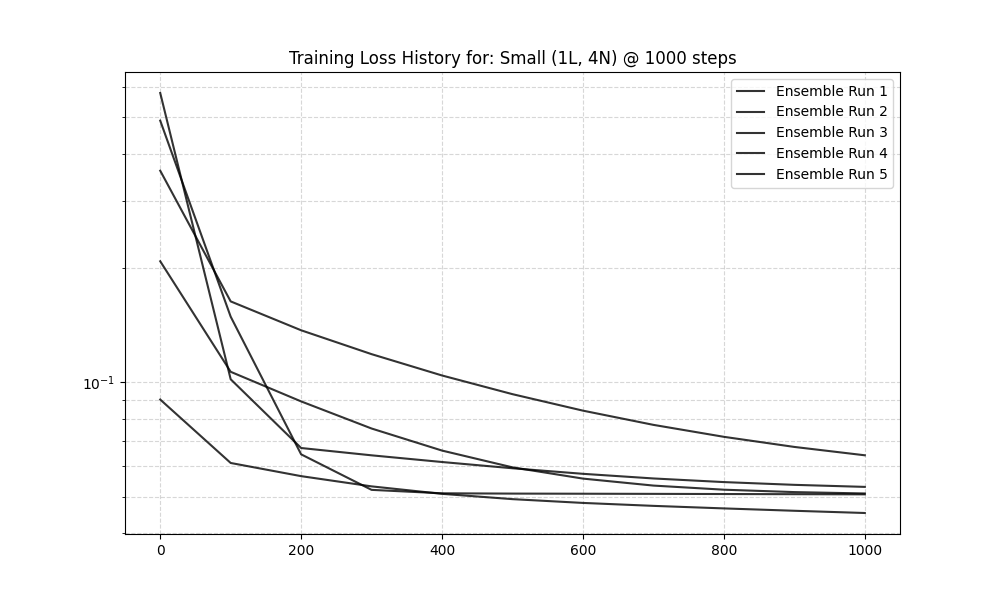

  Avg Final Loss: 0.052813
  Std Dev of Loss: 0.006253

--- Processing: Small (1L, 4N) with 2500 steps ---


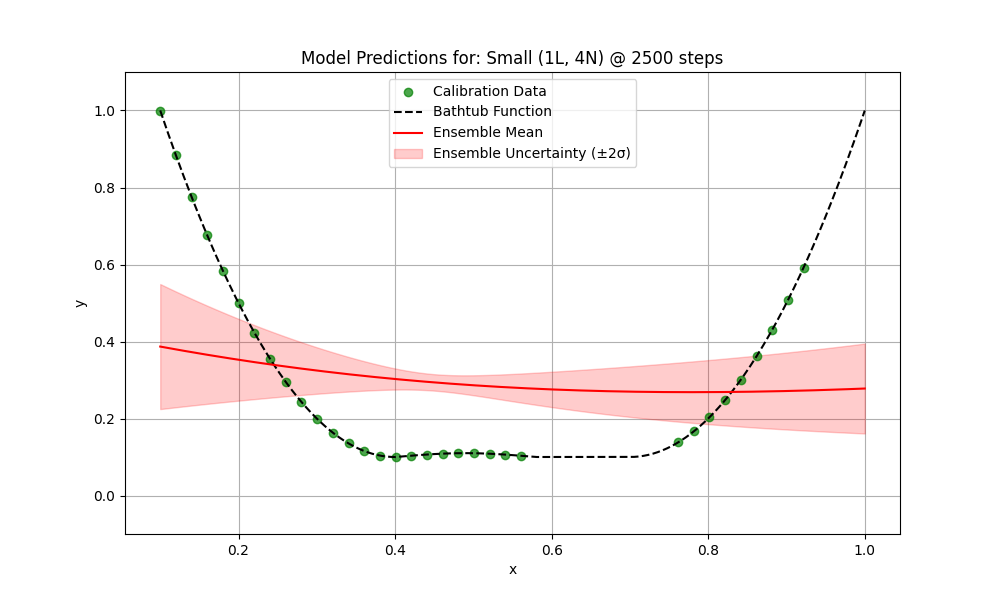

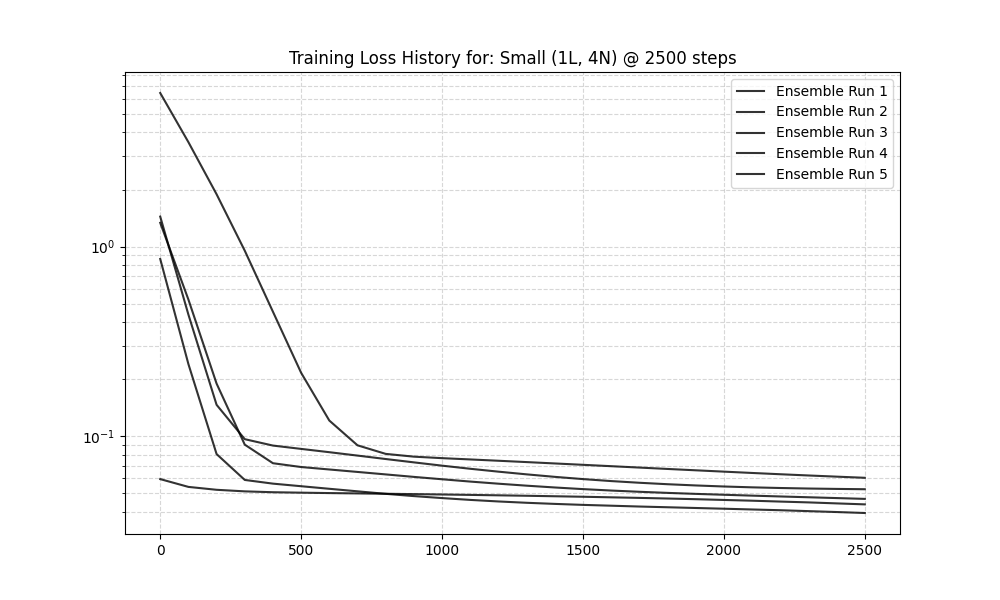

  Avg Final Loss: 0.048654
  Std Dev of Loss: 0.007316

--- Processing: Small (1L, 4N) with 5000 steps ---


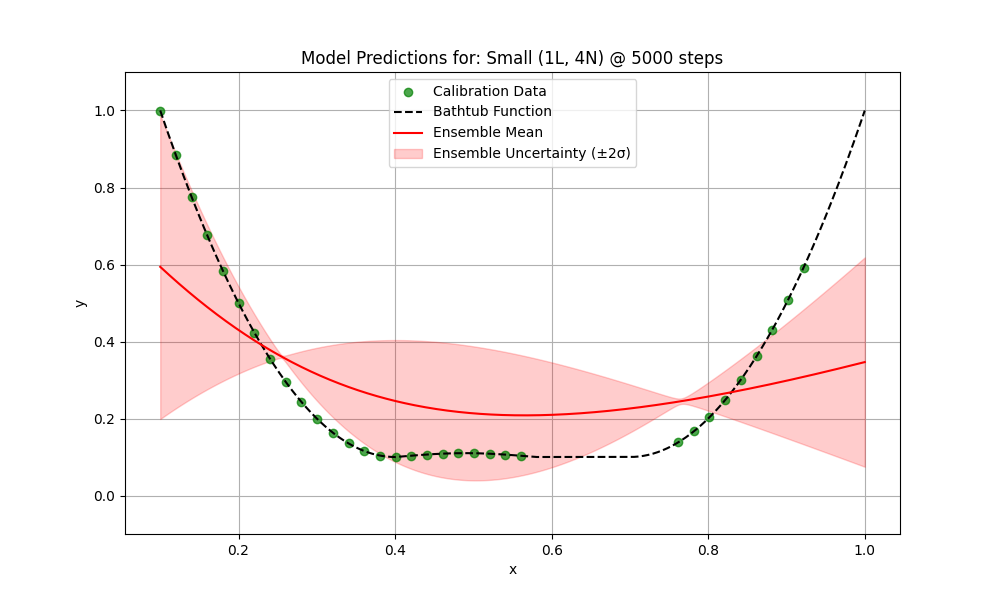

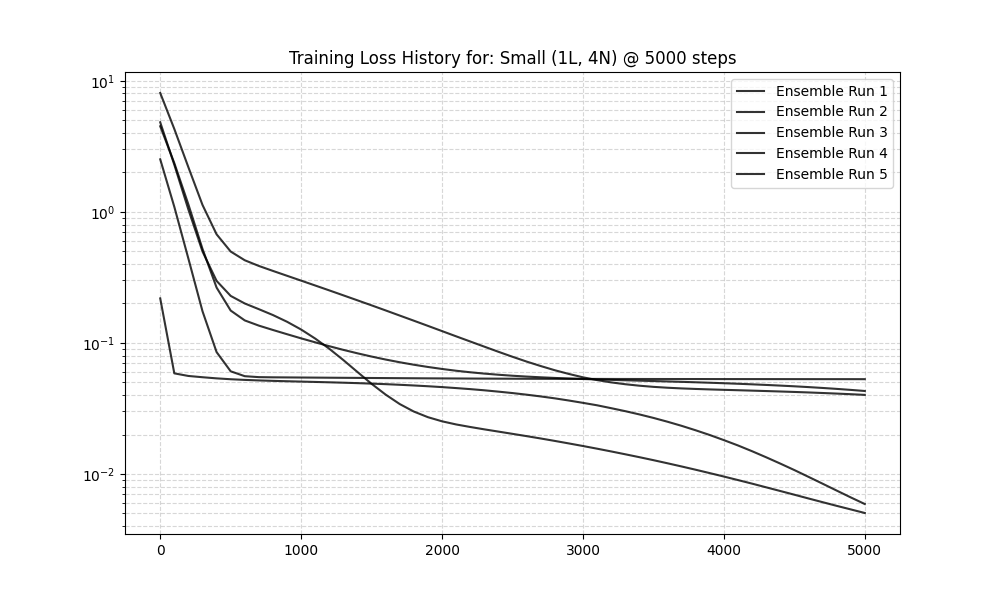

  Avg Final Loss: 0.029399
  Std Dev of Loss: 0.019991

--- Processing: Small (1L, 4N) with 10000 steps ---


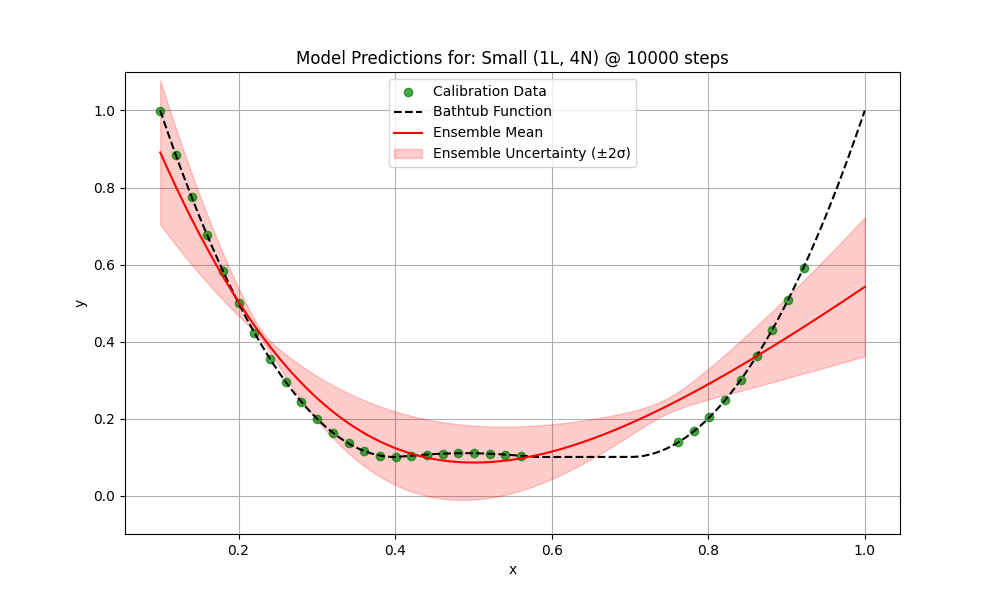

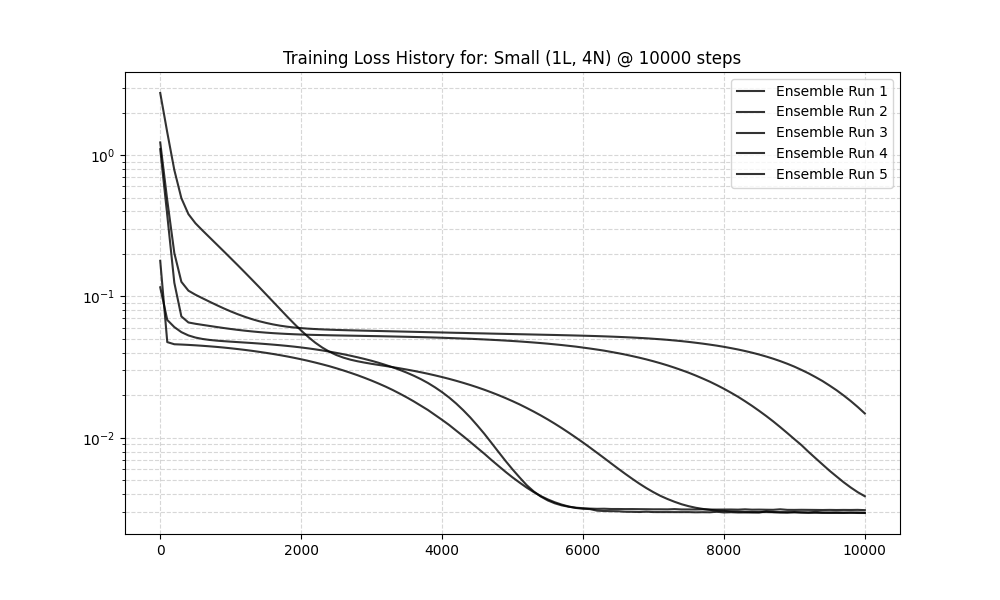

  Avg Final Loss: 0.005545
  Std Dev of Loss: 0.004684

--- Processing: Small (1L, 4N) with 30000 steps ---


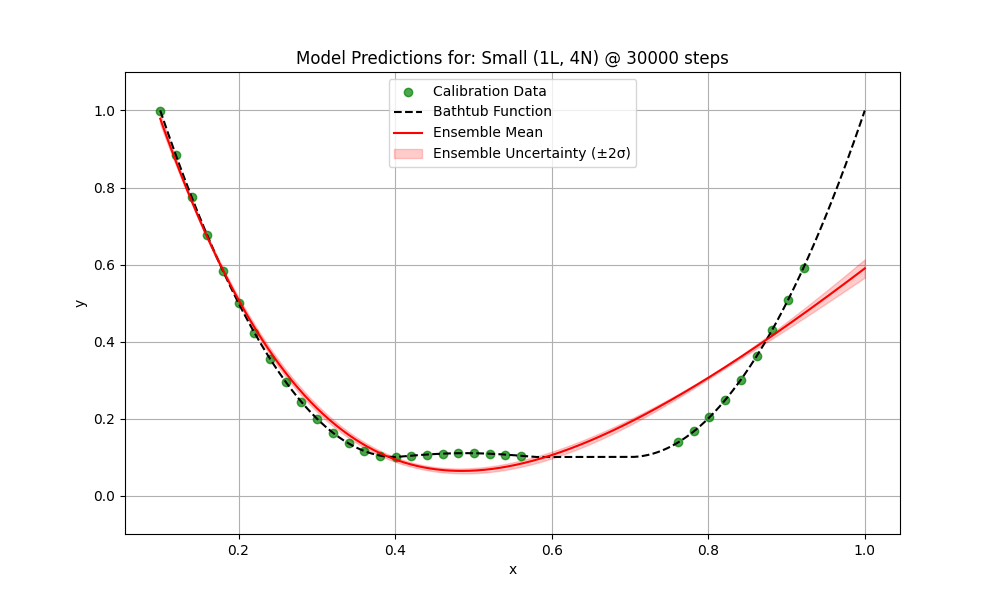

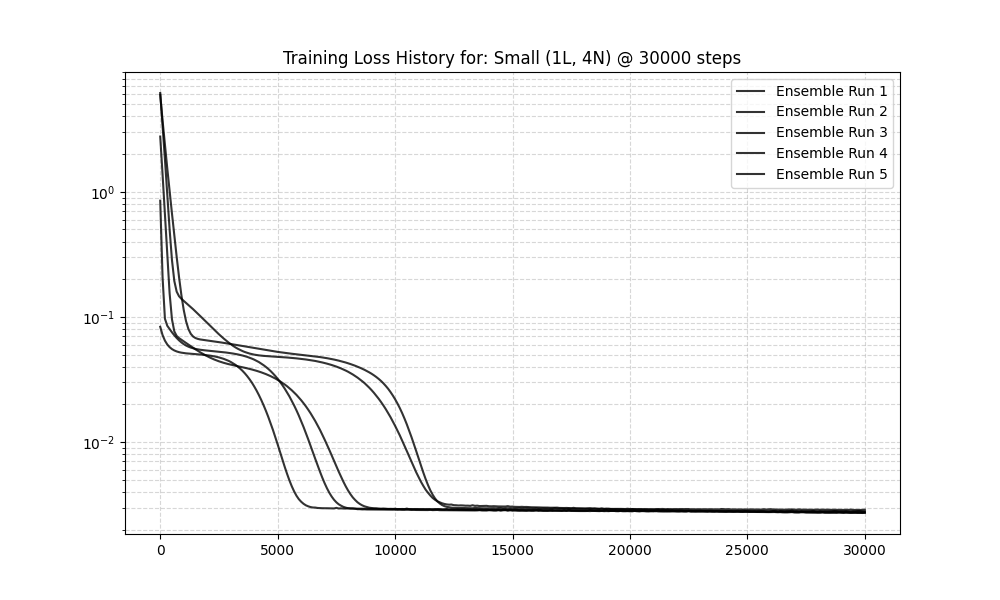

  Avg Final Loss: 0.002777
  Std Dev of Loss: 0.000057

Testing Architecture: Medium (2L, 8N)
--- Processing: Medium (2L, 8N) with 500 steps ---


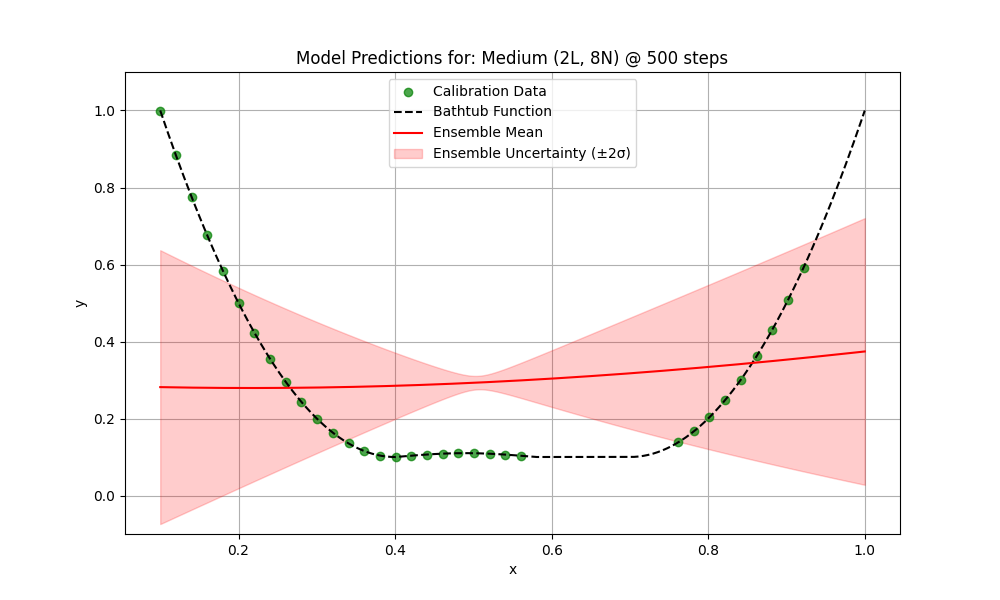

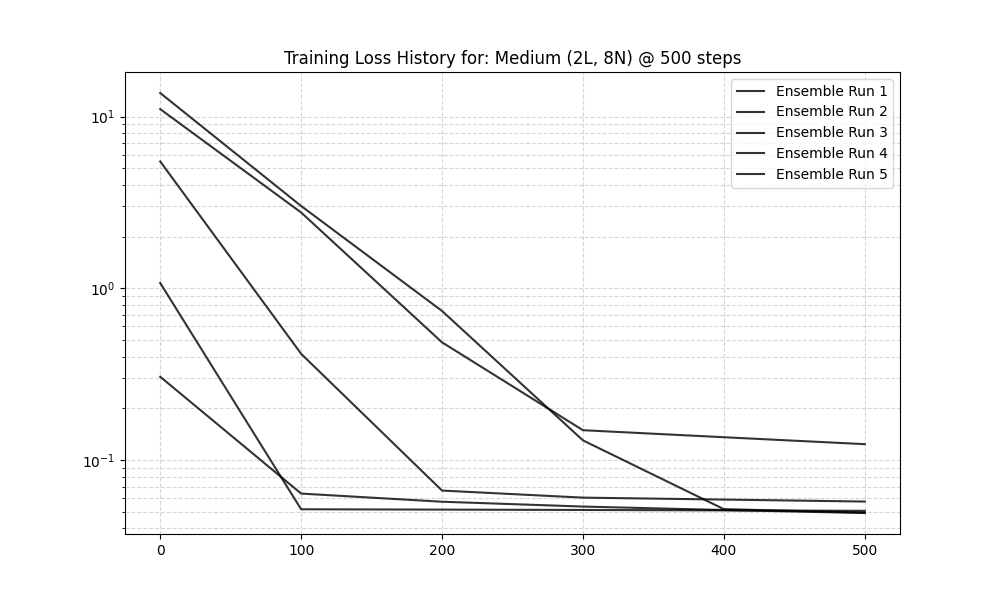

  Avg Final Loss: 0.066026
  Std Dev of Loss: 0.028972

--- Processing: Medium (2L, 8N) with 1000 steps ---


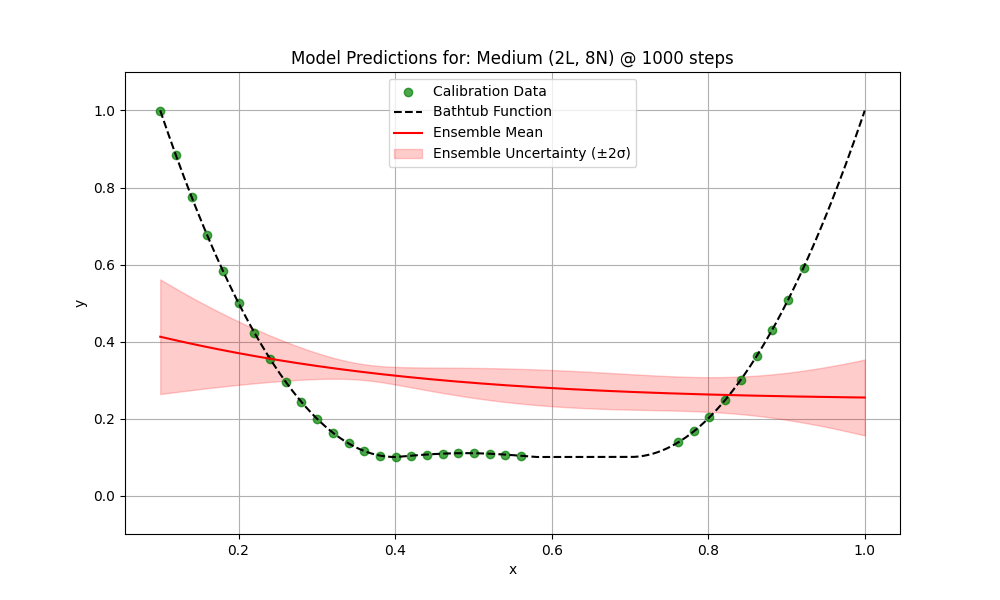

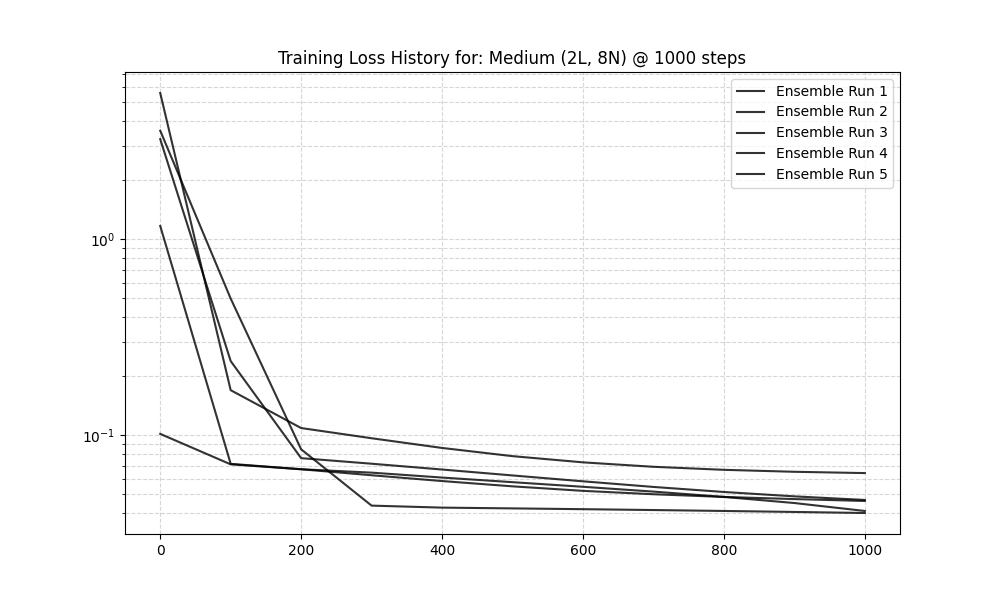

  Avg Final Loss: 0.047624
  Std Dev of Loss: 0.008641

--- Processing: Medium (2L, 8N) with 2500 steps ---


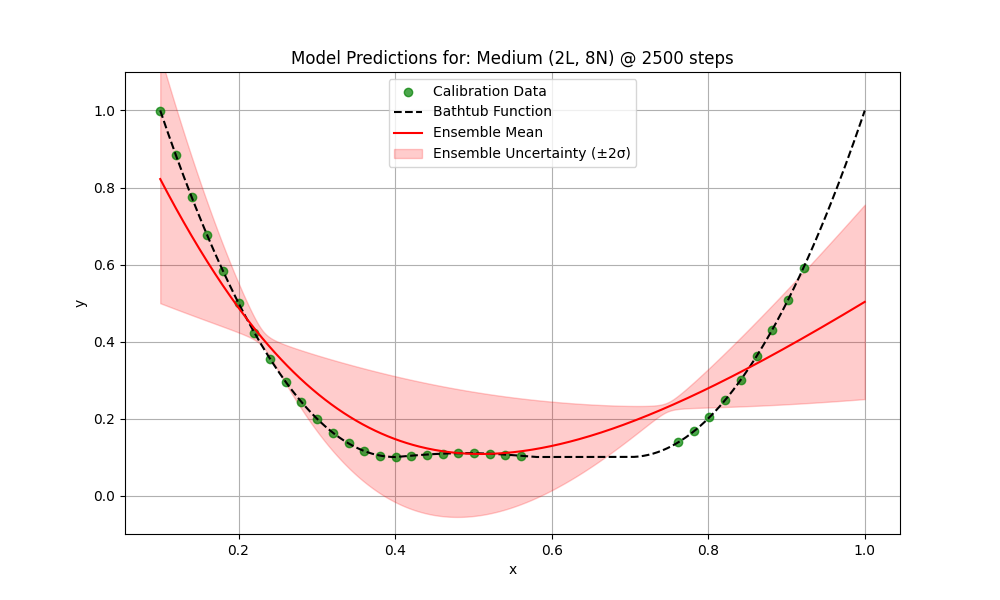

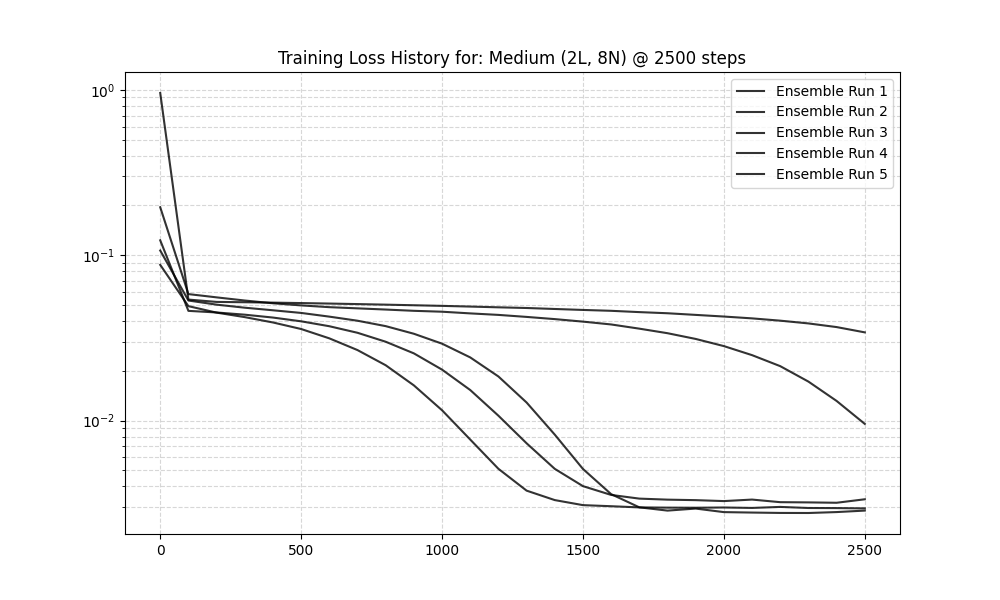

  Avg Final Loss: 0.010567
  Std Dev of Loss: 0.012059

--- Processing: Medium (2L, 8N) with 5000 steps ---


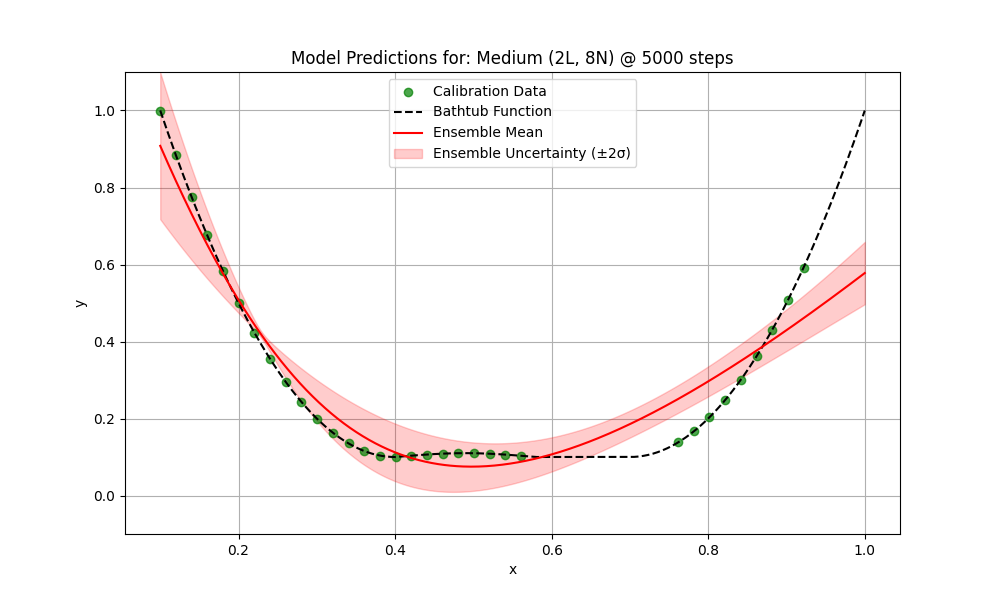

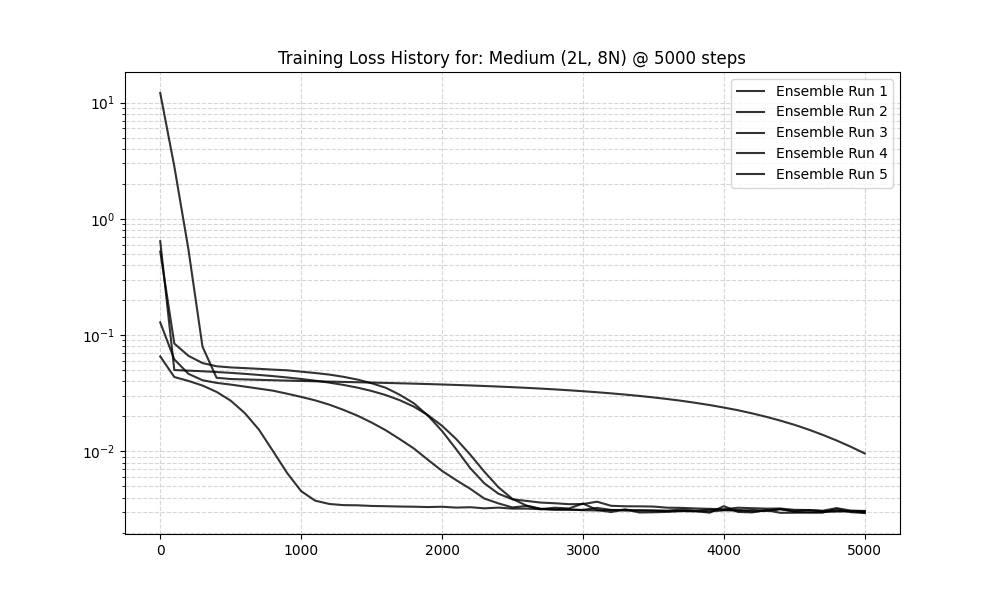

  Avg Final Loss: 0.004334
  Std Dev of Loss: 0.002636

--- Processing: Medium (2L, 8N) with 10000 steps ---


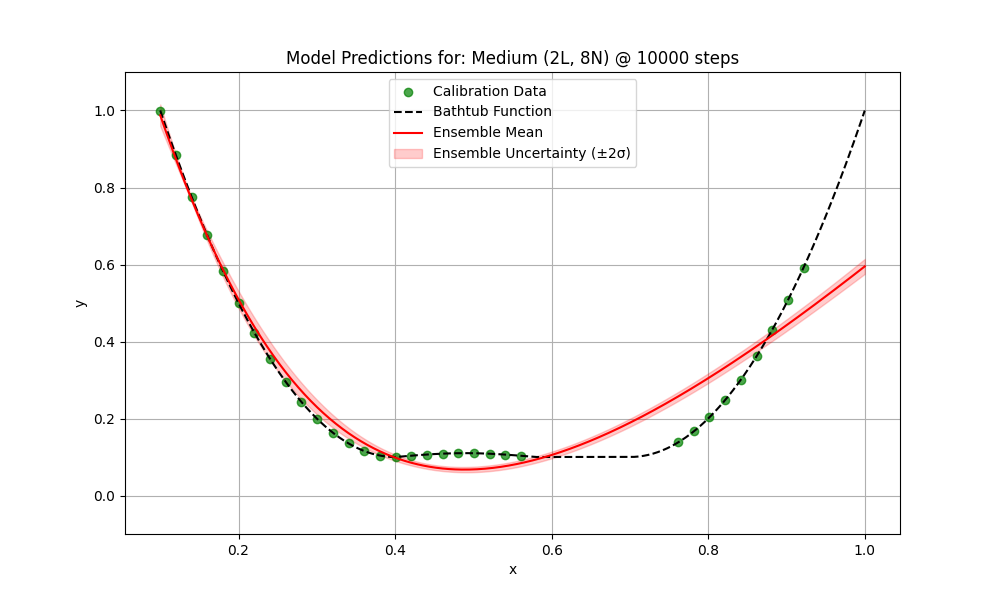

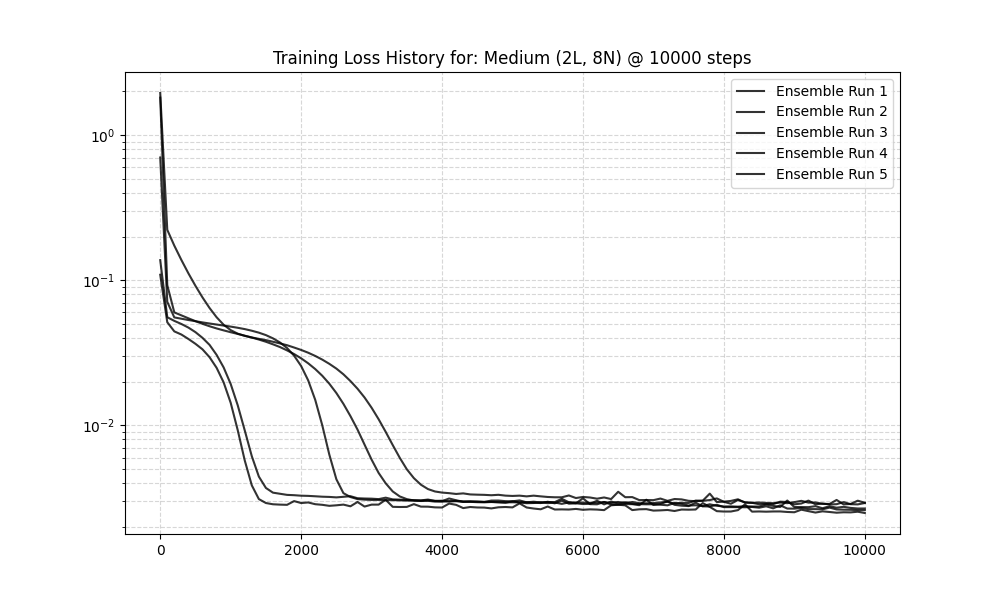

  Avg Final Loss: 0.002725
  Std Dev of Loss: 0.000174

--- Processing: Medium (2L, 8N) with 30000 steps ---


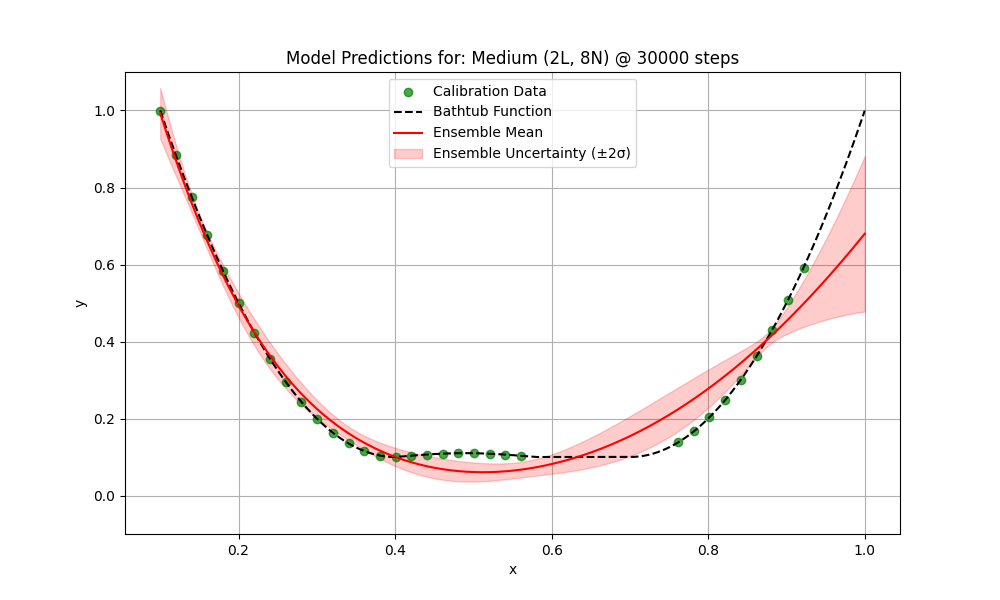

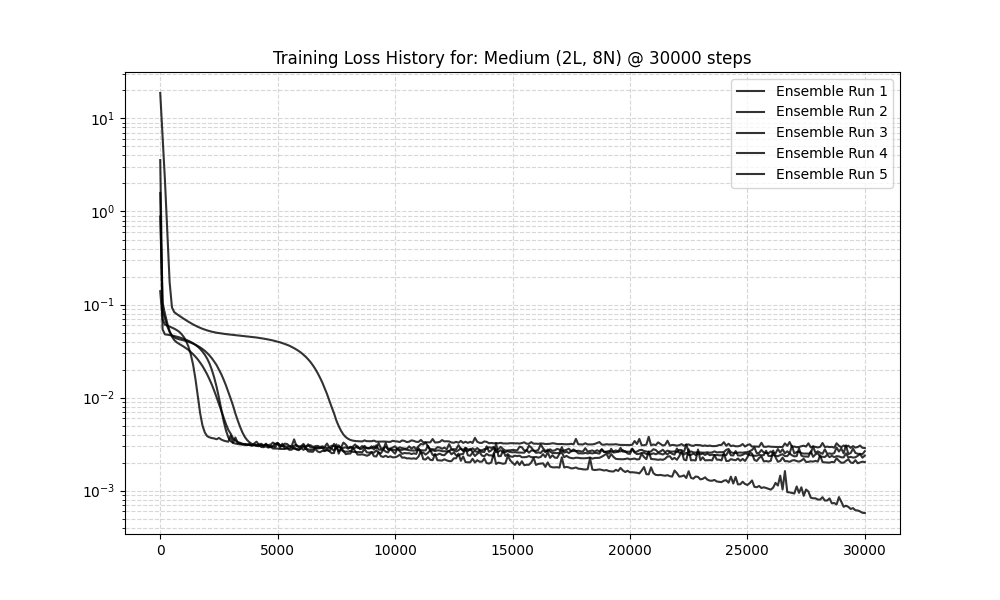

  Avg Final Loss: 0.002104
  Std Dev of Loss: 0.000815

Testing Architecture: Large (3L, 16N)
--- Processing: Large (3L, 16N) with 500 steps ---


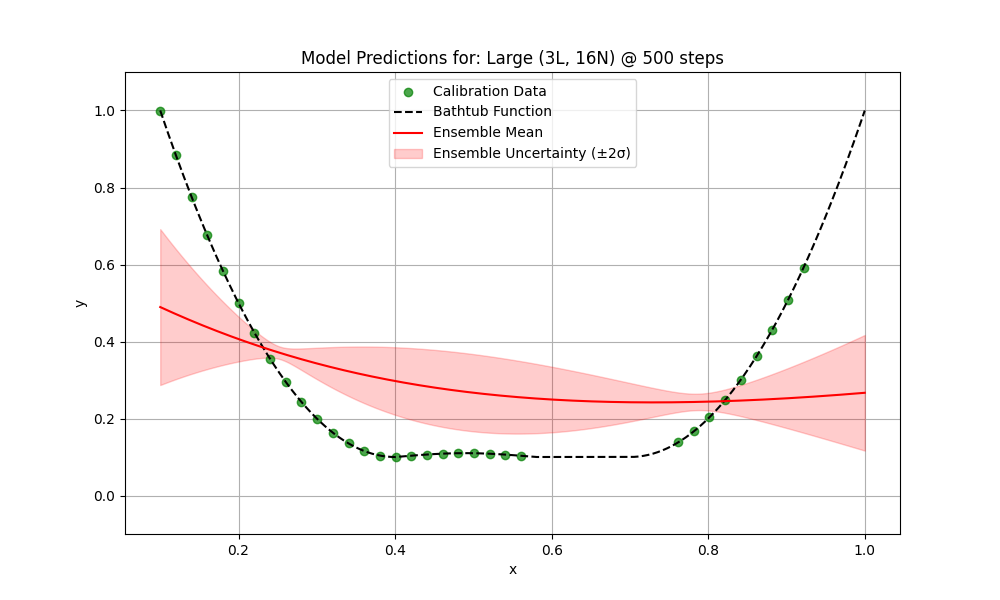

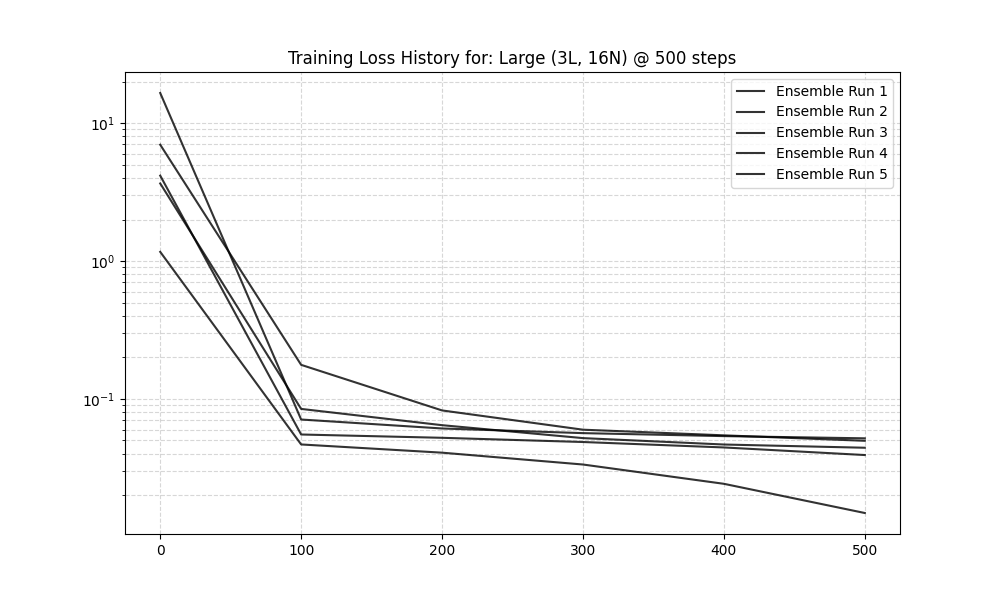

  Avg Final Loss: 0.040007
  Std Dev of Loss: 0.013299

--- Processing: Large (3L, 16N) with 1000 steps ---


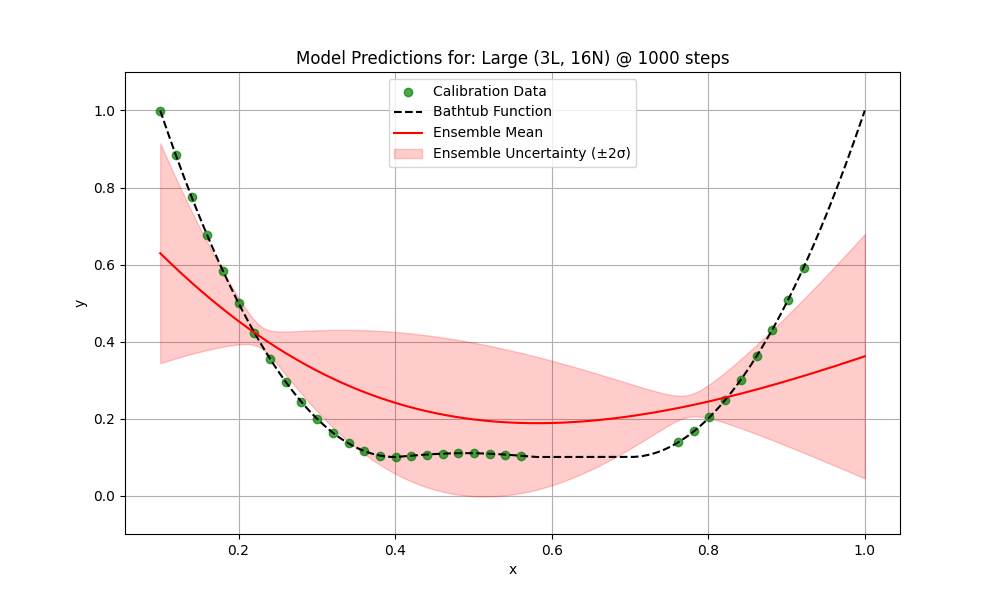

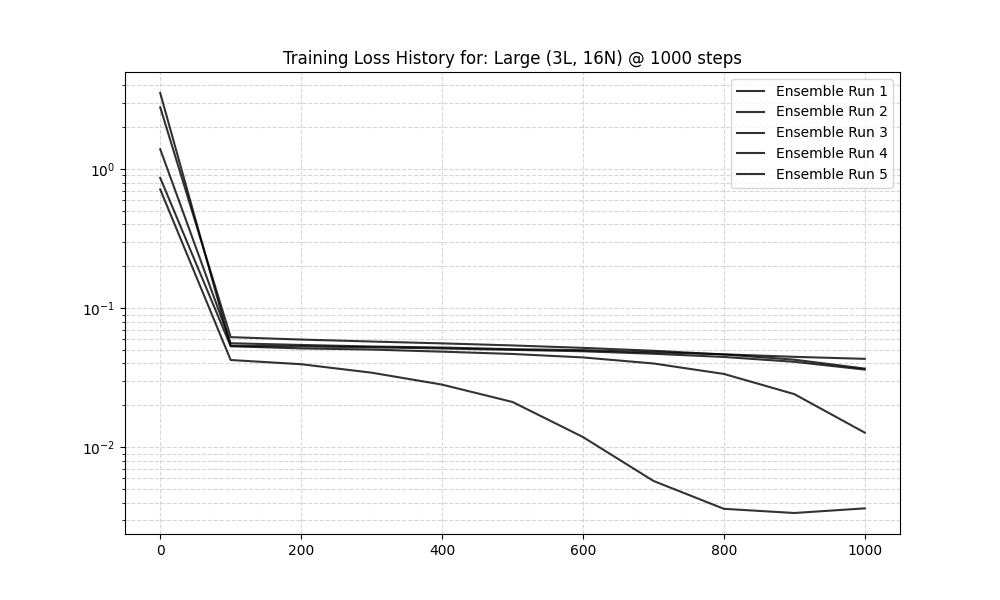

  Avg Final Loss: 0.026489
  Std Dev of Loss: 0.015424

--- Processing: Large (3L, 16N) with 2500 steps ---


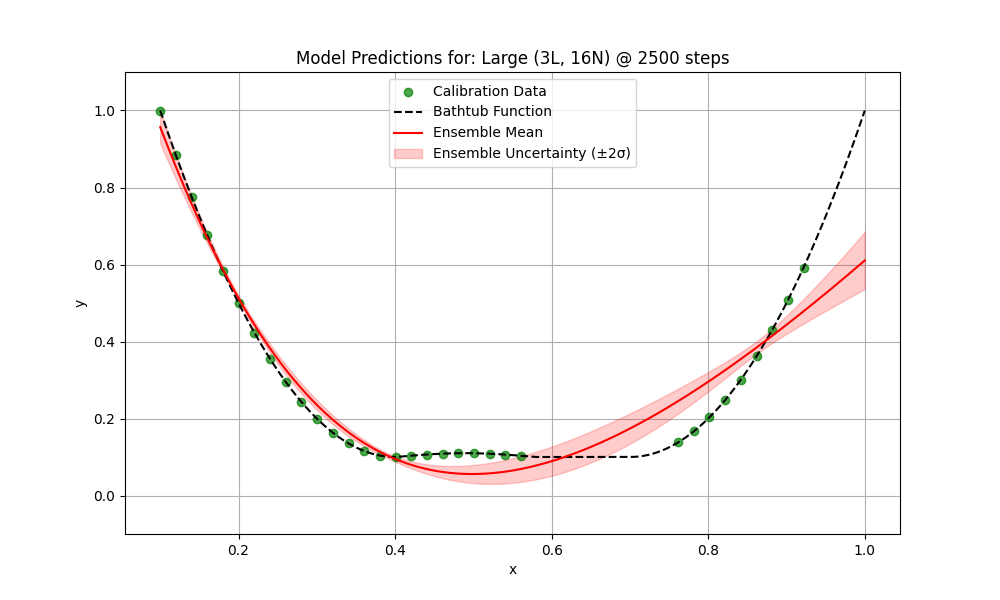

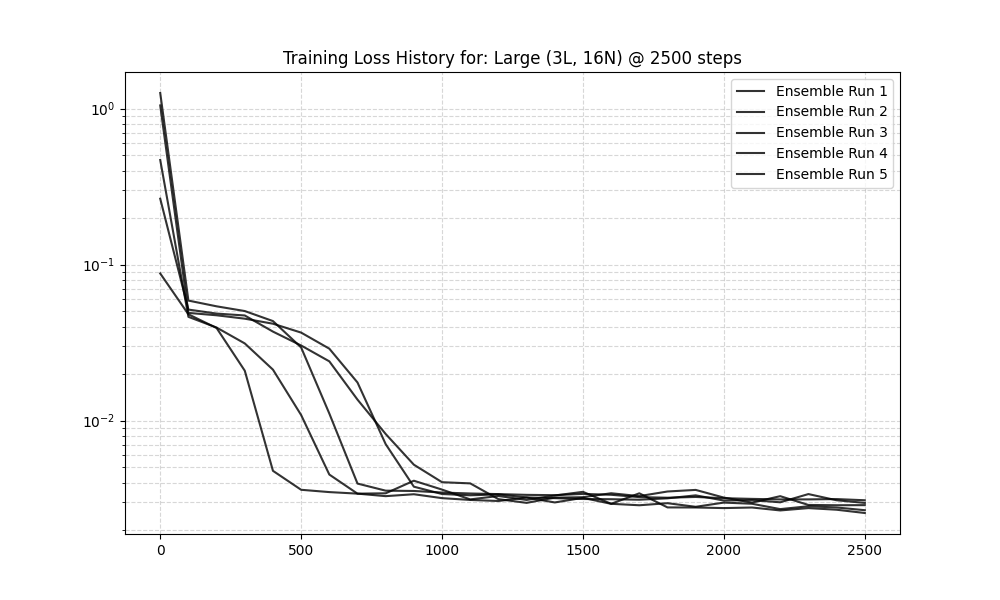

  Avg Final Loss: 0.002826
  Std Dev of Loss: 0.000194

--- Processing: Large (3L, 16N) with 5000 steps ---


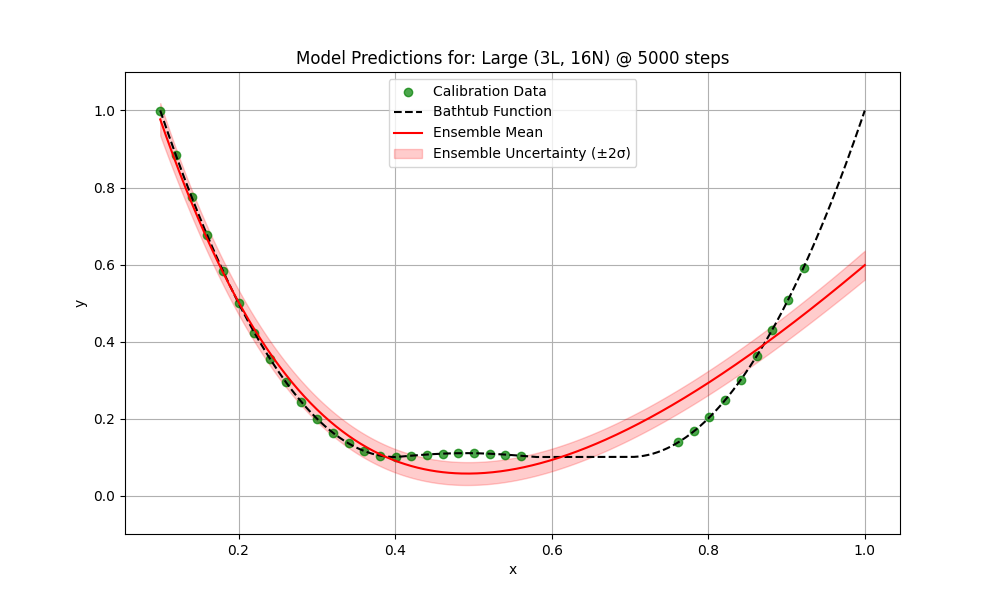

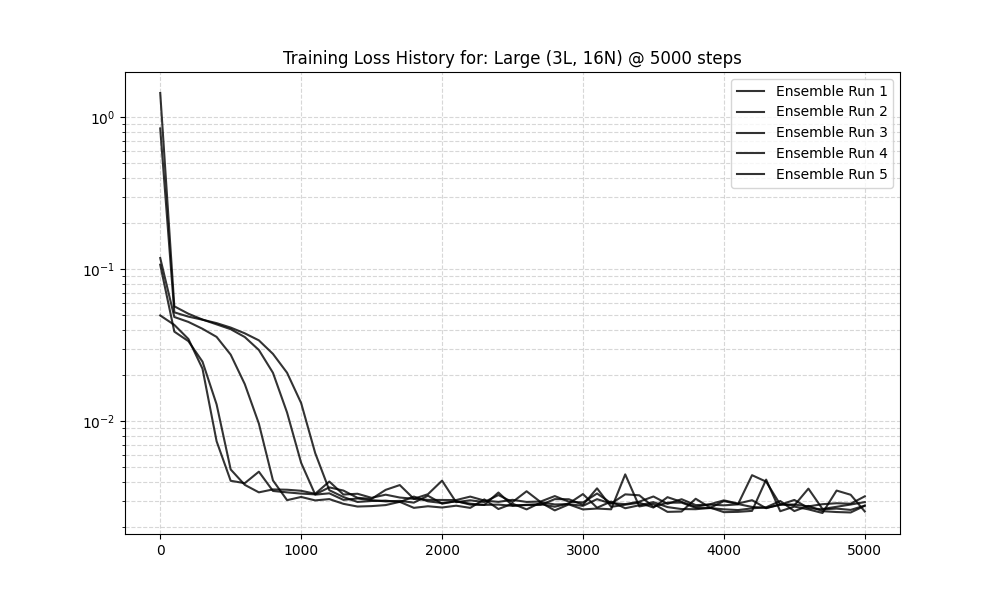

  Avg Final Loss: 0.002852
  Std Dev of Loss: 0.000216

--- Processing: Large (3L, 16N) with 10000 steps ---


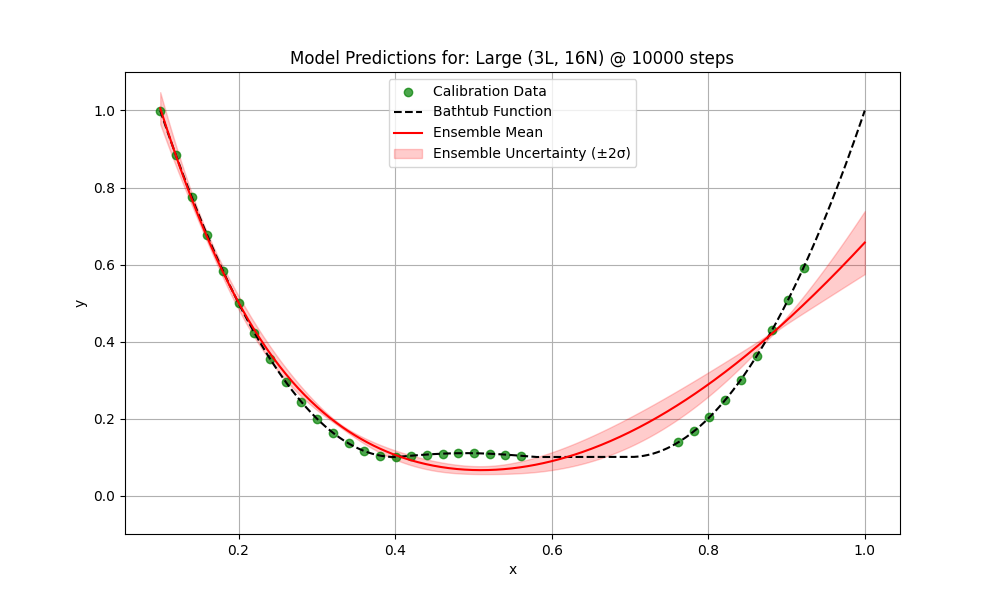

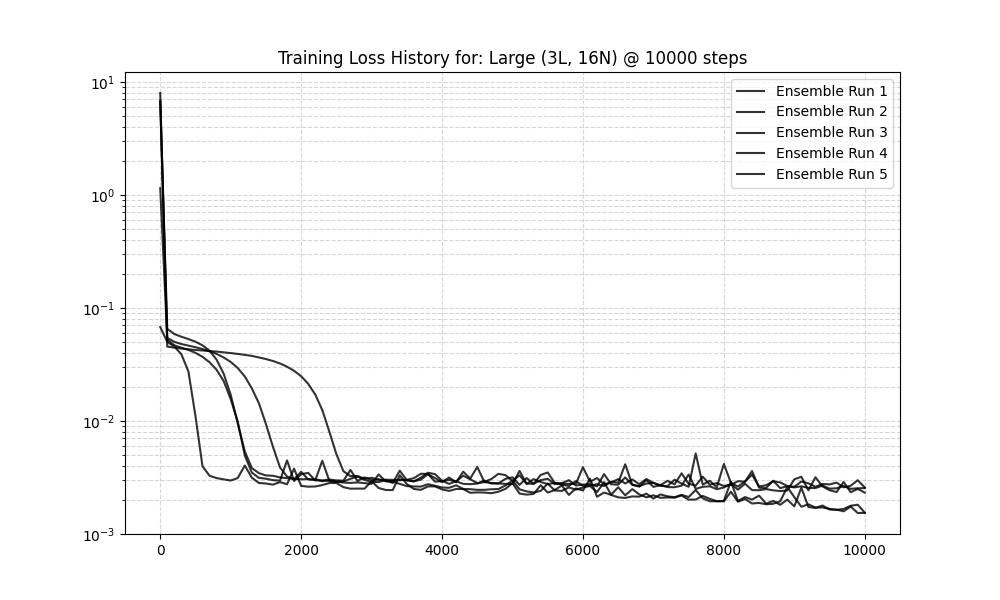

  Avg Final Loss: 0.002100
  Std Dev of Loss: 0.000468

--- Processing: Large (3L, 16N) with 30000 steps ---


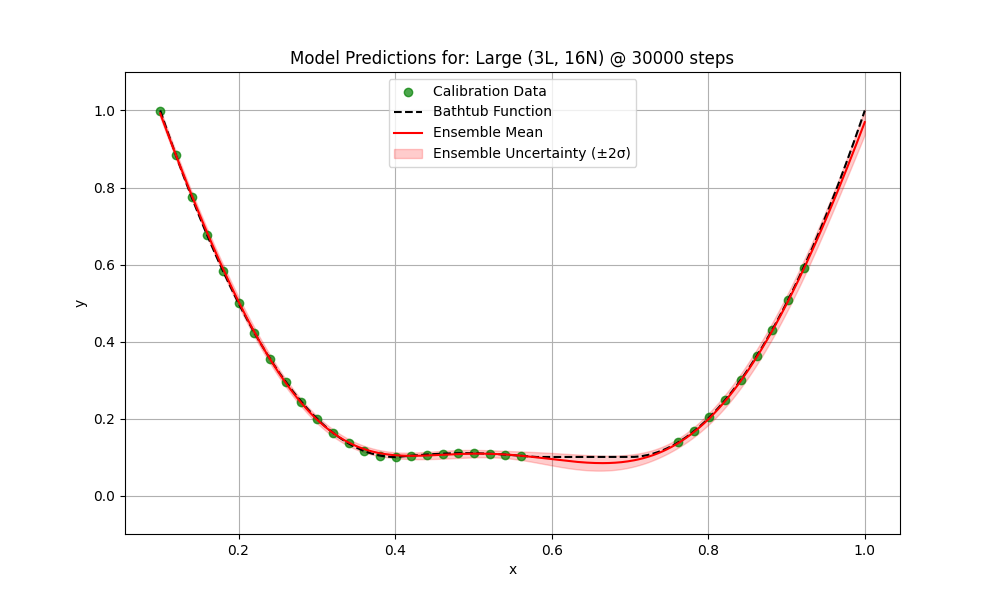

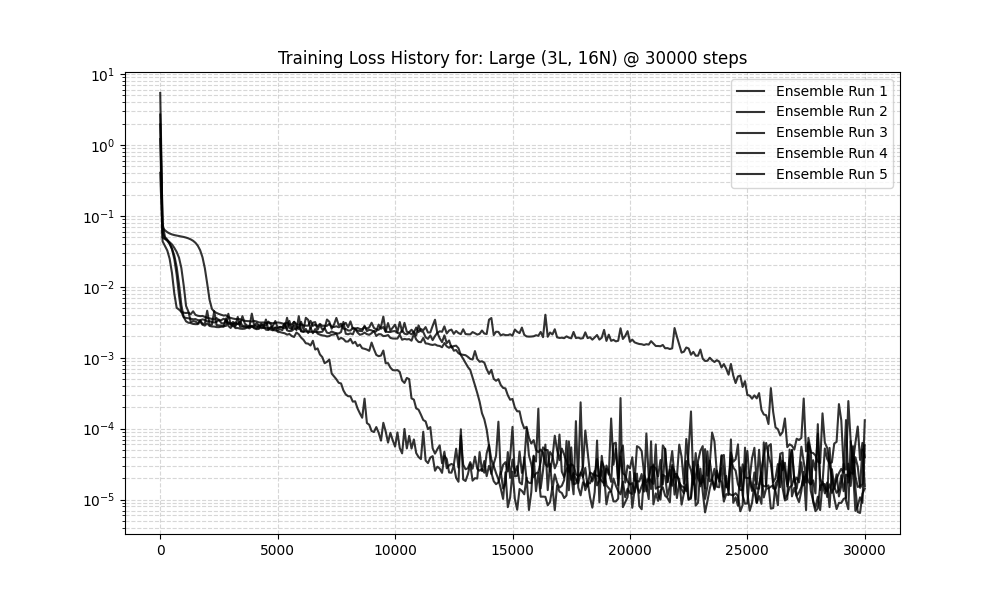

  Avg Final Loss: 0.000052
  Std Dev of Loss: 0.000043



In [ ]:
# --- Fixed Hyperparameters for Section 2 ---
FIXED_ACTIVATION = jax.nn.softplus
LEARNING_RATE = 1e-3
ENSEMBLE_SIZE = 5
BATCH_SIZE = 32

# --- Parameters to Vary ---
steps_to_test = [500, 1000, 2500, 5000, 10000, 30000]

# Defining three architectures

arch_1 = {
    "name": "Small (1L, 4N)",
    "layers": 1,
    "nodes": 4
}
arch_2 = {
    "name": "Medium (2L, 8N)",
    "layers": 2,
    "nodes": 8
}
arch_3 = {
    "name": "Large (3L, 16N)",
    "layers": 3,
    "nodes": 16
}

architectures_to_test = [arch_1, arch_2, arch_3]
results_sec2 = {}

# --- Main Loop ---
# Outer loop: Iterate over 3 chosen architectures
for arch in architectures_to_test:
    arch_name = arch['name']
    print(f"==============================================")
    print(f"Testing Architecture: {arch_name}")
    print(f"==============================================")
    
    results_sec2[arch_name] = {}

    # Inner loop: Iterate over the different training step counts
    for num_steps in steps_to_test:
        
        step_name = f"{num_steps} steps"
        print(f"--- Processing: {arch_name} with {step_name} ---")
        
        final_losses = []
        trained_ensemble = []
        ensemble_histories = []

        # Ensemble loop (identical to Section 1)
        for i in range(ENSEMBLE_SIZE):
            master_key, model_key, train_key = jrandom.split(master_key, 3)

            # Build the model using the architecture's parameters
            model = tm.build(
                key=model_key, input_dim="scalar", output_dim="scalar",
                num_hidden_layers=arch['layers'],  # <-- From outer loop
                nodes_per_layer=arch['nodes'],    # <-- From outer loop
                activations=FIXED_ACTIVATION
            )
            
            # Train the model using the step count from the inner loop
            trained_model, history = tm.train_model(
                model, (x_cal, y_cal), train_key,
                steps=num_steps,  # <-- From inner loop
                batch_size=BATCH_SIZE,
                learning_rate=LEARNING_RATE
            )
            
            # Append results for this ensemble member
            final_losses.append(history.loss[-1])
            trained_ensemble.append(trained_model)
            ensemble_histories.append(history)
            
        # --- Store quantitative results for this (arch, step) combo ---
        mean_loss = jnp.mean(jnp.array(final_losses))
        std_loss = jnp.std(jnp.array(final_losses))
        results_sec2[arch_name][step_name] = (mean_loss, std_loss)
        
        # --- Generate plots for this (arch, step) combo ---
        plot_title = f"{arch_name} @ {step_name}"
        td.plot_ensemble_results(trained_ensemble, x, y, x_cal, y_cal, title=plot_title)
        td.plot_ensemble_histories(ensemble_histories, title=plot_title)
        
        # --- Print summary stats ---
        print(f"  Avg Final Training Loss: {mean_loss:.6f}")
        print(f"  Std Dev of Training Loss: {std_loss:.6f}\n")

##### Section 2 - Observations:

**Convergence and Uncertainty:** As expected, increasing the number of training steps dramatically improves the model's fit and reduces ensemble uncertainty (variance). Models with few steps (e.g., Medium @ 1000 steps) are essentially untrained, predicting a flat line with high uncertainty. As training progresses, the ensembles converge, tightening the uncertainty band and improving the fit.

**Model Capacity vs. Training:** More complex architectures ("Large") learn the function's shape much faster than simple ones. The "Large (3L, 16N)" model at just 2500 steps has a better grasp of the function than the "Small (1L, 4N)" model at 5000 steps.

**Achieving a Full Fit:** With sufficient capacity and training, the "Large (3L, 16N)" model at 30,000 steps achieves a near-perfect fit. It successfully interpolates the non-convex flat minimum and extrapolates the steep quadratic curve on the right, which all other models failed to do.

**Escaping Local Minima (Insight):** The "Medium (2L, 8N)" model shows a fascinating behavior. At 10,000 steps, the ensemble is "confidently wrong," converging to a poor local minimum with a very tight uncertainty band. By 30,000 steps, the uncertainty increases, suggesting the models have escaped that local minimum and are exploring better, more diverse solutions, resulting in a trend on the righthand extrapolation side which seems to approach the true behaviour moving from the previous almost linear towards a more quadratic slope.


#### Section 3: Using different activation functions
For this section we will use the architecture which has so far performed the best which uses 3 Layers with 16 Neurons each. We will proceed to implement this network structure with different activation functions and compare the results.

Activation Functions [Relu, Softplus, Sigmoid]

Testing Activation Function: relu


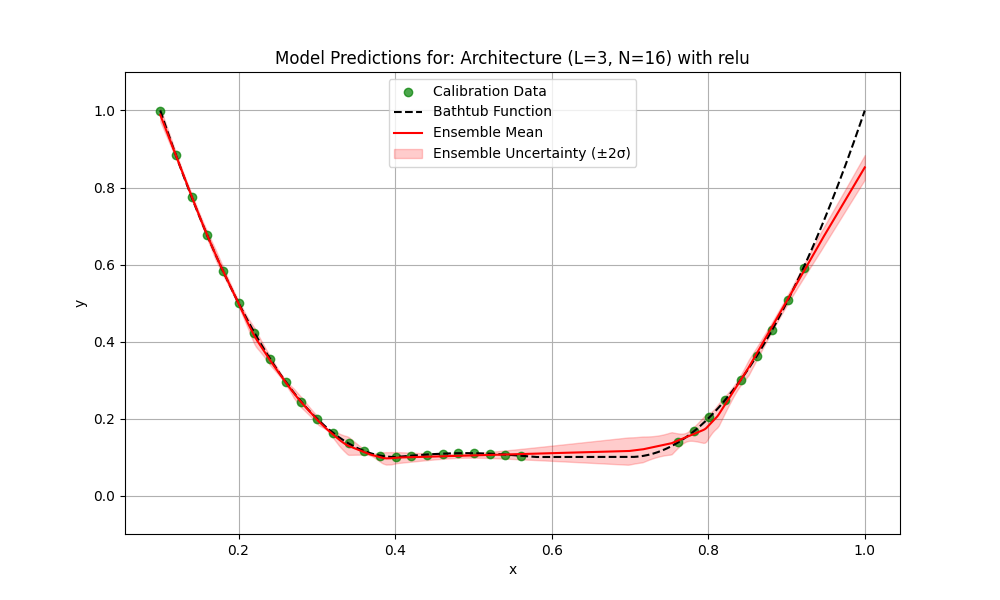

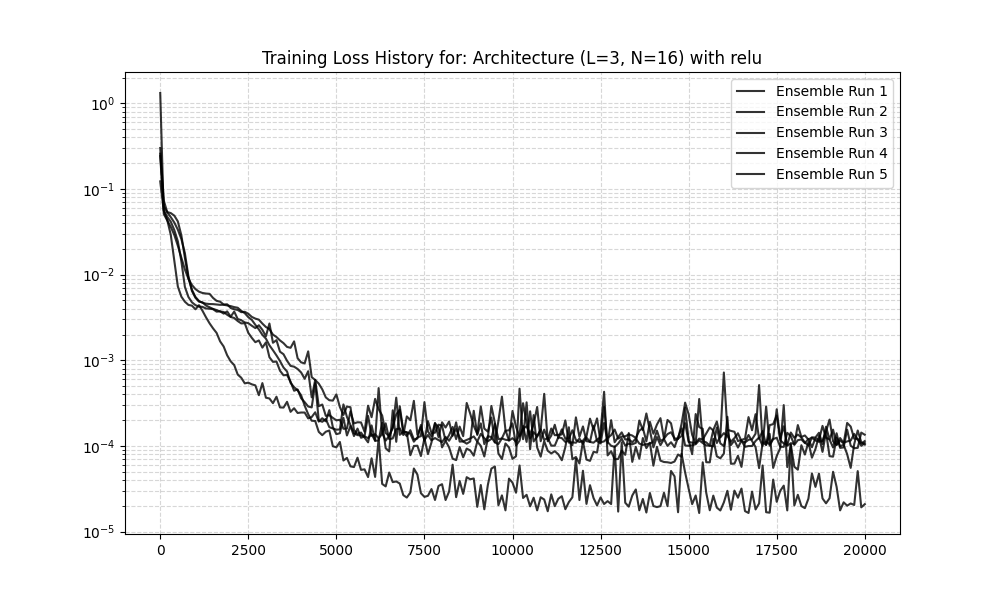

  Avg Final Loss: 0.000096
  Std Dev of Loss: 0.000039

Testing Activation Function: softplus


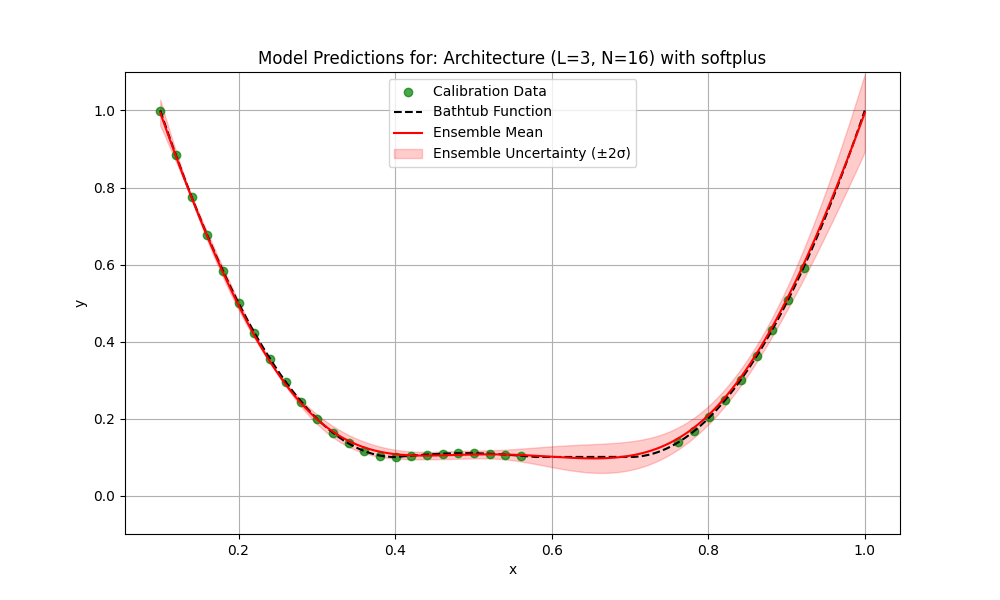

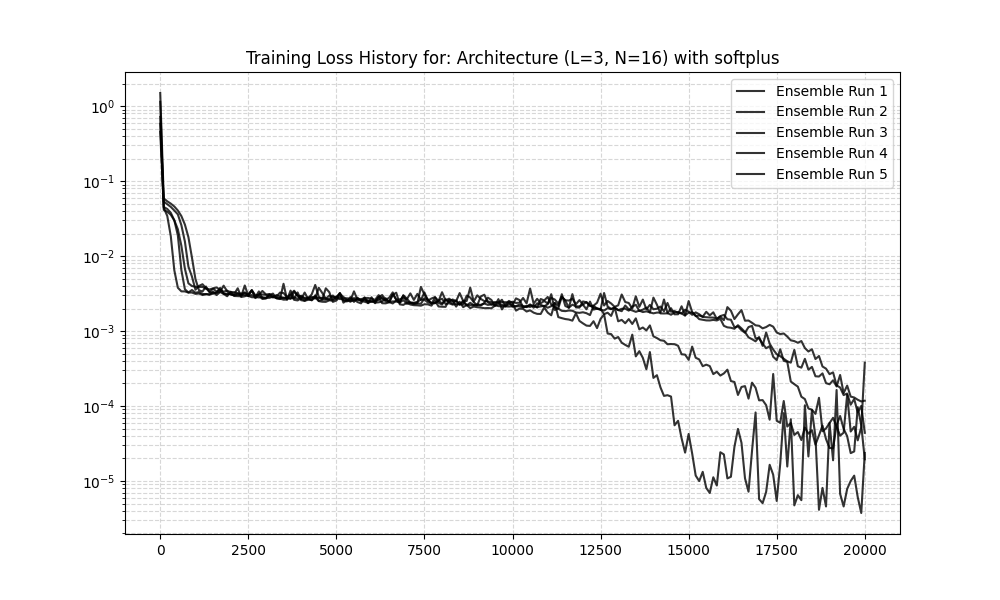

  Avg Final Loss: 0.000117
  Std Dev of Loss: 0.000136

Testing Activation Function: sigmoid


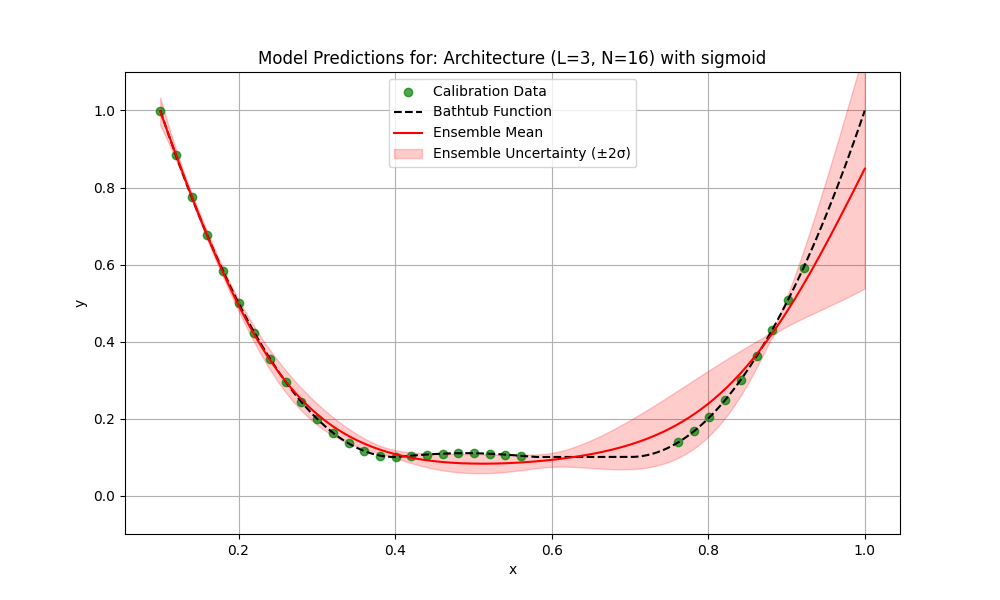

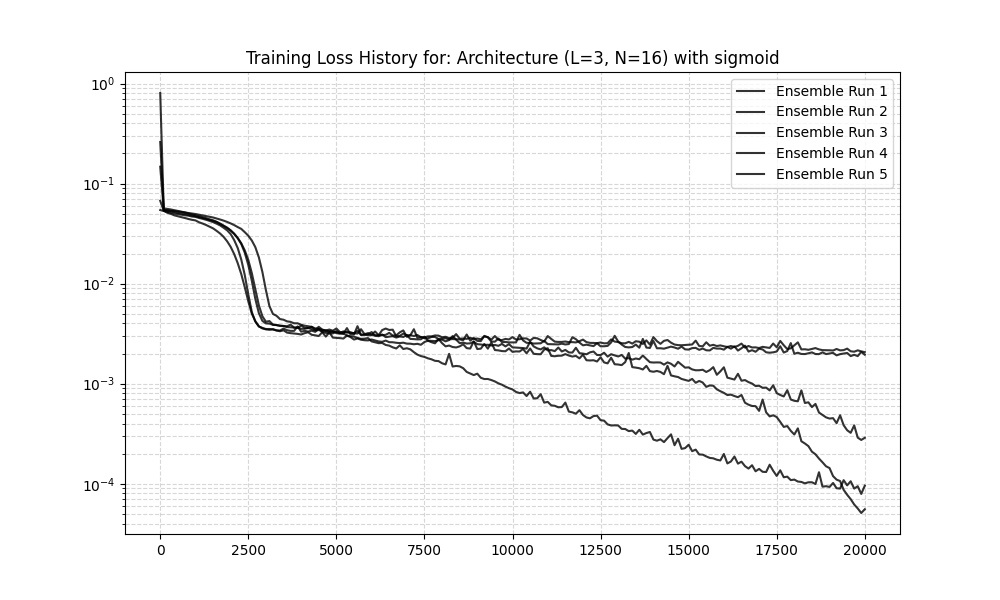

  Avg Final Loss: 0.000891
  Std Dev of Loss: 0.000916



In [ ]:
# --- Fixed Hyperparameters for Section 3 ---
FIXED_NUM_LAYERS = 3    
FIXED_NUM_NODES = 16   
FIXED_NUM_STEPS = 20000

# These are the same as before
LEARNING_RATE = 1e-3
ENSEMBLE_SIZE = 5
BATCH_SIZE = 32

# --- Parameters to Vary ---
# As per the task description 
activations_to_test = [
    jax.nn.relu,
    jax.nn.softplus,
    jax.nn.sigmoid
]

results_sec3 = {}

# --- Main Loop ---
# We just loop over the list of activation functions
for act_fn in activations_to_test:
    
    act_name = act_fn.__name__  # This will give "relu", "softplus", etc.
    print(f"==============================================")
    print(f"Testing Activation Function: {act_name}")
    print(f"==============================================")
    
    final_losses = []
    trained_ensemble = []
    ensemble_histories = []

    # Ensemble loop (identical to previous sections)
    for i in range(ENSEMBLE_SIZE):
        master_key, model_key, train_key = jrandom.split(master_key, 3)

        # Build the model using the fixed architecture
        model = tm.build(
            key=model_key, input_dim="scalar", output_dim="scalar",
            num_hidden_layers=FIXED_NUM_LAYERS,
            nodes_per_layer=FIXED_NUM_NODES,
            activations=act_fn  # <-- Pass the activation function
        )
        
        # Train the model using the fixed step count
        trained_model, history = tm.train_model(
            model, (x_cal, y_cal), train_key,
            steps=FIXED_NUM_STEPS,
            batch_size=BATCH_SIZE,
            learning_rate=LEARNING_RATE
        )
        
        # Append results for this ensemble member
        final_losses.append(history.loss[-1])
        trained_ensemble.append(trained_model)
        ensemble_histories.append(history)
        
    # --- Store quantitative results for this activation function ---
    mean_loss = jnp.mean(jnp.array(final_losses))
    std_loss = jnp.std(jnp.array(final_losses))
    results_sec3[act_name] = (mean_loss, std_loss)
    
    # --- Generate plots for this (arch, step) combo ---
    plot_title = f"Architecture (L={FIXED_NUM_LAYERS}, N={FIXED_NUM_NODES}) with {act_name}"
    td.plot_ensemble_results(trained_ensemble, x, y, x_cal, y_cal, title=plot_title)
    td.plot_ensemble_histories(ensemble_histories, title=plot_title)
    
    # --- Print summary stats ---
    print(f"  Avg Final Training Loss: {mean_loss:.6f}")
    print(f"  Std Dev of Training Loss: {std_loss:.6f}\n")

##### Section 3 - Observations:

With a sufficiently large and deep network (3 Layers, 16 Nodes), the choice of activation function becomes a key factor in capturing the function's detailed, non-convex shape.

**Sigmoid:** This function performs the worst. Its "squashing" nature makes it "too smooth," causing it to completely fail at interpolating the non-convex "bump" at the minimum. The ensemble mean smooths over this detail, resulting in a simple, quadratic-like curve. It also shows the highest uncertainty in the extrapolation region.

**ReLU:** This function successfully captures the non-convex shape at the minimum. Its piecewise-linear nature is evident, as the ensemble mean is slightly less smooth than the softplus model. It provides a very good and stable fit.

**Softplus:** This function provides the best of both worlds and the most accurate fit. It is a smooth function (like Sigmoid) but unbounded (like ReLU). This allows it to capture the subtle non-convexity at the minimum almost perfectly while also providing a smooth, stable, and accurate fit across the entire domain.

### Task 1.2 Input convex neural networks (ICNNs)

For this task we will train a set of standard FFNN and ICNNs to compare the impact of the inductive bias convexity for a small range of architectures. The FFNN will utilize the ReLU activation function, while the ICNN will use the Softplus activation function (with additional constraints for convexit).

*Note, that per task description we will assume that we are trying to model a physical process which we know to be convex. The data generated from the bathtub function is not strictly convex, because of simulated measurement error. This means that deviation of our model from the actual data where the data is not convex does not represent a direct error in the model!*

Architecture 1: L=1, N=4

Architecture 2: L=2, N=8

Architecture 3: L=3, N=16

Testing Architecture: L=1, N=4
--- Processing: L=1, N=4 with FFNN (ReLU) ---


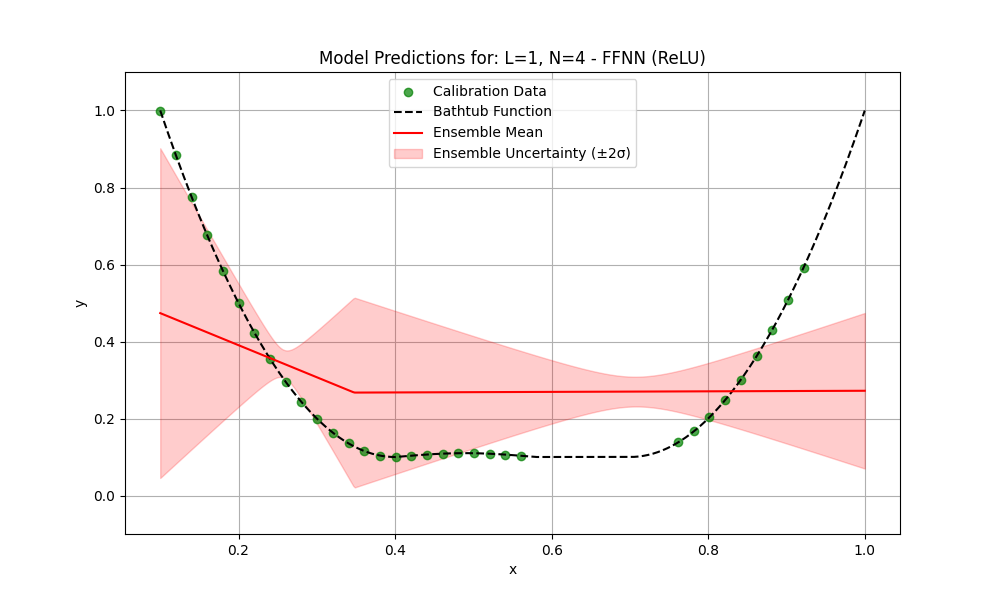

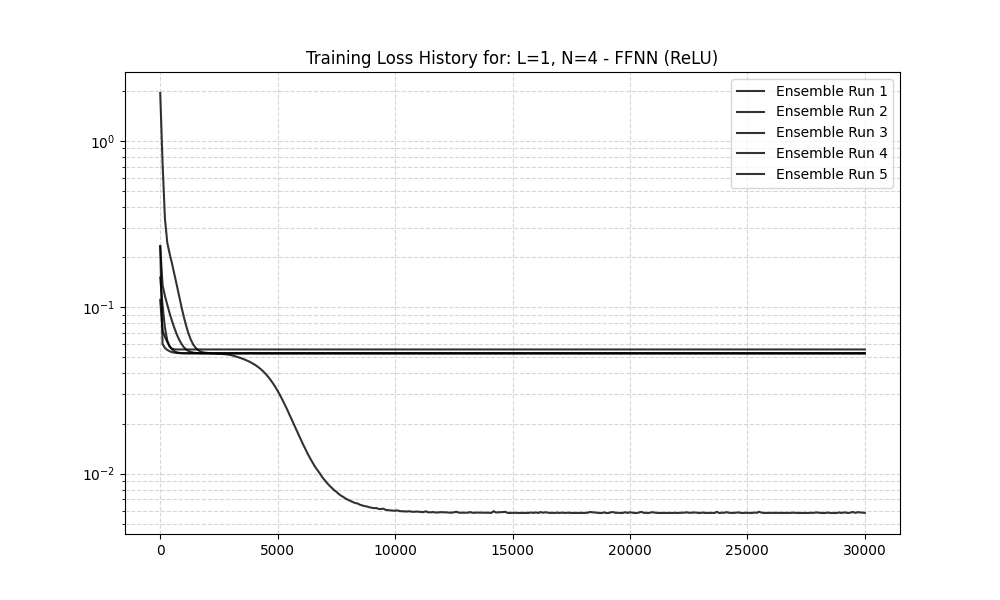

  Avg Final Loss: 0.044040
  Std Dev of Loss: 0.019147

--- Processing: L=1, N=4 with ICNN (Softplus) ---


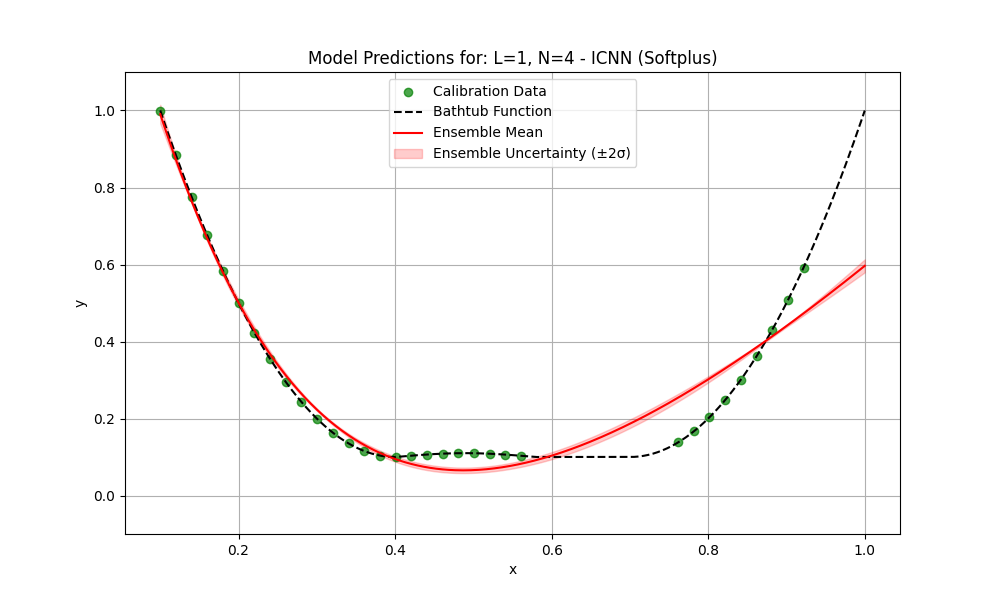

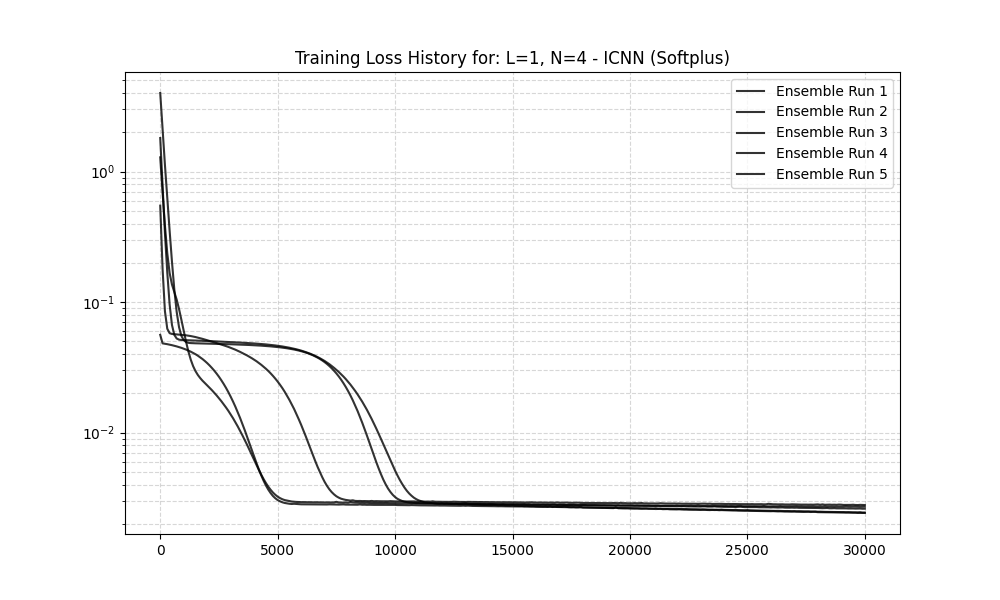

  Avg Final Loss: 0.002594
  Std Dev of Loss: 0.000144

Testing Architecture: L=2, N=8
--- Processing: L=2, N=8 with FFNN (ReLU) ---


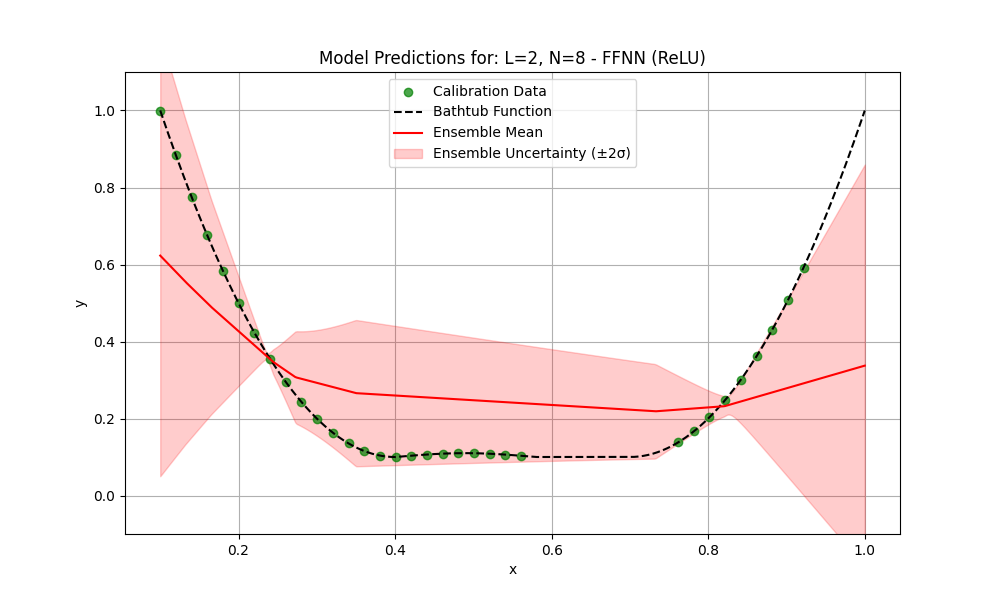

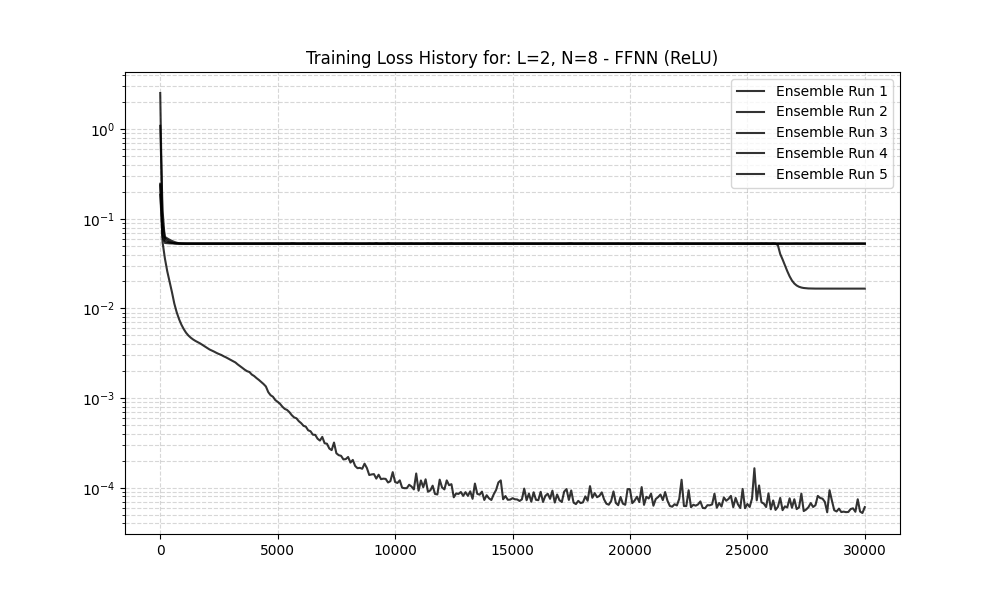

  Avg Final Loss: 0.035078
  Std Dev of Loss: 0.022439

--- Processing: L=2, N=8 with ICNN (Softplus) ---


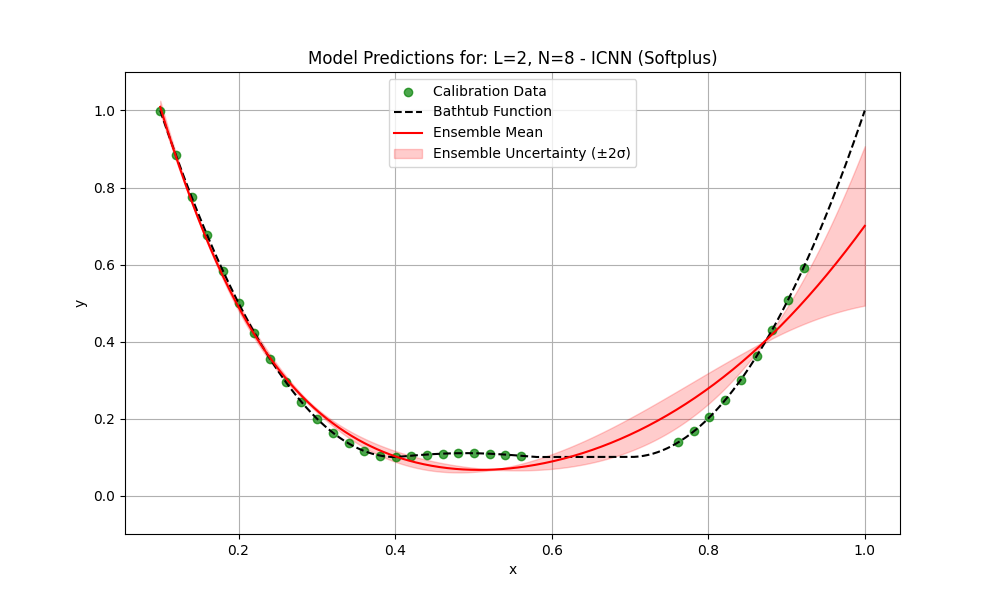

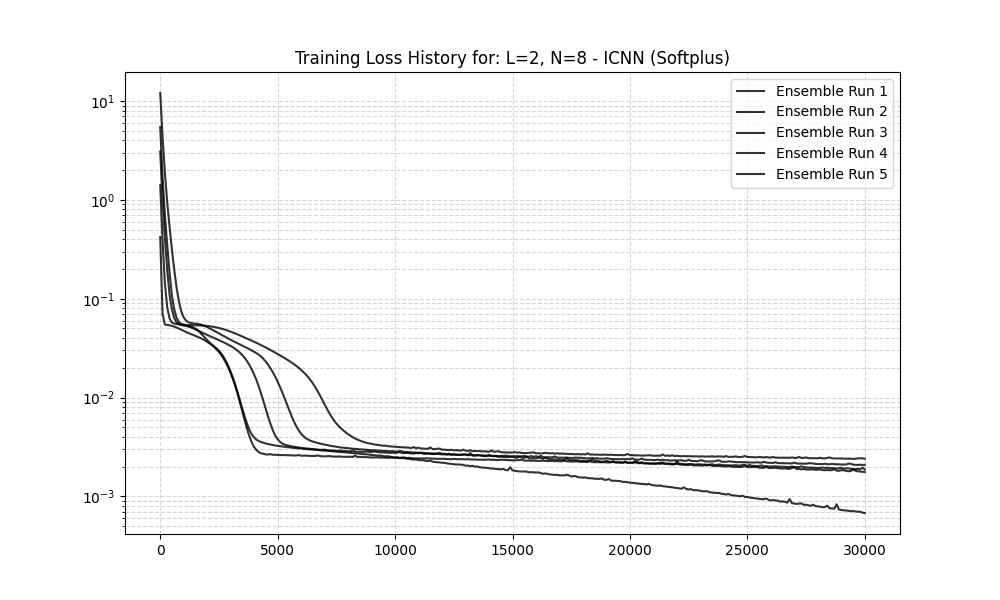

  Avg Final Loss: 0.001765
  Std Dev of Loss: 0.000584

Testing Architecture: L=3, N=16
--- Processing: L=3, N=16 with FFNN (ReLU) ---


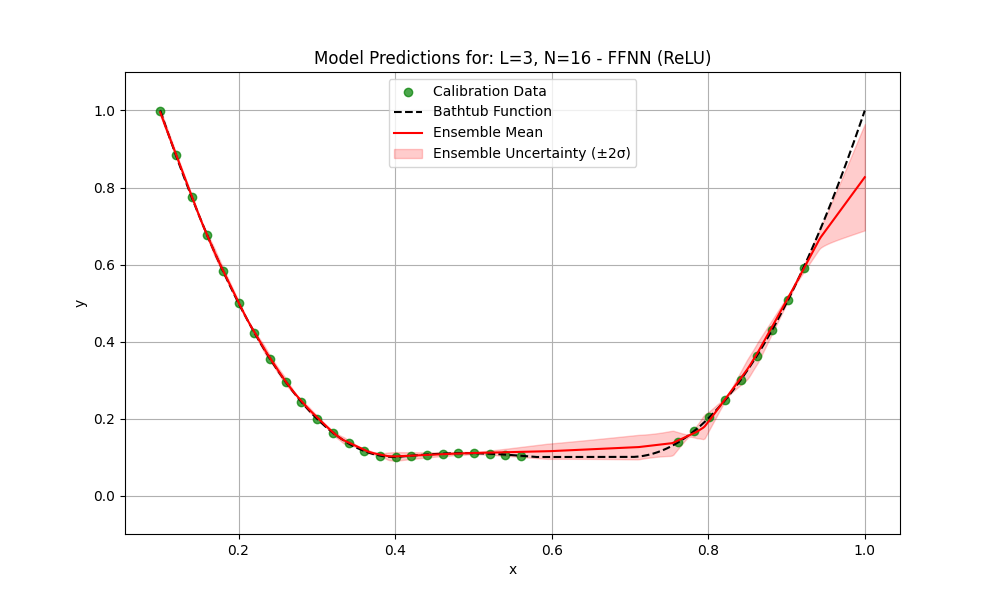

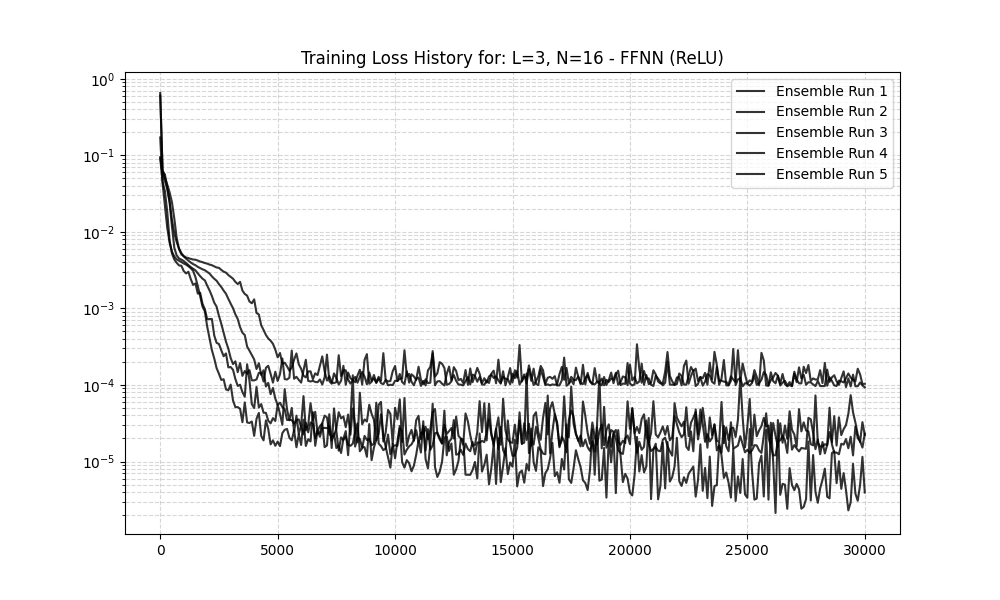

  Avg Final Loss: 0.000049
  Std Dev of Loss: 0.000041

--- Processing: L=3, N=16 with ICNN (Softplus) ---


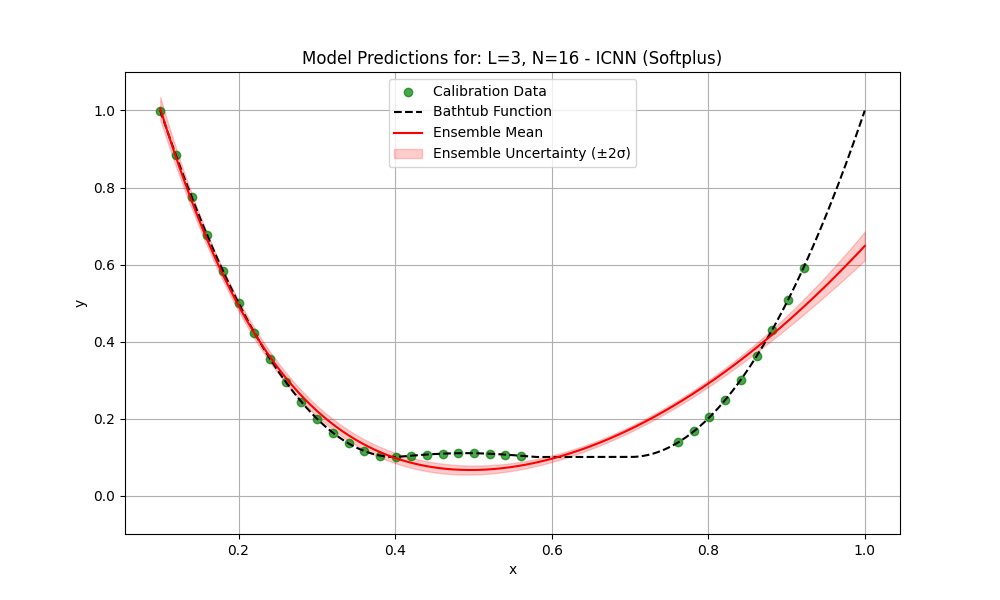

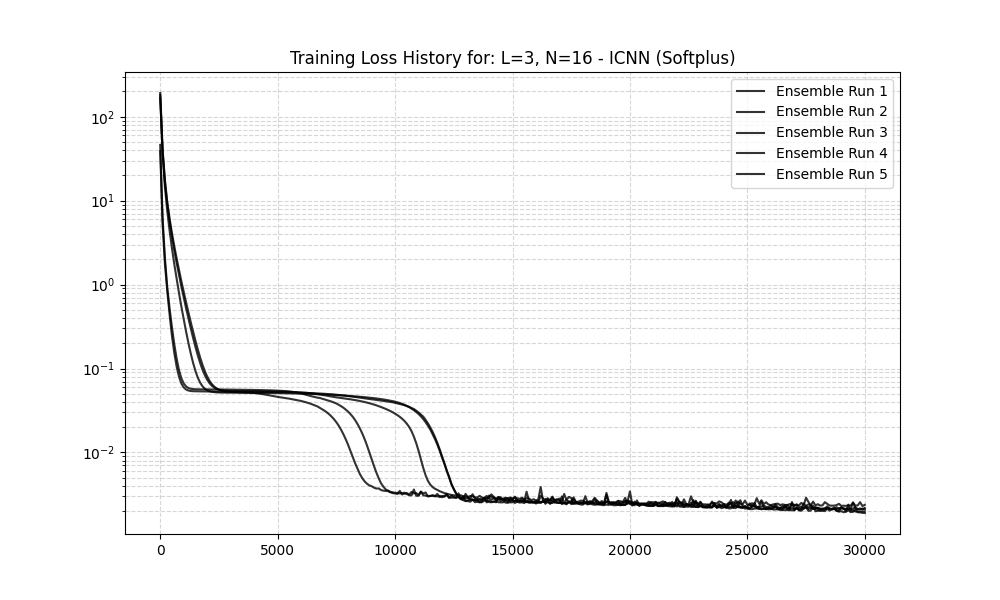

  Avg Final Loss: 0.002110
  Std Dev of Loss: 0.000165

--- Task 1.2 Sweep Complete ---


In [ ]:
# --- Fixed Hyperparameters for Task 1.2 ---
NUM_STEPS = 30000
LEARNING_RATE = 1e-3
ENSEMBLE_SIZE = 5
BATCH_SIZE = 32

# 1. Define architectures
architectures_to_test = [
    {"name": "L=1, N=4", "layers": 1, "nodes": 4},
    {"name": "L=2, N=8", "layers": 2, "nodes": 8},
    {"name": "L=3, N=16", "layers": 3, "nodes": 16}
]

# 2. Define model configurations
model_configs_to_test = [
    {
        "name": "FFNN (ReLU)",
        "activation": jax.nn.relu,
        "is_icnn": False
    },
    {
        "name": "ICNN (Softplus)",
        "activation": jax.nn.softplus,
        "is_icnn": True
    }
]

results_task_1_2 = {}

# --- Main Loop ---
# Outer loop: Iterate over the 3 architectures
for arch in architectures_to_test:
    arch_name = arch['name']
    print(f"==============================================")
    print(f"Testing Architecture: {arch_name}")
    print(f"==============================================")
    results_task_1_2[arch_name] = {}

    # Inner loop: Iterate over the 3 model types (FFNN, ICNN-Softplus, ICNN-ReLU)
    for config in model_configs_to_test:
        config_name = config['name']
        print(f"--- Processing: {arch_name} with {config_name} ---")
        
        final_losses = []
        trained_ensemble = []
        ensemble_histories = []

        # Ensemble loop (identical to Section 1)
        for i in range(ENSEMBLE_SIZE):
            master_key, model_key, train_key = jrandom.split(master_key, 3)

            # Build the model using our flexible build function from models.py
            model = tm.build(
                key=model_key,
                input_dim="scalar",
                output_dim="scalar",
                num_hidden_layers=arch['layers'],
                nodes_per_layer=arch['nodes'],
                activations=config['activation'],
                constrain_icnn_weights=config['is_icnn']
            )
            
            # Train the model
            trained_model, history = tm.train_model(
                model, (x_cal, y_cal), train_key,
                steps=NUM_STEPS,
                batch_size=BATCH_SIZE,
                learning_rate=LEARNING_RATE
            )
            
            # Append results for this ensemble member
            final_losses.append(history.loss[-1])
            trained_ensemble.append(trained_model)
            ensemble_histories.append(history)
            
        # --- Store quantitative results for this (arch, config) combo ---
        mean_loss = jnp.mean(jnp.array(final_losses))
        std_loss = jnp.std(jnp.array(final_losses))
        results_task_1_2[arch_name][config_name] = (mean_loss, std_loss)
        
        # --- Generate plots for this (arch, config) combo ---
        plot_title = f"{arch_name} - {config_name}"
        td.plot_ensemble_results(trained_ensemble, x, y, x_cal, y_cal, title=plot_title)
        td.plot_ensemble_histories(ensemble_histories, title=plot_title)
        
        # --- Print summary stats ---
        print(f"  Avg Final Training Loss: {mean_loss:.6f}")
        print(f"  Std Dev of Training Loss: {std_loss:.6f}\n")

#### Task 1.2 - Observations:

**Low-Capacity Models:** The ICNN's inductive bias is its greatest strength. The simple 1-layer, 4-node ICNN immediately finds a reasonable convex "U" shape, which is a good prior for this problem. In contrast, the 1-layer, 4-node FFNN, lacking this bias, fails completely and predicts a flat, under-fit line.

**High-Capacity Models & Overfitting:** As complexity increases, the 3-layer, 16-node FFNN becomes flexible enough to achieve a near-perfect visual fit. However, this flexibility is a flaw: it "overfits" to the non-physical, non-convex noise in the data, perfectly capturing the "bump" at the bottom.

**The Power of Inductive Bias:** The ICNN, by design, cannot overfit to this non-convex noise. All ICNN architectures correctly ignore the "bump" and produce a smooth, physically-plausible convex curve through the minimum. This is their key advantage: guaranteeing physical constraints at the expense of a perfect fit to flawed data.

**Extrapolation Trade-off:** The high-capacity FFNN (3L/16N) excels at extrapolating the steep curve on the right-hand side, matching the true function almost perfectly. The ICNN (3L/16N) is less flexible and under-fits this extrapolation, finding a simpler convex curve that still fits the calibration data well but doesn't capture the true nature. This highlights the core trade-off: the FFNN is more "accurate" but physically "unsafe," while the ICNN is physically "safe" but less flexible.

#### Task 1.2 - Using other activation functions for ICNNs:
This should be possible as long as the activation functions satisfy the requirements for ICNNs given in the task description:

• Convex activation functions in the first hidden layer.

• Convex and non-decreasing activation functions in every subsequent hidden layer.

## Task 2

### Task 2.0 Two-dimensional functions

#### Task 2.0 - Observations:

- The standard model we used was a function mapping a scalar (Input shape `()` ) to a scalar (Output shape `()`).
- If we adjust the input to be two dimensional and the target value remains one dimensional this would become a function taking in a vector (Input shape (2, )) and outputting a scalar (Output shape `()`).
- Since we adapted the Model class in the models.py module by parametrizing it, we can flexibly change these dimensions by adjusting the parameters "input_dim" and "output_dim" when calling the tm.build() function.

*Note: As stated above, no further adjustment of the code is needed at this point since this has already been included when adjusting models.py. The below codecell shows an example of how we could build such a NN using our adjusted Model class.*

In [ ]:
# Create a key for initialization
key = jrandom.PRNGKey(42)

# --- Define Hyperparameters for a 2D -> 1D Model ---
INPUT_DIM = 2
OUTPUT_DIM = "scalar"
NUM_LAYERS = 3
NUM_NODES = 16

# --- Build the model ---
# We use the exact same build function as before,
# just with input_dim=2.
model_2d = tm.build(
    key=key,
    input_dim=INPUT_DIM,
    output_dim=OUTPUT_DIM,
    num_hidden_layers=NUM_LAYERS,
    nodes_per_layer=NUM_NODES,
    activations=jnn.softplus
)

# --- Print the results ---
print(f"Successfully built a {INPUT_DIM}D-to-{OUTPUT_DIM}D model:")
print(model_2d)

print("\n--- Verifying Layer Dimensions ---")
print(f"First layer weights shape: {model_2d.layers[0].weight.shape}")
print(f"Expected shape: (input_dim, nodes) = ({INPUT_DIM}, {NUM_NODES})")

print(f"\nFinal layer weights shape: {model_2d.layers[-1].weight.shape}")
print(f"Expected shape: (nodes, output_dim) = ({NUM_NODES}, {OUTPUT_DIM})")

Successfully built a 2D-to-1D model:
Model(
  layers=(
    Linear(
      weight=f32[2,16],
      bias=f32[16],
      in_features=2,
      out_features=16,
      use_bias=True
    ),
    Linear(
      weight=f32[16,16],
      bias=f32[16],
      in_features=16,
      out_features=16,
      use_bias=True
    ),
    Linear(
      weight=f32[16,16],
      bias=f32[16],
      in_features=16,
      out_features=16,
      use_bias=True
    ),
    Linear(
      weight=f32[16,1],
      bias=f32[1],
      in_features=16,
      out_features=1,
      use_bias=True
    )
  ),
  activations=(
    <PjitFunction of <function softplus at 0x000001D9FB717420>>,
    <PjitFunction of <function softplus at 0x000001D9FB717420>>,
    <PjitFunction of <function softplus at 0x000001D9FB717420>>,
    <function build.<locals>.<lambda>>
  )
)

--- Verifying Layer Dimensions ---
First layer weights shape: (2, 16)
Expected shape: (input_dim, nodes) = (2, 16)

Final layer weights shape: (16, 1)
Expected shape: (nodes

### Task 2.1 Data generation

The adjustment of this task is performed directly in the data.py module. Below we show a plot of the newly generated data.

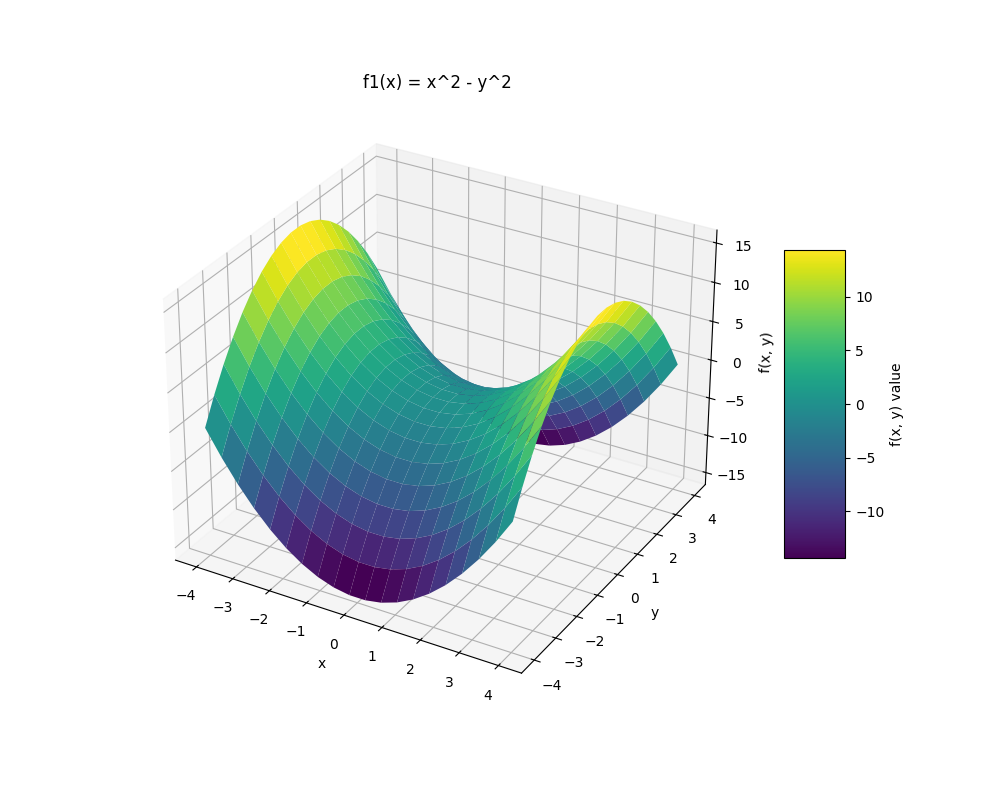

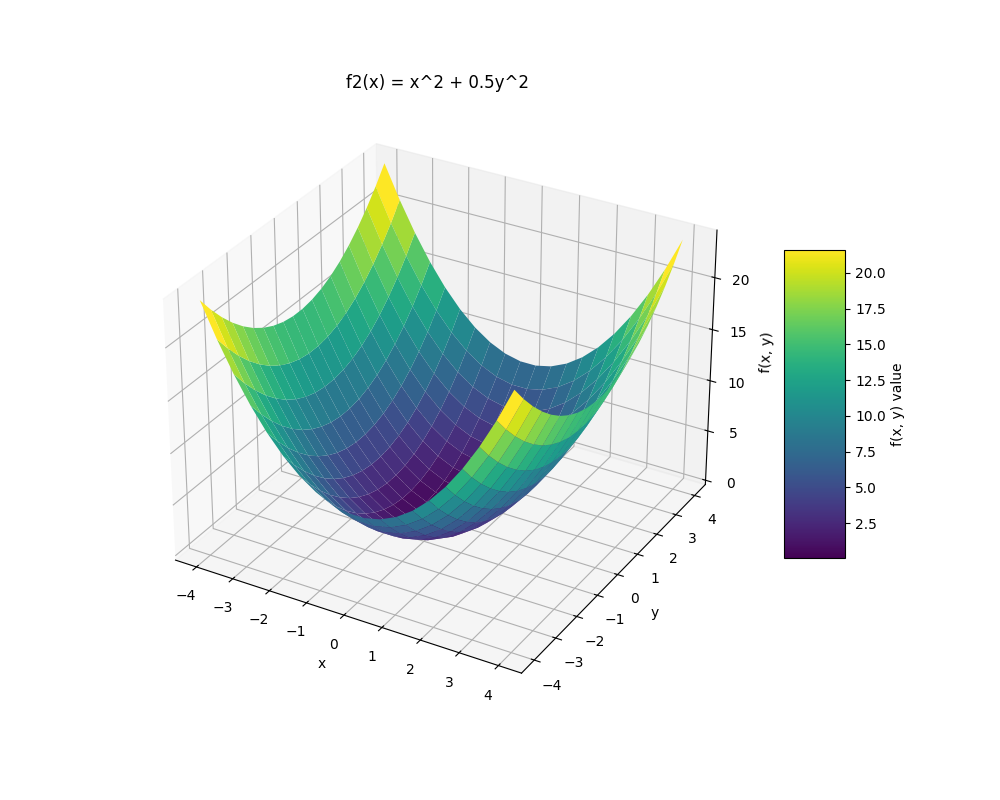

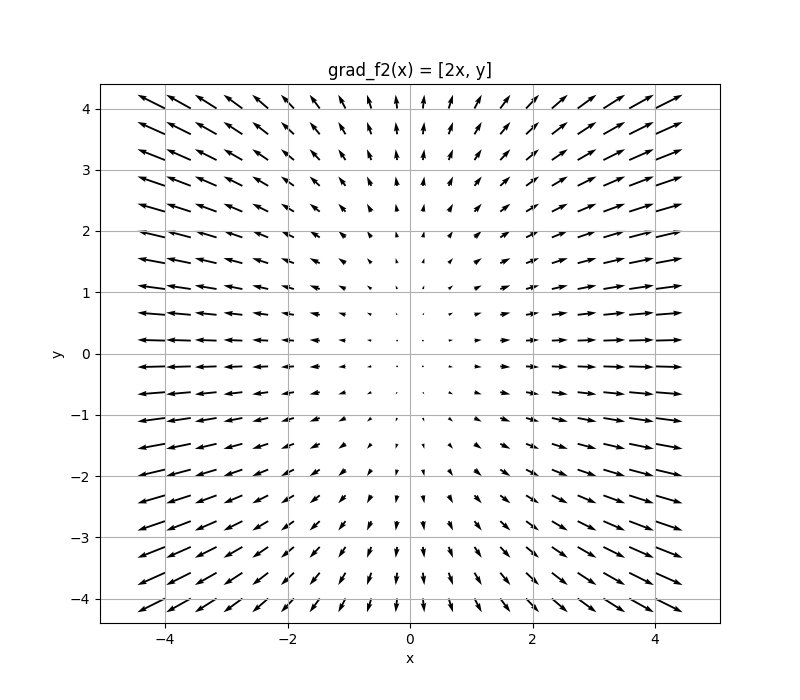

In [4]:
# --- Generate and plot f1 ---
x_data, f1_data, xx, yy, f1_grid, x_cal, y_cal = td.f1() # Data generation function for f1 from data.py
td.plot_3d_surface(xx, yy, f1_grid, title="f1(x) = x^2 - y^2") # Helper plotting function from data.py

# --- Generate and plot f2 ---
# (No need to regenerate x_data, but f2() does it for simplicity)
_, f2_data, xx, yy, f2_grid, x_cal, y_cal = td.f2() # Data generation function for f2 from data.py
td.plot_3d_surface(xx, yy, f2_grid, title="f2(x) = x^2 + 0.5y^2") # Helper plotting function from data.py

# --- Generate and plot grad_f2 ---
_, grad_f2_data, xx, yy, grad_x_grid, grad_y_grid, x_cal, y_cal = td.grad_f2() # Data generation function for gradient of f2 from data.py
td.plot_2d_vector_field(xx, yy, grad_x_grid, grad_y_grid, title="grad_f2(x) = [2x, y]") # Helper plotting function from data.py

### Task 2.2 Trainable custom layer

Here we follow the task description and train a FFNN and a ICNN on the data from f1 and f2. As calibration data we use the 20 equidistant points in each direction as per task description 2.1. By using such a "fine" and uniform sample grid over such simple/ clean data we can only judge the general ability of the two architectures to capture the underlying functions f1 and f2 if given ideal information. This does not give us a more nuanced insight into its interpolation or extrapolation abilit which was a lot easier to investigate in the 1D bathtub function case.

Note that this is a toy example and can only be interpreted to illustrate how the ICNN is highly unsuited to capture any non convex relationships in data because of its reduced flexibility compared to the standard FFNN.

Training on Dataset: f1
--- Processing: f1 with FFNN (ReLU) ---


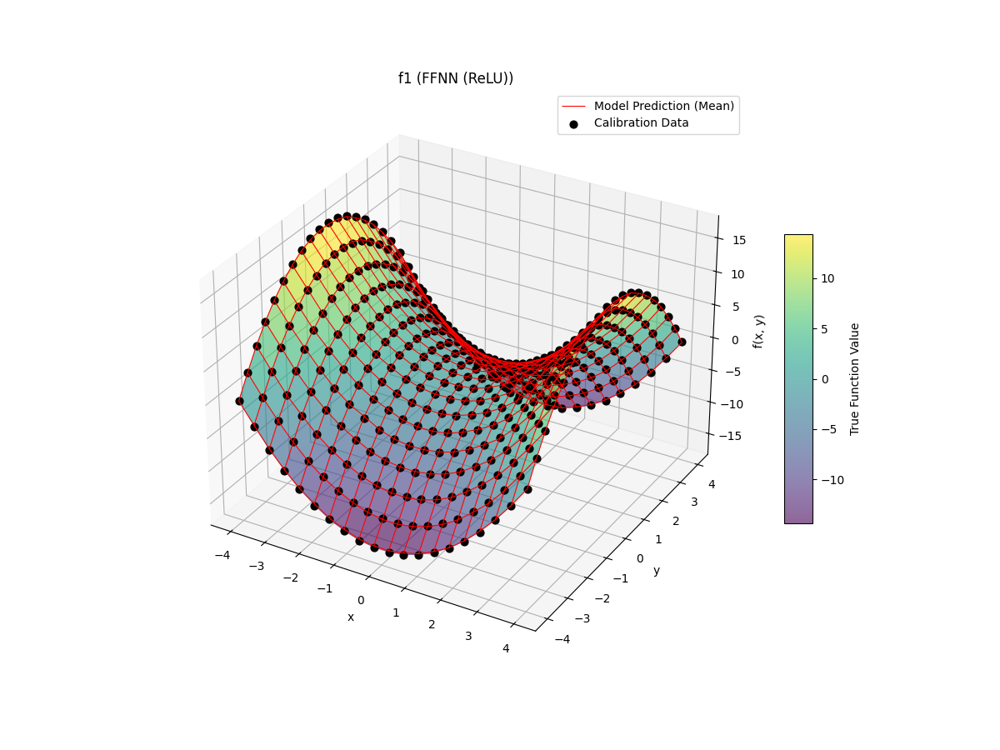

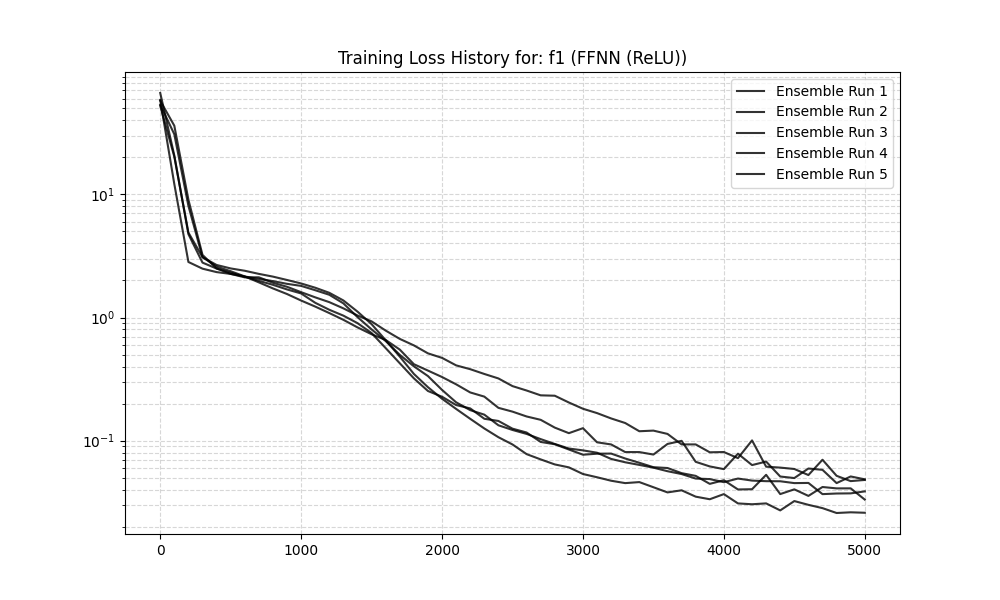

--- Processing: f1 with ICNN (Softplus) ---


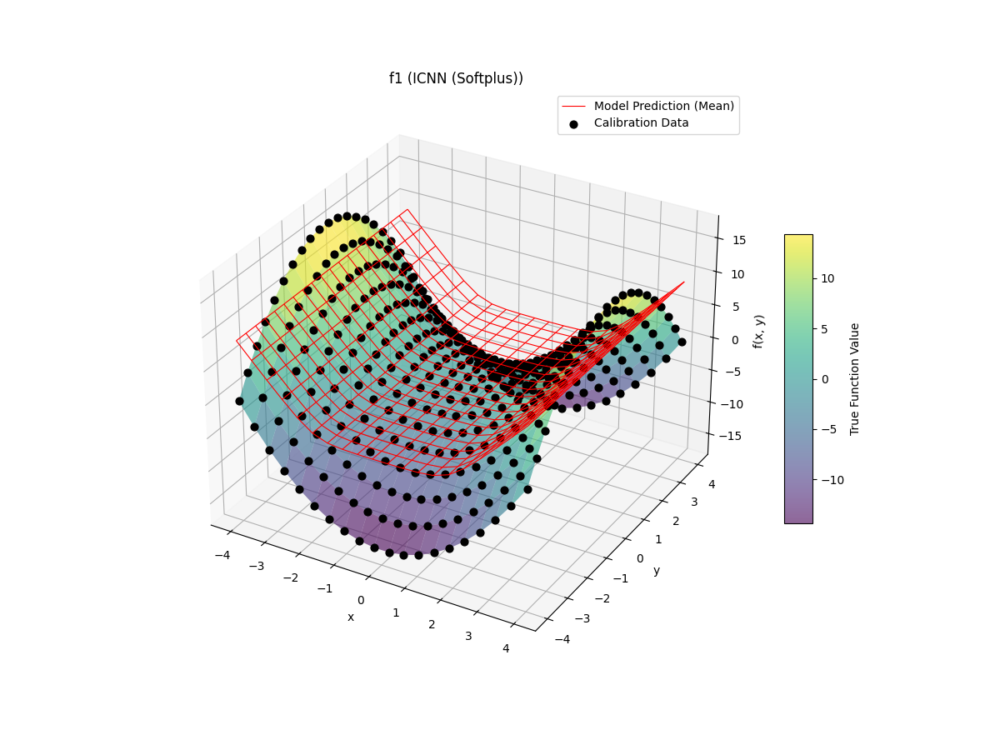

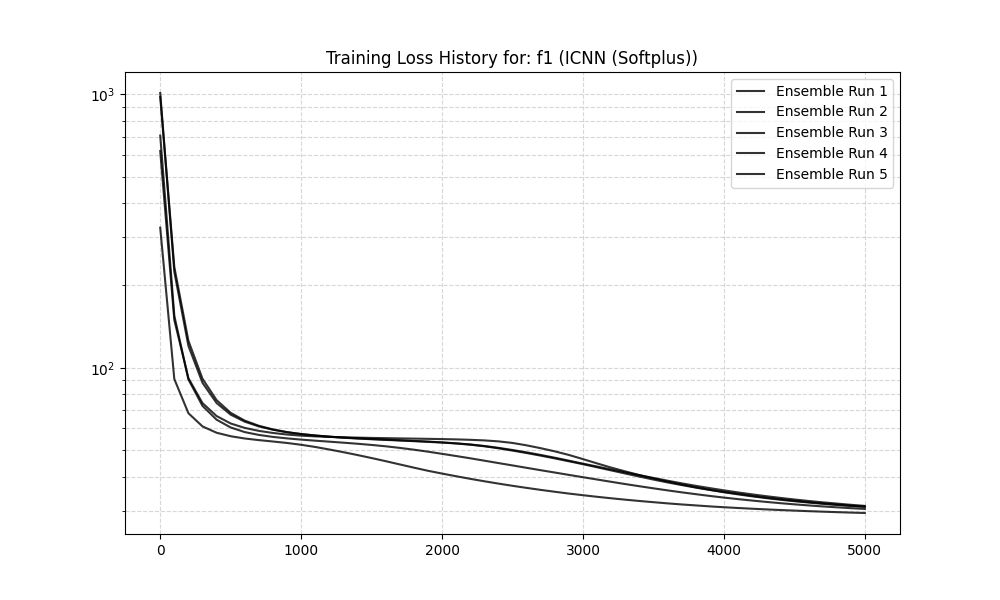

Training on Dataset: f2
--- Processing: f2 with FFNN (ReLU) ---


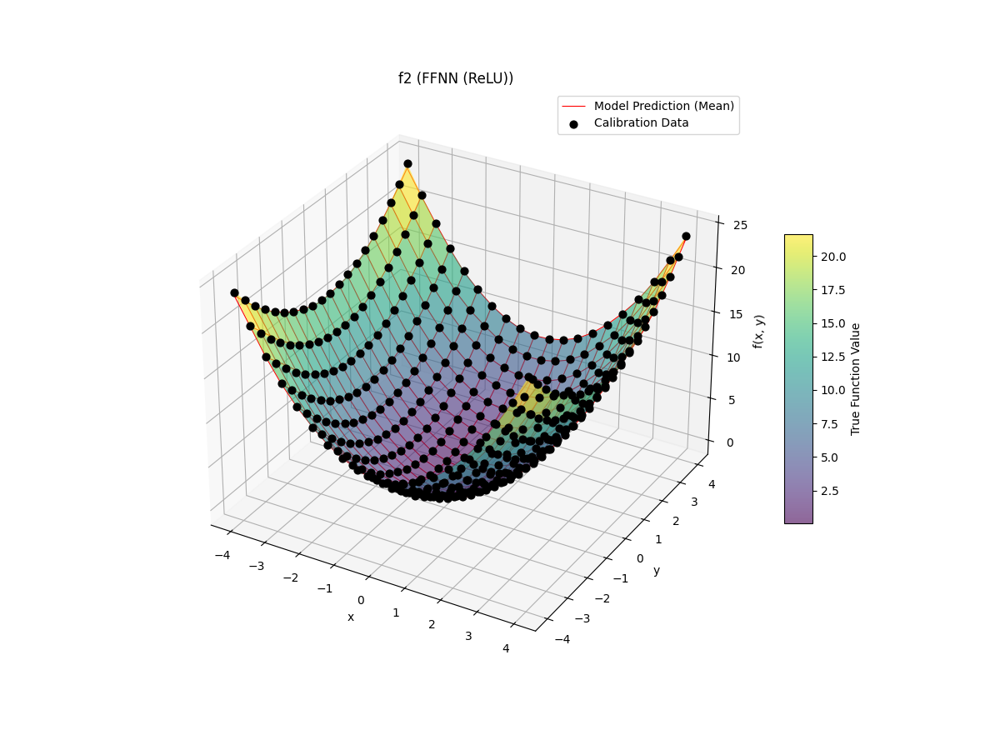

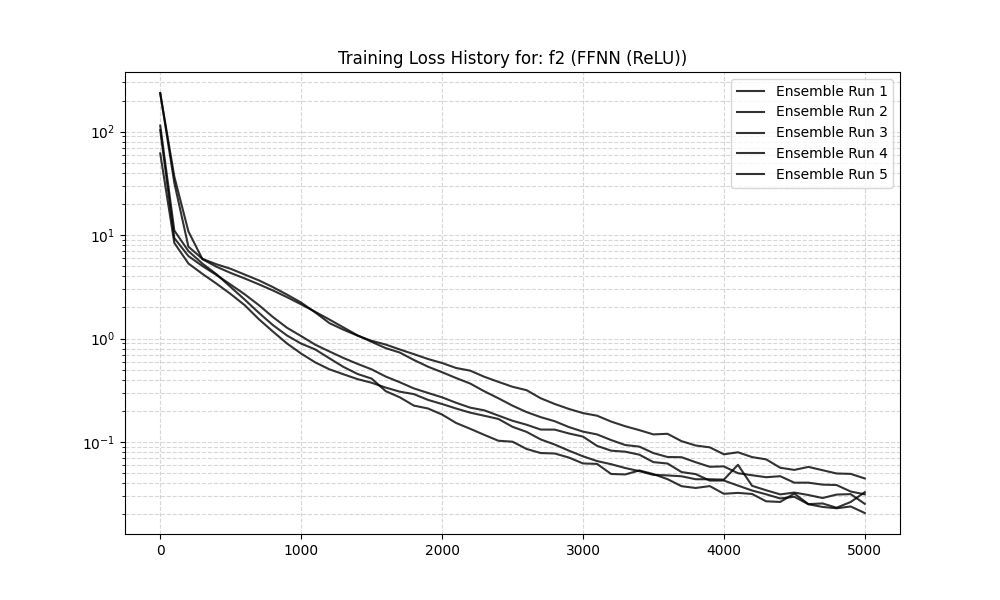

--- Processing: f2 with ICNN (Softplus) ---


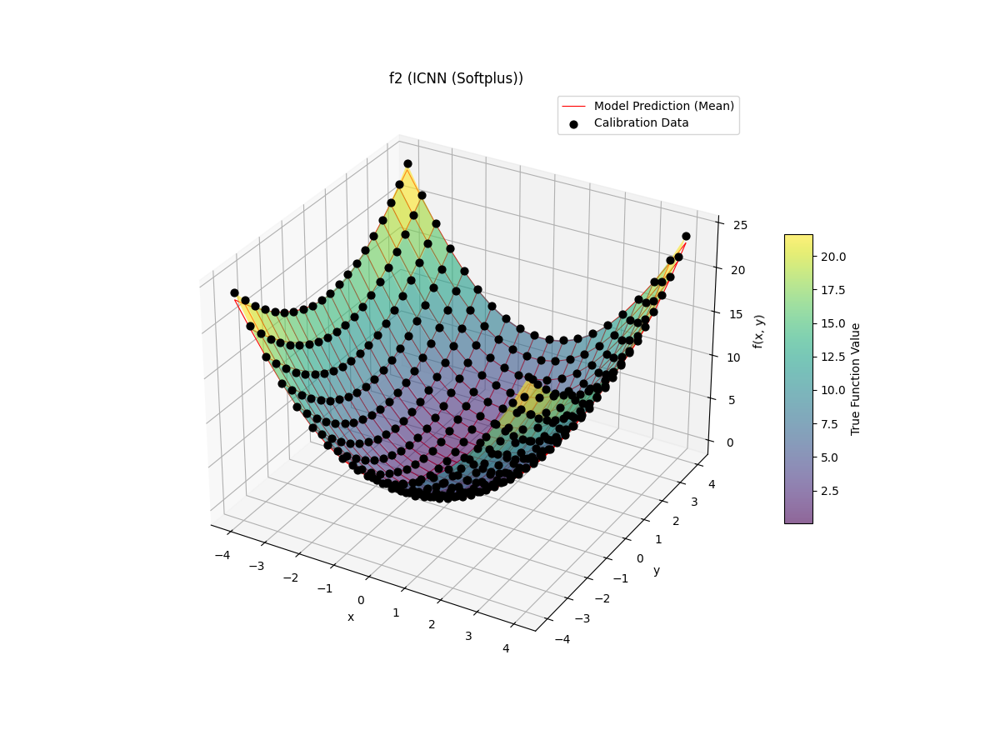

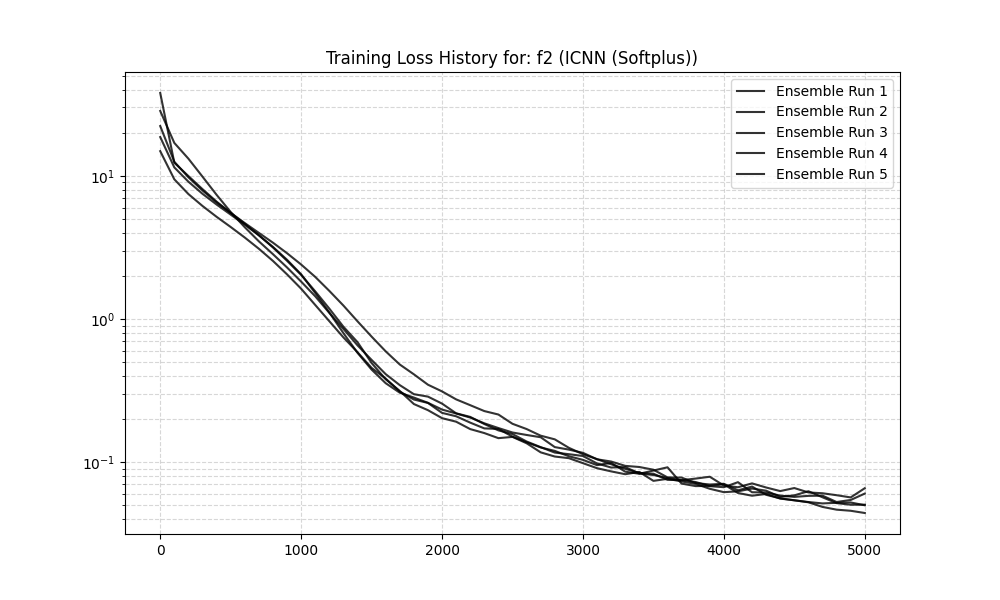

In [5]:
# --- Fixed Hyperparameters ---
FIXED_NUM_LAYERS = 3
FIXED_NUM_NODES = 16
NUM_STEPS = 5000
LEARNING_RATE = 1e-3
ENSEMBLE_SIZE = 5
BATCH_SIZE = 32

datasets_to_test = [
    ("f1", td.f1),
    ("f2", td.f2)
]
model_configs_to_test = [
    {"name": "FFNN (ReLU)", "activation": jax.nn.relu, "is_icnn": False},
    {"name": "ICNN (Softplus)", "activation": jax.nn.softplus, "is_icnn": True}
]

results_task_2_2 = {}

# --- Main Loop ---
for data_name, data_func in datasets_to_test:
    print(f"==============================================")
    print(f"Training on Dataset: {data_name}")
    print(f"==============================================")
    
    # 1. Get both FULL and CALIBRATION data
    (x_data_full, y_data_full, 
     xx, yy, z_true_grid, 
     x_cal, y_cal) = data_func()
    
    results_task_2_2[data_name] = {}

    for config in model_configs_to_test:
        config_name = config['name']
        print(f"--- Processing: {data_name} with {config_name} ---")
        
        final_losses = []
        trained_ensemble = []
        ensemble_histories = []

        for i in range(ENSEMBLE_SIZE):
            master_key, model_key, train_key = jrandom.split(master_key, 3)

            model = tm.build(
                key=model_key, input_dim=2, output_dim=1,
                num_hidden_layers=FIXED_NUM_LAYERS,
                nodes_per_layer=FIXED_NUM_NODES,
                activations=config['activation'],
                constrain_icnn_weights=config['is_icnn']
            )
            
            # 2. Train on the calibration data
            trained_model, history = tm.train_model(
                model, (x_cal, y_cal), train_key,  # <-- Use x_cal, y_cal
                steps=NUM_STEPS,
                batch_size=BATCH_SIZE,
                learning_rate=LEARNING_RATE
            )
            
            final_losses.append(history.loss[-1])
            trained_ensemble.append(trained_model)
            ensemble_histories.append(history)
            
        mean_loss = jnp.mean(jnp.array(final_losses))
        std_loss = jnp.std(jnp.array(final_losses))
        results_task_2_2[data_name][config_name] = (mean_loss, std_loss)
        
        # --- 3. Use the overlay plotter ---
        plot_title = f"{data_name} ({config_name})"
        
        td.plot_3d_overlay(
            xx, yy, z_true_grid,
            trained_ensemble, x_data_full, # <-- Predict on full grid
            x_cal, y_cal,                  # <-- Plot calibration points
            title=plot_title
        )
        
        # Plot training histories (unchanged)
        td.plot_ensemble_histories(ensemble_histories, title=plot_title)

### Task 2.3 Sobolev training

To create the desired model which outputs a prediction and the network's gradient, while also allowing it to learn from gradient data (Sobolev training), we created a new model class in the module models.py called SobolevModel. This is essentially a wrapper which takes an instance of our standard Model class (in this case with ICNN properties) and uses a modified call function to compute the gradient of the network (using jax.grad) when called. This satisfies the two dimensional output requirement. Furthermore, sobolev training is enabled by using the parametrized train_model function from the models.py module which allows us to pass it a custom loss function.

The loss function for sobolev training can be found in the losses.py (implemented as a class) module and has the form:
$$
L_{\text{Sobolev}} = \alpha \cdot L_{\text{val}} + \beta \cdot L_{\text{grad}}
$$

where:
\begin{align*}
L_{\text{val}} &= \frac{1}{N} \sum_{i=1}^{N} (y_i - \hat{y}_i)^2 \\
L_{\text{grad}} &= \frac{1}{N} \sum_{i=1}^{N} \| \mathbf{g}_i - \hat{\mathbf{g}}_i \|_2^2
\end{align*}
This allows us to test all three desired training strategies by simply changing the parameters alpha and beta. Theoretically we could also optimize a weighted training strategy using both the gradient and the function data with weights between 1 and 0 (as alpha and beta values).

--- Starting Task 2.3: Sobolev Training ---
Testing Strategy: f2_only
--- Evaluating: f2_only ---
--- Quantitative Errors for Strategy: f2_only ---
  f(x) Value Prediction (vs. true f2):
    - MSE:      0.000541
    - MAE:      0.018126
    - Median:   0.015252
    - Max:      0.081161
  ∇f(x) Gradient Prediction (vs. true ∇f2):
    - MSE:      0.005945
    - MAE:      0.056319
    - Median:   0.042418
    - Max:      0.393910
--------------------------------------------------



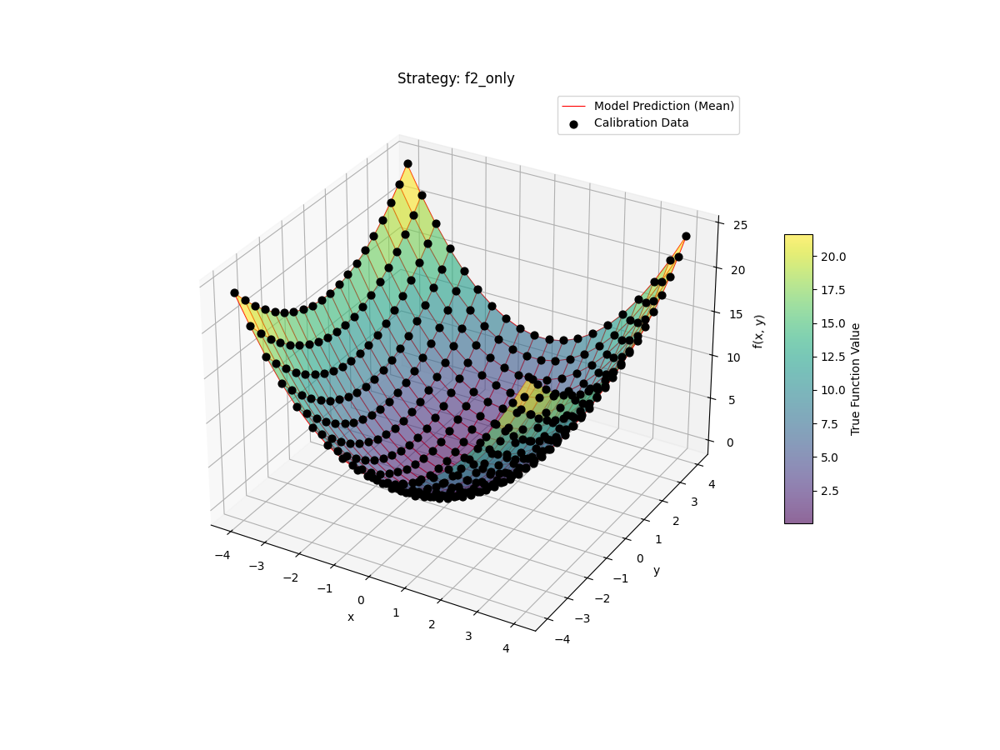

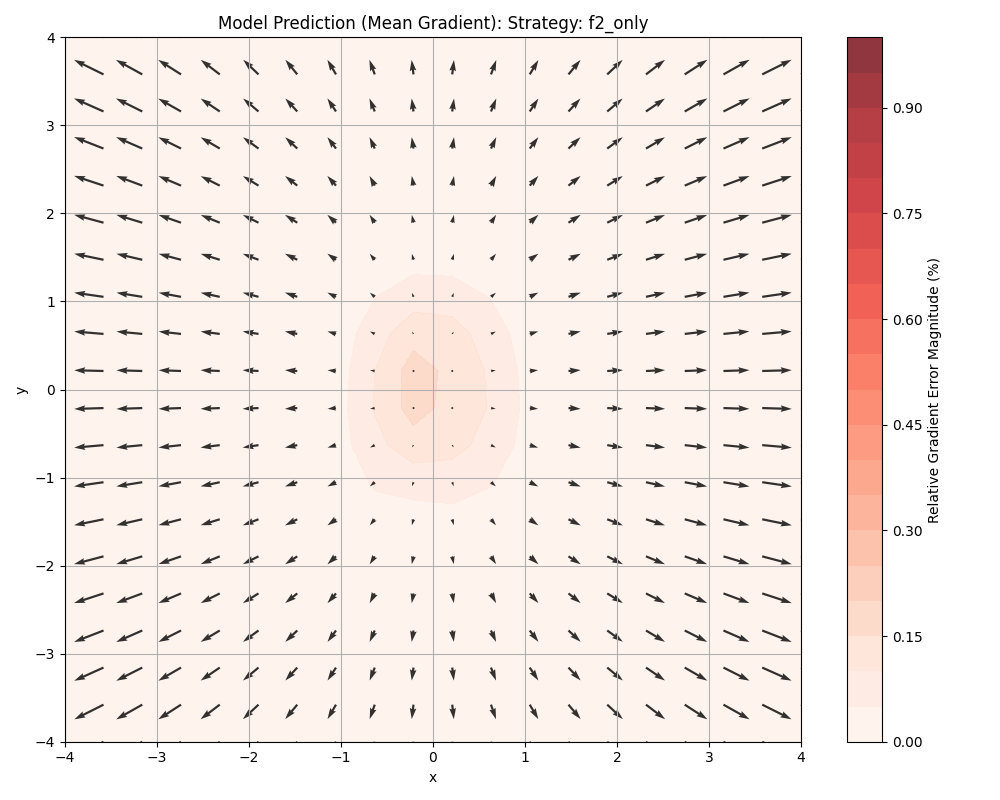

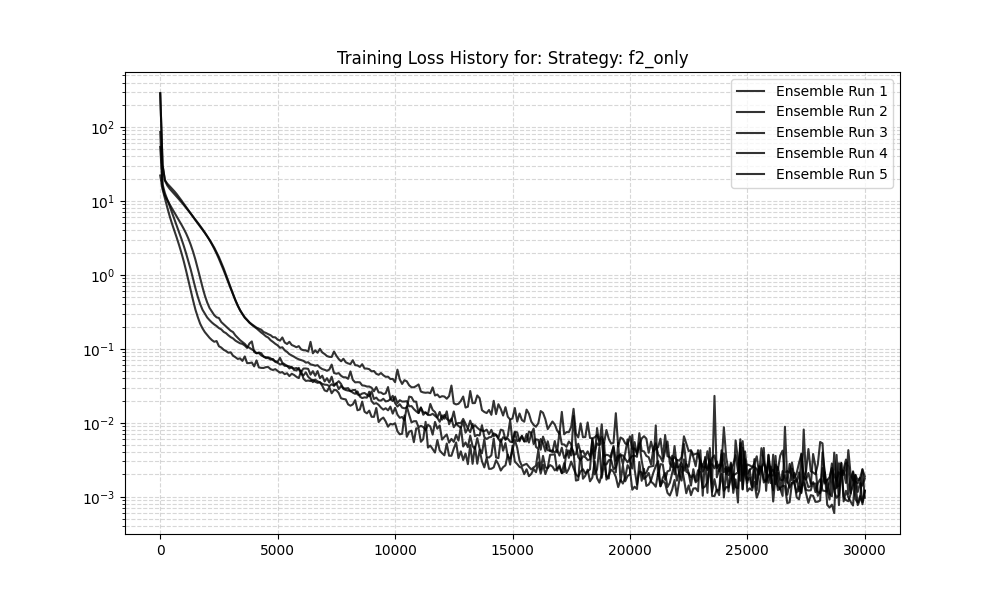

Testing Strategy: f2_and_grad
--- Evaluating: f2_and_grad ---
--- Quantitative Errors for Strategy: f2_and_grad ---
  f(x) Value Prediction (vs. true f2):
    - MSE:      0.000633
    - MAE:      0.020525
    - Median:   0.016372
    - Max:      0.070574
  ∇f(x) Gradient Prediction (vs. true ∇f2):
    - MSE:      0.000310
    - MAE:      0.014907
    - Median:   0.013037
    - Max:      0.057983
--------------------------------------------------



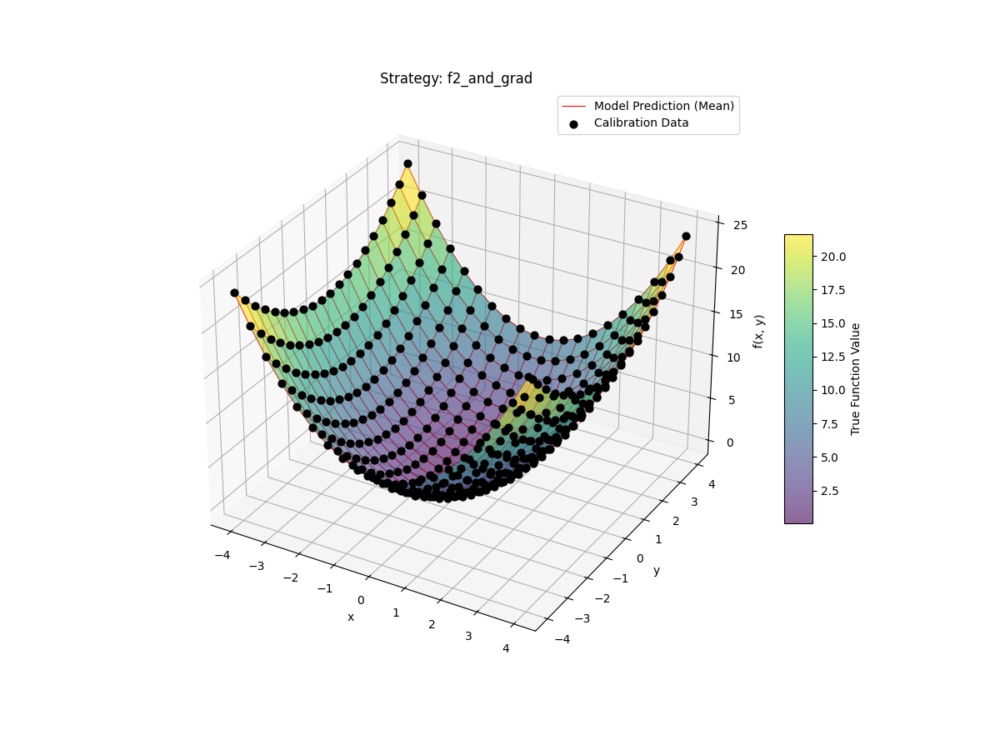

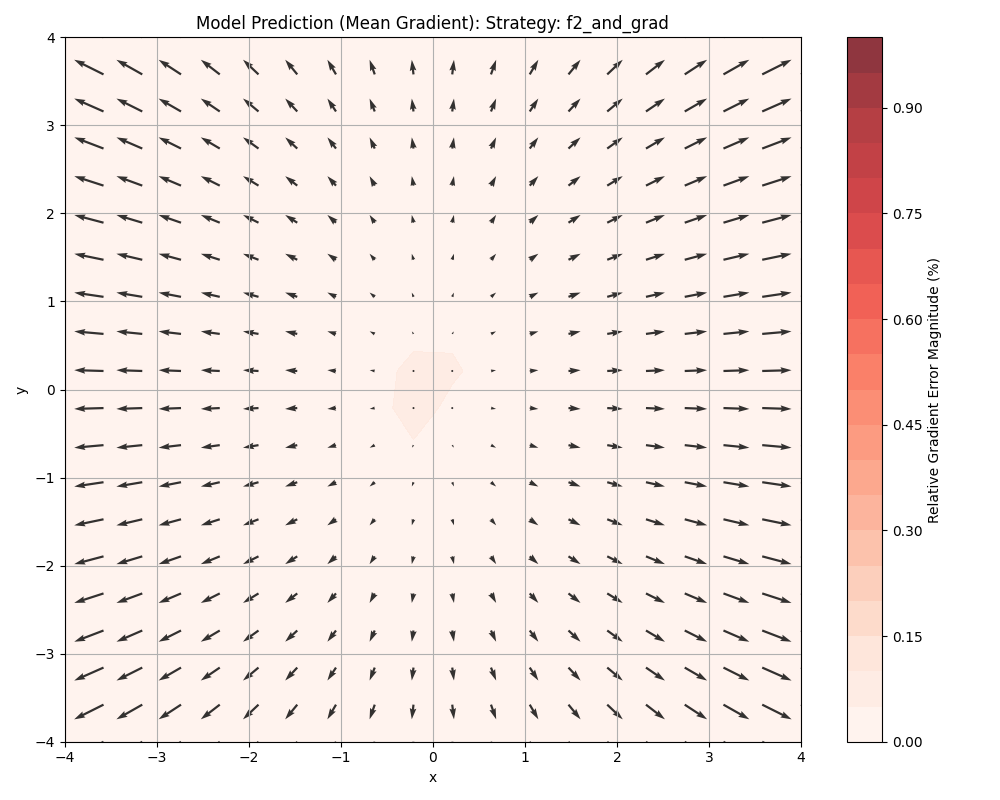

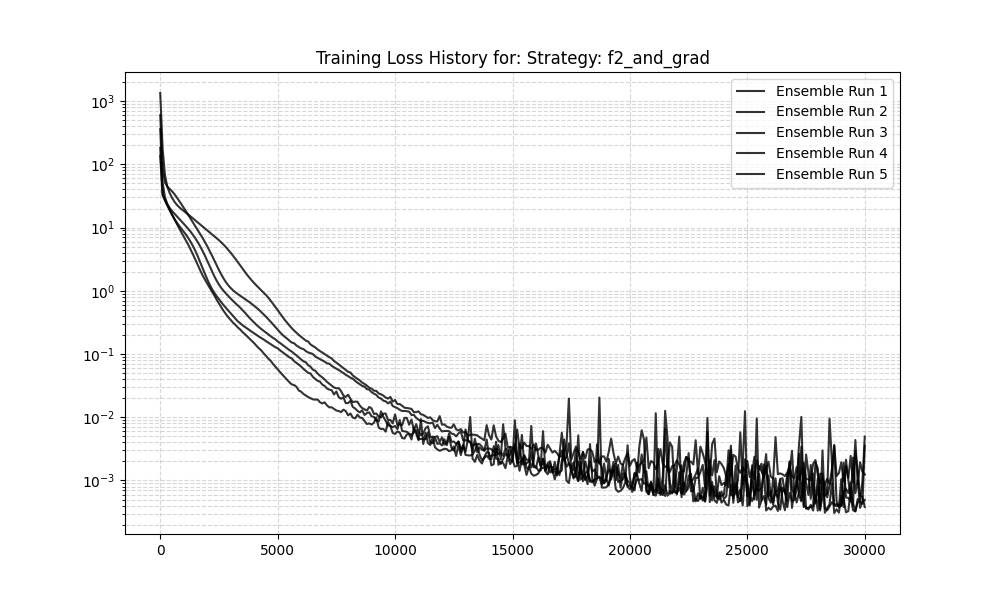

Testing Strategy: grad_only
--- Evaluating: grad_only ---
--- Quantitative Errors for Strategy: grad_only ---
  f(x) Value Prediction (vs. true f2):
    - MSE:    108.467567
    - MAE:     10.414773
    - Median:  10.412470
    - Max:     10.443741
  ∇f(x) Gradient Prediction (vs. true ∇f2):
    - MSE:      0.000043
    - MAE:      0.005581
    - Median:   0.005022
    - Max:      0.017473
--------------------------------------------------



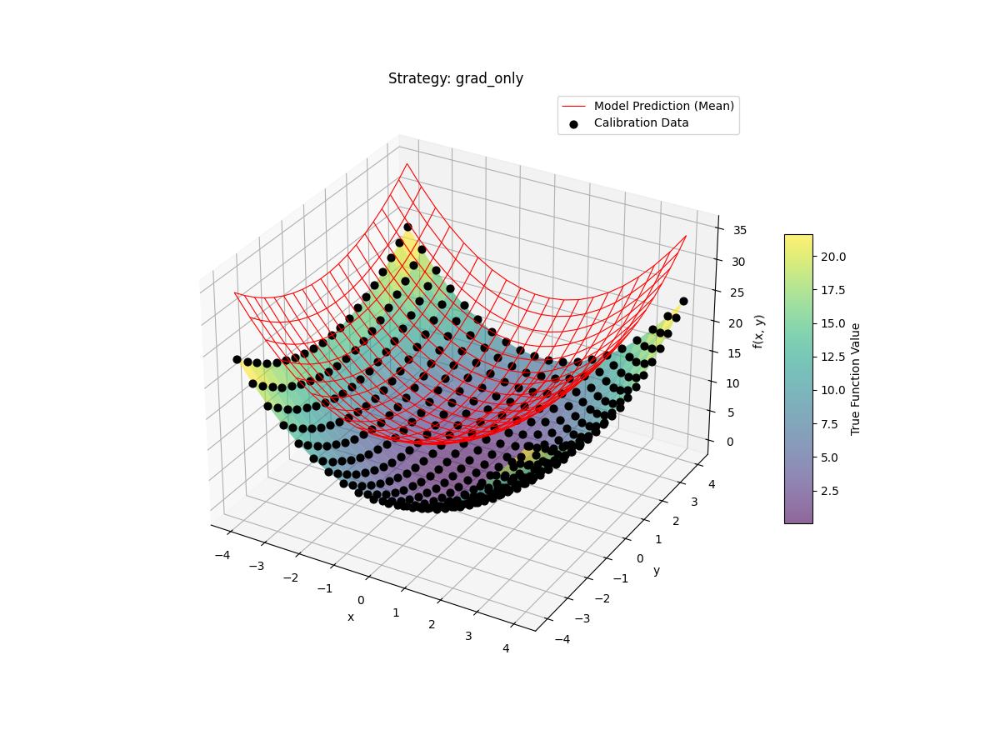

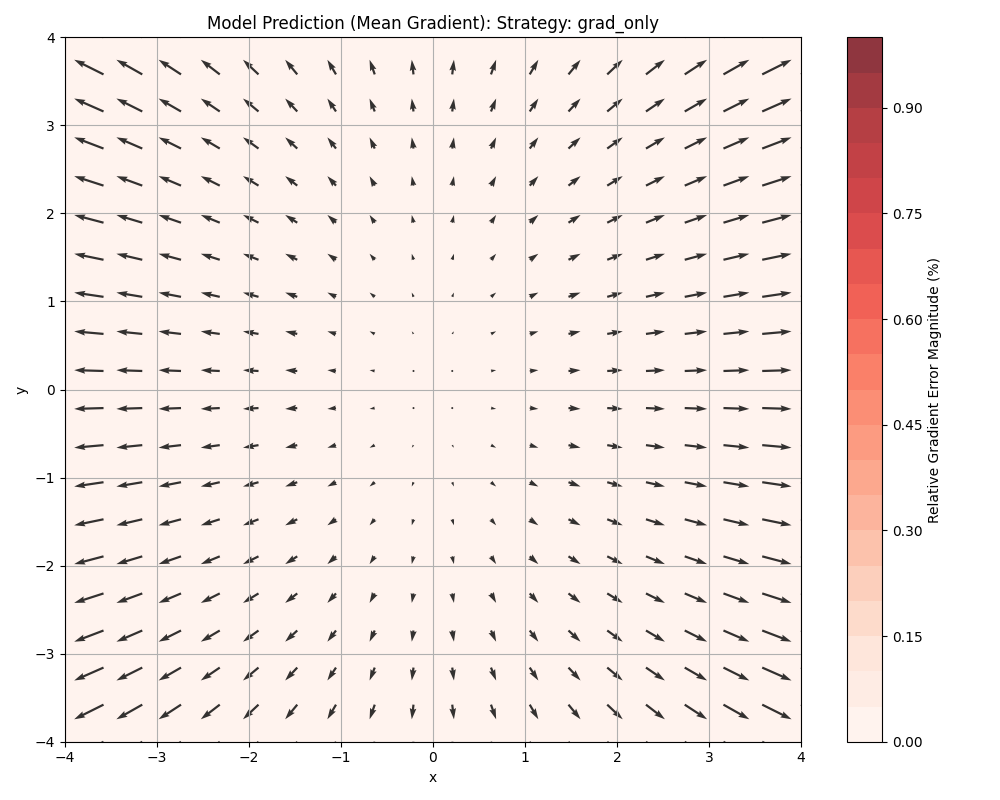

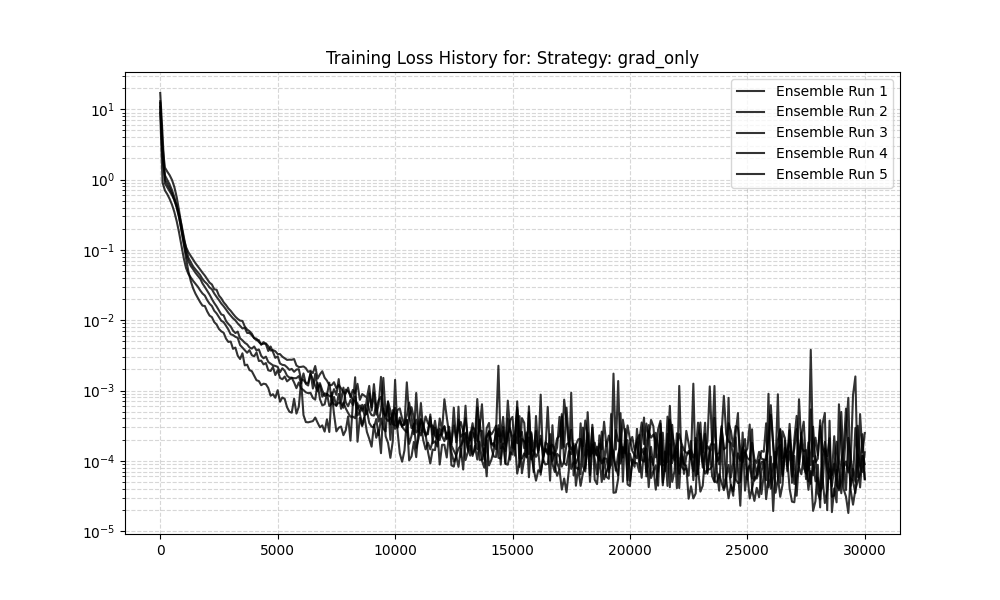

--- Task 2.3 Sweep Complete ---


In [ ]:
# --- Fixed Hyperparameters ---
FIXED_NUM_LAYERS = 3
FIXED_NUM_NODES = 16
NUM_STEPS = 30000
LEARNING_RATE = 1e-3
ENSEMBLE_SIZE = 5
BATCH_SIZE = 32
MODEL_ACTIVATION = jax.nn.softplus
MODEL_IS_ICNN = True

# --- 1. Load the combined Sobolev data ---
(x_data_full, y_data_full, 
 xx, yy, z_true_grid, 
 x_cal, y_cal_combined,
 grad_x_true_grid, grad_y_true_grid) = td.f2_and_grad()

# --- 2. Define the training strategies ---
strategies = {
    "f2_only": tl.SobolevLoss(alpha=1.0, beta=0.0),
    "f2_and_grad": tl.SobolevLoss(alpha=1.0, beta=1.0),
    "grad_only": tl.SobolevLoss(alpha=0.0, beta=1.0),
}

results_task_2_3 = {}

# --- Main Loop ---
for strategy_name, loss_fn in strategies.items():
    print(f"==============================================")
    print(f"Testing Strategy: {strategy_name}")
    print(f"==============================================")
    
    final_losses = []
    trained_ensemble = []
    ensemble_histories = []

    for i in range(ENSEMBLE_SIZE):
        master_key, model_key, train_key = jrandom.split(master_key, 3)

        sobolev_model = tm.SobolevModel(
            key=model_key,
            input_dim=2,
            output_dim="scalar", # <-- This is correct
            num_hidden_layers=FIXED_NUM_LAYERS,
            nodes_per_layer=FIXED_NUM_NODES,
            activation=MODEL_ACTIVATION,
            is_icnn=MODEL_IS_ICNN
        )
        
        trained_model, history = tm.train_model(
            sobolev_model, (x_cal, y_cal_combined), train_key,
            steps=NUM_STEPS, batch_size=BATCH_SIZE,
            learning_rate=LEARNING_RATE, loss_fn=loss_fn
        )
        
        final_losses.append(history.loss[-1])
        trained_ensemble.append(trained_model)
        ensemble_histories.append(history)

    mean_loss = jnp.mean(jnp.array(final_losses))
    std_loss = jnp.std(jnp.array(final_losses))
    results_task_2_3[strategy_name] = (mean_loss, std_loss, trained_ensemble)

    # --- 3. EVALUATION STEP  ---
    print(f"--- Evaluating: {strategy_name} ---")
    plot_title = f"Strategy: {strategy_name}"
    
    # --- 3a. Print Quantitative Stats FIRST ---
    td.calculate_and_print_errors(
        trained_ensemble,
        x_data_full,
        y_data_full,
        grad_x_true_grid,
        grad_y_true_grid,
        strategy_name
    )
    
    # Unpack the true calibration data for plotting
    y_cal_true_values, _ = y_cal_combined
    
    # 3b. Plot f2 (value) predictions
    td.plot_3d_sobolev_overlay(
        xx, yy, z_true_grid,
        trained_ensemble, x_data_full,
        x_cal, y_cal_true_values,
        title=plot_title
    )
    
    # 3c. Plot grad_f2 (gradient) predictions
    td.plot_2d_sobolev_grad_comparison(
        xx, yy, grad_x_true_grid, grad_y_true_grid,
        trained_ensemble, x_data_full,
        title=plot_title
    )
    
    # 3d. Plot training histories
    td.plot_ensemble_histories(ensemble_histories, title=plot_title)

print("--- Task 2.3 Sweep Complete ---")

#### Task 2.3 - Observations:

The results from the three training strategies clearly demonstrate the impact of Sobolev training on the model's predictions:

**Strategy 1:** f2_only (alpha=1.0, beta=0.0)This model "overfits" to the function values. It achieves a near-perfect prediction of the $f_2$ surface (Median Value Error: ~0.015). However, it struggles to predict the gradient, showing high errors (Median Gradient Error: ~0.42) that are evenly distributed across the domain.

**Strategy 2:** grad_only (alpha=0.0, beta=1.0)This model illustrates the problem of learning the derivative but not the constant of integration. It produces a good gradient field with very low error (Median Gradient Error: ~0.005). However, the function value $f_2$ has a massive, consistent offset (a high bias), with a Median Value Error of ~10.4 that is almost identical to its Max Error of ~10.4. The plot clearly shows the model learned the correct shape but is shifted down by ~10 units.

**Strategy 3:** f2_and_grad (alpha=1.0, beta=1.0)This mixed strategy is the most robust and provides the best overall model. It maintains the low-error fit for the function value (Median Value Error: ~0.016). Most importantly, by adding the gradient data, it improves the gradient prediction, cutting the median error from ~0.42 to ~0.013 and localizing significant errors to only the extreme corners of the domain. This demonstrates that the mixed strategy prevents overfitting to either the function data or the gradient data and produces a model that is accurate for both.

### Task 2.4 Hyperelasticity



For this task we are trying to model the energy potential of a solid body with a neural network to derive the stress strain relationship from that model. Since such an energy potential is not measurable in reality, we can only train the neural network by using gradient data (the gradient of the potential is the strain). To compare and understand the suitability of different model classes we will compare a standard FFNN and an ICNN and evaluate both against each other.

--- Starting Task 2.4: Hyperelasticity ---
Testing Model: Standard FFNN (ReLU)


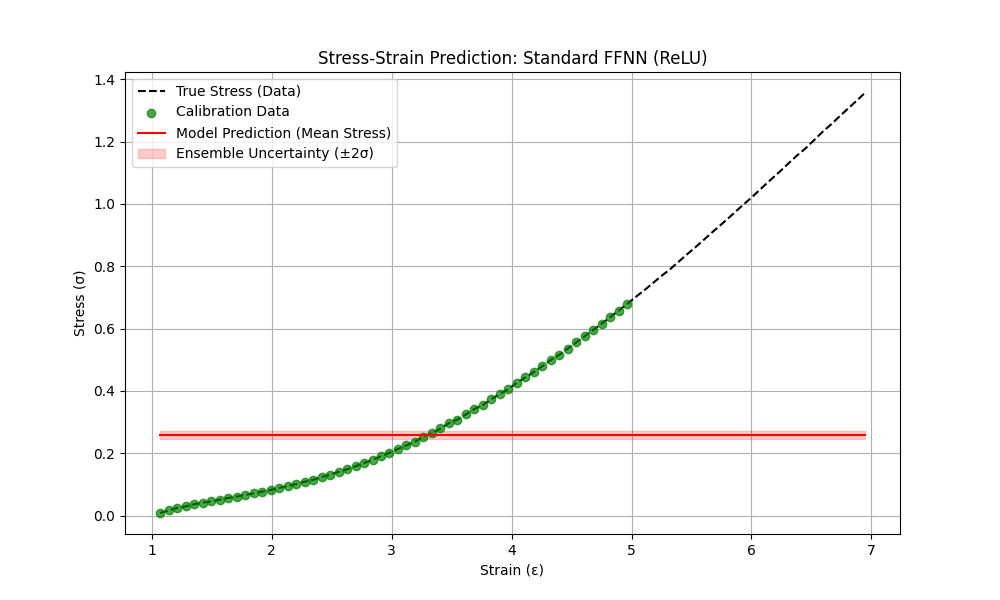

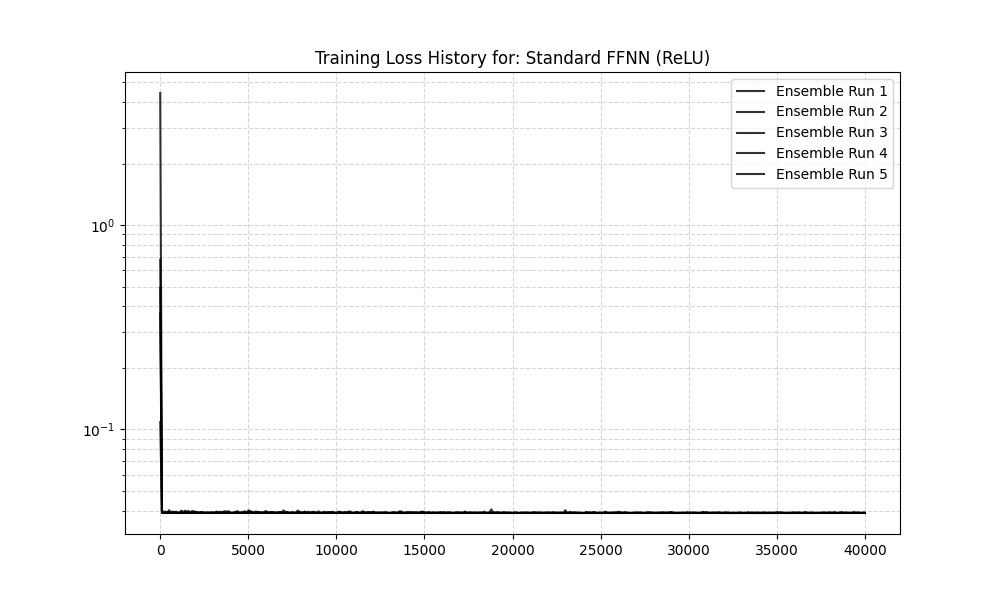

  Avg Final Loss: 0.039084
  Std Dev of Loss: 0.000027

Testing Model: Standard FFNN (Sigmoid)


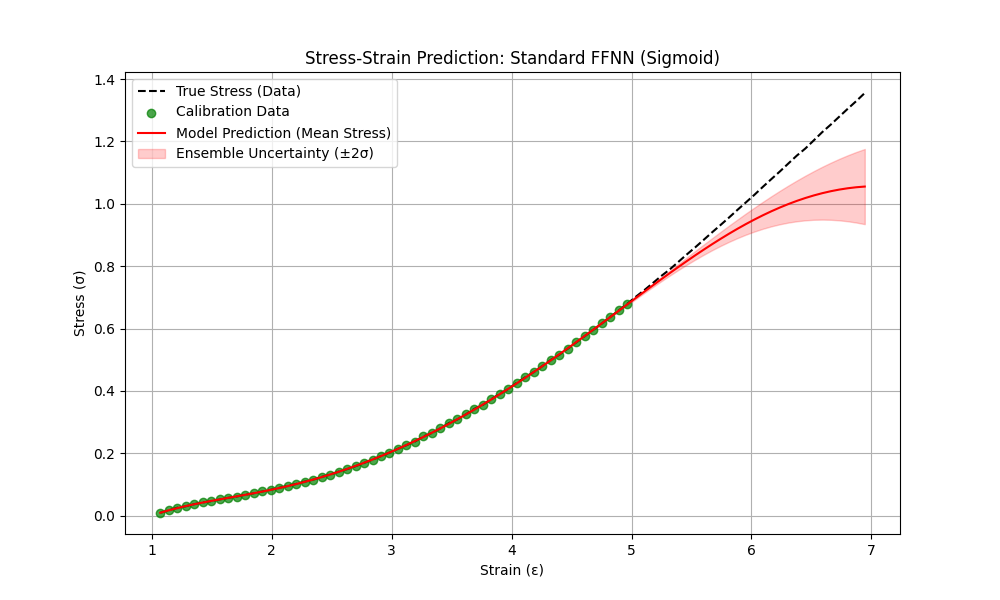

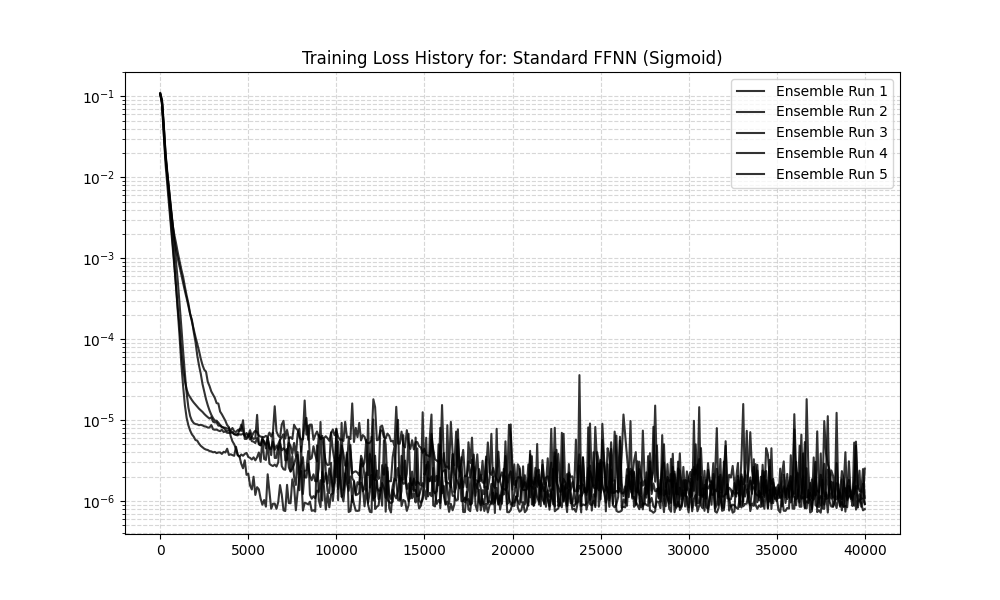

  Avg Final Loss: 0.000001
  Std Dev of Loss: 0.000001

Testing Model: ICNN (Softplus)


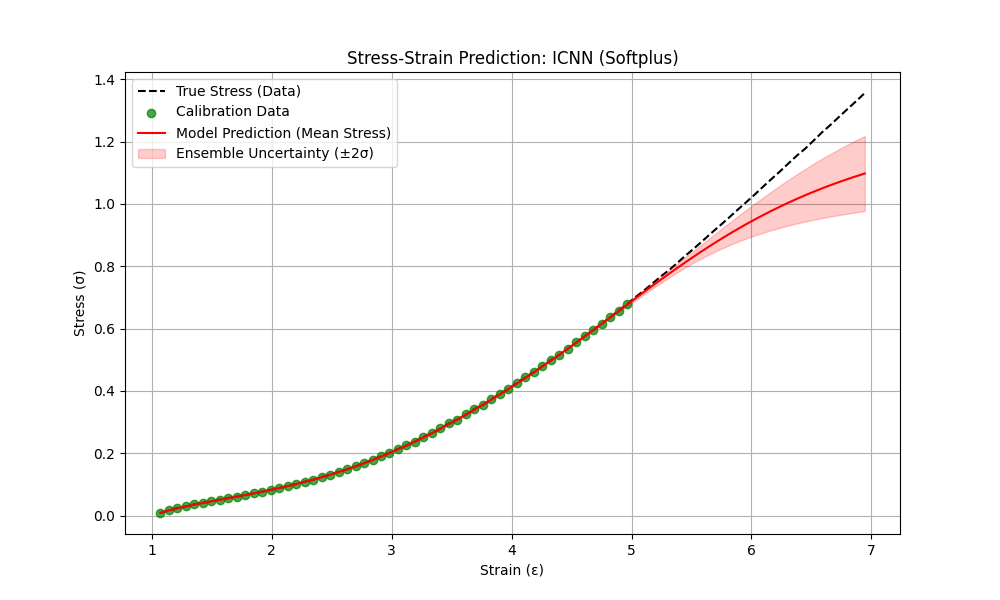

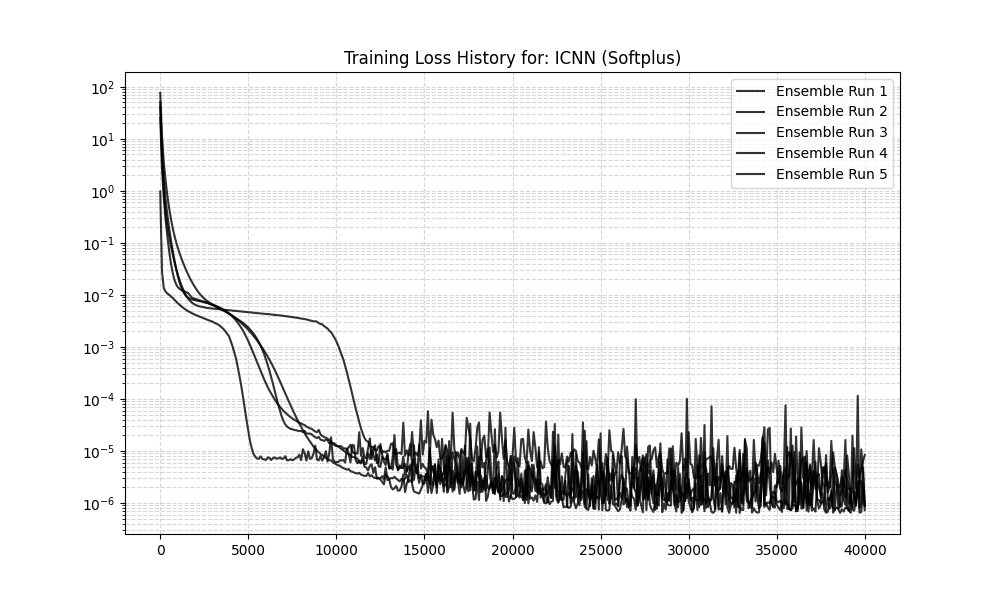

  Avg Final Loss: 0.000002
  Std Dev of Loss: 0.000003

--- Task 2.4 Sweep Complete ---


In [ ]:
# --- Fixed Hyperparameters ---
FIXED_NUM_LAYERS = 3
FIXED_NUM_NODES = 16
NUM_STEPS = 40000
LEARNING_RATE = 1e-3
ENSEMBLE_SIZE = 5
BATCH_SIZE = 16 # Use a smaller batch size for this smaller dataset

# --- 1. Load the 1D Stress-Strain data ---
(eps_full, sigma_full, 
 eps_cal, sigma_cal, 
 eps_test, sigma_test) = td.stress_strain_1d()

# --- 2. Define the training strategy ---
# We are training only on the gradient (stress).
# We must create a "dummy" target for the potential (W),
# which is `jnp.zeros_like(sigma_cal)`.
y_cal_combined = (jnp.zeros_like(sigma_cal), sigma_cal)

# This loss function trains only on the gradient.
sobolev_loss_fn = tl.SobolevLoss(alpha=0.0, beta=1.0)

# --- 3. Define the models to investigate ---
model_configs = [
    {
        "name": "Standard FFNN (ReLU)",
        "activation": jax.nn.relu,
        "is_icnn": False
    },
    {
        "name": "Standard FFNN (Sigmoid)",
        "activation": jax.nn.sigmoid,
        "is_icnn": False
    },
    {
        "name": "ICNN (Softplus)",
        "activation": jax.nn.softplus,
        "is_icnn": True
    }
]

results_task_2_4 = {}

# --- Main Loop ---
for config in model_configs:
    config_name = config['name']
    print(f"==============================================")
    print(f"Testing Model: {config_name}")
    print(f"==============================================")
    
    final_losses = []
    trained_ensemble = []
    ensemble_histories = []

    for i in range(ENSEMBLE_SIZE):
        master_key, model_key, train_key = jrandom.split(master_key, 3)

        # 1. Build the SobolevModel (1D input, 1D scalar output)
        sobolev_model = tm.SobolevModel(
            key=model_key,
            input_dim=1,
            output_dim="scalar", # Use "scalar" for jax.grad
            num_hidden_layers=FIXED_NUM_LAYERS,
            nodes_per_layer=FIXED_NUM_NODES,
            activation=config['activation'],
            is_icnn=config['is_icnn']
        )
        
        # 2. Train using the gradient-only loss function
        trained_model, history = tm.train_model(
            sobolev_model,
            (eps_cal, y_cal_combined), # Pass the combined data
            train_key,
            steps=NUM_STEPS,
            batch_size=BATCH_SIZE,
            learning_rate=LEARNING_RATE,
            loss_fn=sobolev_loss_fn # Pass the gradient-only loss
        )
        
        final_losses.append(history.loss[-1])
        trained_ensemble.append(trained_model)
        ensemble_histories.append(history)

    mean_loss = jnp.mean(jnp.array(final_losses))
    std_loss = jnp.std(jnp.array(final_losses))
    results_task_2_4[config_name] = (mean_loss, std_loss, trained_ensemble)

    # --- 3. EVALUATION STEP ---
    plot_title = f"{config_name}"
    
    # 3a. Plot the 1D stress-strain (gradient) predictions
    td.plot_1d_stress_strain(
        eps_full, sigma_full,
        eps_cal, sigma_cal,
        trained_ensemble,
        title=plot_title
    )
    
    # 3b. Plot training histories
    td.plot_ensemble_histories(ensemble_histories, title=plot_title)

### Task 2.4 – Observations

The FFNN using ReLU as an activation does not seem to learn at all, even when using a higher number of steps. This can be explained by looking at exactly what we are modeling and how the optimizer works: the NN is modeling the energy potential $W$. But we only have data for its gradient (1st derivative), which is the stress $\sigma$. Since the NN uses a gradient-based optimizer, it needs to calculate the gradient of the loss function. This means that the update step for the model parameters is proportional to the **second derivative** of our NN (e.g. $\frac{\partial^2 W^{NN}}{\partial p\,\partial \varepsilon}$). Because we are using ReLU, which is a piecewise-linear function, its second derivative is 0 (almost) everywhere. This means that in this particular architecture, our model does not receive any parameter updates and is stuck with its initialization parameters, which explains the prediction of a flat line.

For this reason, we employ the Sigmoid activation in a second attempt to use a FFNN. Here we can observe that the network is interpolating the data almost perfectly, and extrapolation looks good for strain $\varepsilon$ between $5 - 5.5$. But then, the model seems to underestimate the resulting stress from higher strains, showing an increasingly high error as the strain increases. If we observe the end of our domain at $\varepsilon \approx 7$, we can see the uncertainty band even exhibiting a decreasing curve. If we know the energy potential $W$ of the process to be convex, a decreasing stress–strain curve ($\sigma$) is not physically possible, as it implies

$$
\frac{\partial \sigma}{\partial \varepsilon} = \frac{\partial^2 W}{\partial \varepsilon^2} < 0
$$

This is a key insight which brings us to the ICNN.

The ICNN looks very similar to the FFNN with Sigmoid. While it stays closer to the true data for longer, we also see it underestimating the stress for higher strain levels. However, crucially, **none of the ensemble members ever predict a decreasing stress–strain curve**. This is a direct consequence of enforcing convexity in the energy potential $W$ we are modeling. This means that by construction, the model respects the physical nature of the process. Even though it also doesn't show perfect extrapolation, it never predicts unphysical curves, which also helps it stay closer to the true data.
